# 7. ADI+IFS: PSF subtraction and forward modeling

> Author: *Valentin Christiaens*  
> Suitable for VIP *v1.2.2* onwards (**Warning** this is a different version requirement than other tutorials)  
> Last update: *2022/04/13*

**Table of contents**

* [7.1. Loading and visualizing the data](#7.1.-Loading-and-visualizing-the-data)

* [7.2. Planet parameters and spectra](#7.2.-Planet-parameters-and-spectra)

* [7.3. Flux normalization](#7.3.-Flux-normalization)
    - [7.3.1. Non-coronagraphic PSF normalization](#7.3.1.-Non-coronagraphic-PSF-normalization)
    - [7.3.2. Stellar SED model](#7.3.2.-Stellar-SED-model)
    - [7.3.3. Airmass](#7.3.3.-Airmass)
    - [7.3.4. Final fluxes](#7.3.4.-Final-fluxes)     

* [7.4. Injection](#7.4.-Injection)

* [7.5. Post-processing of IFS data](#7.5.-Post-processing-of-IFS-data)
    - [7.5.1. Optimal scaling factors](#7.5.1.-Optimal-scaling-factors)
    - [7.5.2. median-SDI](#7.5.2.-median-SDI)
    - [7.5.3. PCA-SDI](#7.5.3.-PCA-SDI)
    - [7.5.4. median-ASDI](#7.5.4.-median-ASDI)
    - [7.5.5. PCA-ASDI](#7.5.5.-PCA-ASDI)
    - [7.5.6. PCA-ADI for all spectral channels](#7.5.6.-PCA-ADI-for-all-spectral-channels)

* [7.6. Astrometry retrieval](#7.6.-Astrometry-retrieval)
    - [7.6.1. Spectral channels with maximum SNR](#7.6.1.-Spectral-channels-with-maximum-SNR)
    - [7.6.2. NEGFC+PCA-ADI (simplex)](#7.6.2.-NEGFC+PCA-ADI-(simplex))
    - [7.6.3. NEGFC+PCA-ADI (MCMC)](#7.6.3.-NEGFC+PCA-ADI-(MCMC))

* [7.7. Spectrum retrieval](#7.7.-Spectrum-retrieval)
    - [7.7.1. NEGFC+PCA-ADI (simplex)](#7.7.1.-NEGFC+PCA-ADI-(simplex))
    - [7.7.2. NEGFC+PCA-ADI (MCMC)](#7.7.2.-NEGFC+PCA-ADI-(MCMC))

The purpose of this tutorial is to show:
- how to inject a planet spectrum in a 4D (IFS+ADI) datacube;
- how to post-process 4D (IFS+ADI) datacubes; 
- how to retrieve the parameters of a planet present in a 4D (IFS+ADI) datacube (astro- and spectrometry).

Note that the model spectra (for the star and planet) used in this notebook are provided after resampling for the purpose of highlighting the capabilities of VIP only (i.e. to avoid having to install additional requirements to be able to run this tutorial). If you are interested in a more complete planet spectrum injection procedure, check out [this Exoplanet Data Challenge Phase 2 tutorial](https://github.com/exoplanet-imaging-challenge/phase2/tree/main/tutorials), which also requires the following external packages: [``special``](https://github.com/VChristiaens/special) (for model resampling) and [``eidc2``](https://github.com/exoplanet-imaging-challenge/phase2) (for better flux normalization before spectrum injection).

-----------

Let's first load all packages needed in this tutorial:

In [1]:
import astropy.constants as c
import glob
from hciplot import plot_frames, plot_cubes
from matplotlib import pyplot as plt
import numpy as np
import pandas as pd

#from special.model_resampling import resample_model
#from special.utils_spec import find_nearest

from vip_hci.config import VLT_SPHERE_IFS
from vip_hci.fits import open_fits, write_fits
from vip_hci.fm import (cube_inject_companions, firstguess, mcmc_negfc_sampling, normalize_psf, 
                        show_walk_plot, show_corner_plot, confidence)
from vip_hci.metrics import snr, significance
from vip_hci.psfsub import median_sub, pca, pca_annular, pca_annulus, pca_grid
from vip_hci.preproc import find_scal_vector, frame_rescaling
from vip_hci.var import frame_center, dist, mask_circle

## 7.1. Loading and visualizing the data

In the 'datasets' folder of the `VIP_extras` repository you can find a toy SPHERE/IFS coronagraphic cube acquired in pupil-stabilized mode on the source HIP39826 (a star with no reported directly imaged companion). The folder also contains the associated non-coronagraphic point spread function (PSF), wavelength vector, parallactic angles, and airmass of the source.

Let's now load the data. Note that more info on opening and visualizing fits files with VIP in general is available [in the first VIP tutorial](https://vip.readthedocs.io/en/latest/tutorials/01_quickstart.html).

In [2]:
path = '../datasets/'

cubename = path+'sphere_ifs_HIP39826_cube.fits'
psfname = path+'sphere_ifs_HIP39826_psf.fits'
lbdaname = path+'sphere_ifs_HIP39826_wl.fits'
angname = path+'sphere_ifs_HIP39826_pa.fits'
Xname = path+'sphere_ifs_HIP39826_airmass.fits'

cube = open_fits(cubename)
psf = open_fits(psfname)
lbda = open_fits(lbdaname)
derot_angles = -1*open_fits(angname) # note: SPHERE DRH returns parallactic angles, while VIP routines take derotation angles as input
X_sci = open_fits(Xname) 

nch, nz, ny, nx = cube.shape

FITS HDU-0 data successfully loaded. Data shape: (39, 55, 107, 107)
FITS HDU-0 data successfully loaded. Data shape: (39, 29, 29)
FITS HDU-0 data successfully loaded. Data shape: (39,)
FITS HDU-0 data successfully loaded. Data shape: (55,)
FITS HDU-0 data successfully loaded. Data shape: (55,)


Each IFS spectral cube consists of 39 monochromatic images spread in wavelengths between the Y and J bands ('YJ' mode) or Y and H bands ('YJH' mode). Here the IFS+ADI cube contains 55 such spectral cubes combined into a single master cube.

The **master spectral cube** is already centered, trimmed from bad frames, and mostly corrected from bad pixels (check Tutorial 2 for example uses). 

Let's inspect the first wavelength using `hciplot.plot_cubes` (feel free to set the backend to 'bokeh' to read pixel values interactively):

<img src='data:image/png;base64,iVBORw0KGgoAAAANSUhEUgAAAEAAAABACAYAAACqaXHeAAAABHNCSVQICAgIfAhkiAAAAAlwSFlz
AAAB+wAAAfsBxc2miwAAABl0RVh0U29mdHdhcmUAd3d3Lmlua3NjYXBlLm9yZ5vuPBoAAA6zSURB
VHic7ZtpeFRVmsf/5966taWqUlUJ2UioBBJiIBAwCZtog9IOgjqACsogKtqirT2ttt069nQ/zDzt
tI4+CrJIREFaFgWhBXpUNhHZQoKBkIUASchWla1S+3ar7r1nPkDaCAnZKoQP/D7mnPOe9/xy76n3
nFSAW9ziFoPFNED2LLK5wcyBDObkb8ZkxuaoSYlI6ZcOKq1eWFdedqNzGHQBk9RMEwFAASkk0Xw3
ETacDNi2vtvc7L0ROdw0AjoSotQVkKSvHQz/wRO1lScGModBFbDMaNRN1A4tUBCS3lk7BWhQkgpD
lG4852/+7DWr1R3uHAZVQDsbh6ZPN7CyxUrCzJMRouusj0ipRwD2uKm0Zn5d2dFwzX1TCGhnmdGo
G62Nna+isiUqhkzuKrkQaJlPEv5mFl2fvGg2t/VnzkEV8F5ioioOEWkLG86fvbpthynjdhXYZziQ
x1hC9J2NFyi8vCTt91Fh04KGip0AaG9zuCk2wQCVyoNU3Hjezee9bq92duzzTmxsRJoy+jEZZZYo
GTKJ6SJngdJqAfRzpze0+jHreUtPc7gpBLQnIYK6BYp/uGhw9YK688eu7v95ysgshcg9qSLMo3JC
4jqLKQFBgdKDPoQ+Pltb8dUyQLpeDjeVgI6EgLIQFT5tEl3rn2losHVsexbZ3EyT9wE1uGdkIPcy
BGxn8QUq1QrA5nqW5i2tLqvrrM9NK6AdkVIvL9E9bZL/oyfMVd/jqvc8LylzRBKDJSzIExwhQzuL
QYGQj4rHfFTc8mUdu3E7yoLtbTe9gI4EqVgVkug2i5+uXGo919ixbRog+3fTbQ8qJe4ZOYNfMoTI
OoshUNosgO60AisX15aeI2PSIp5KiFLI9ubb1vV3Qb2ltwLakUCDAkWX7/nHKRmmGIl9VgYsUhJm
2NXjKYADtM1ygne9QQDIXlk49FBstMKx66D1v4+XuQr7vqTe0VcBHQlRWiOCbmmSYe2SqtL6q5rJ
zsTb7lKx3FKOYC4DoqyS/B5bvLPxvD9Qtf6saxYLQGJErmDOdOMr/zo96km1nElr8bmPOBwI9COv
HnFPRIwmkSOv9kcAS4heRsidOkpeWBgZM+UBrTFAXNYL5Vf2ii9c1trNzpYdaoVil3WIc+wdk+gQ
noie3ecCcxt9ITcLAPWt/laGEO/9U6PmzZkenTtsSMQ8uYywJVW+grCstAvCIaAdArAsIWkRDDs/
KzLm2YcjY1Lv0UdW73HabE9n6V66cxSzfEmuJssTpKGVp+0vHq73FwL46eOjpMpbRAnNmJFrGJNu
Ukf9Yrz+3rghiumCKNXXWPhLYcjxGsIpoCMsIRoFITkW8AuyM8jC1+/QLx4bozCEJIq38+1rtpR6
V/yzb8eBlRb3fo5l783N0CWolAzJHaVNzkrTzlEp2bQ2q3TC5gn6wpnoQAmwSiGh2GitnTmVMc5O
UyfKWUKCIsU7+fZDKwqdT6DDpvkzAX4/+AMFjk0tDp5GRXLpQ2MUmhgDp5gxQT8+Y7hyPsMi8uxF
71H0oebujHALECjFKaW9Lm68n18wXp2kVzIcABytD5iXFzg+WVXkegpAsOOYziqo0OkK76GyquC3
ltZAzMhhqlSNmmWTE5T6e3IN05ITFLM4GdN0vtZ3ob8Jh1NAKXFbm5PtLU/eqTSlGjkNAJjdgn/N
aedXa0tdi7+t9G0FIF49rtMSEgAs1kDLkTPO7ebm4IUWeyh1bKomXqlgMG6kJmHcSM0clYLJ8XtR
1GTnbV3F6I5wCGikAb402npp1h1s7LQUZZSMIfALFOuL3UUrfnS8+rez7v9qcold5tilgHbO1fjK
9ubb17u9oshxzMiUBKXWqJNxd+fqb0tLVs4lILFnK71H0Ind7uiPgACVcFJlrb0tV6DzxqqTIhUM
CwDf1/rrVhTa33/3pGPxJYdQ2l2cbgVcQSosdx8uqnDtbGjh9SlDVSMNWhlnilfqZk42Th2ZpLpf
xrHec5e815zrr0dfBZSwzkZfqsv+1FS1KUknUwPARVvItfKUY+cn57yP7qv07UE3p8B2uhUwLk09
e0SCOrK+hbdYHYLjRIl71wWzv9jpEoeOHhGRrJAzyEyNiJuUqX0g2sBN5kGK6y2Blp5M3lsB9Qh4
y2Ja6x6+i0ucmKgwMATwhSjdUu49tKrQ/pvN5d53ml2CGwCmJipmKjgmyuaXzNeL2a0AkQ01Th5j
2DktO3Jyk8f9vcOBQHV94OK+fPumJmvQHxJoWkaKWq9Vs+yUsbq0zGT1I4RgeH2b5wef7+c7bl8F
eKgoHVVZa8ZPEORzR6sT1BzDUAD/d9F78e2Tzv99v8D+fLVTqAKAsbGamKey1Mt9Ann4eH3gTXTz
idWtAJ8PQWOk7NzSeQn/OTHDuEikVF1R4z8BQCy+6D1aWRfY0tTGG2OM8rRoPaeIj5ZHzJxszElN
VM8K8JS5WOfv8mzRnQAKoEhmt8gyPM4lU9SmBK1MCQBnW4KONT86v1hZ1PbwSXPw4JWussVjtH9Y
NCoiL9UoH/6PSu8jFrfY2t36erQHXLIEakMi1SydmzB31h3GGXFDFNPaK8Rme9B79Ixrd0WN+1ij
NRQ/doRmuFLBkHSTOm5GruG+pFjFdAmorG4IXH1Qua6ASniclfFtDYt+oUjKipPrCQB7QBQ2lrgP
fFzm+9XWUtcqJ3/5vDLDpJ79XHZk3u8nGZ42qlj1+ydtbxysCezrydp6ugmipNJ7WBPB5tydY0jP
HaVNzs3QzeE4ZpTbI+ZbnSFPbVOw9vsfnVvqWnirPyCNGD08IlqtYkh2hjZ5dErEQzoNm+6ykyOt
Lt5/PQEuSRRKo22VkydK+vvS1XEKlhCJAnsqvcVvH7f/ZU2R67eXbMEGAMiIV5oWZWiWvz5Fv2xG
sjqNJQRvn3Rs2lji/lNP19VjAQDgD7FHhujZB9OGqYxRkZxixgRDVlqS6uEOFaJUVu0rPFzctrnF
JqijImVp8dEKVWyUXDk92zAuMZ6bFwpBU1HrOw6AdhQgUooChb0+ItMbWJitSo5Ws3IAOGEOtL53
0vHZih9sC4vtofZ7Qu6523V/fmGcds1TY3V36pUsBwAbSlxnVh2xLfAD/IAIMDf7XYIkNmXfpp2l
18rkAJAy9HKFaIr/qULkeQQKy9zf1JgDB2uaeFNGijo5QsUyacNUUTOnGO42xSnv4oOwpDi1zYkc
efUc3I5Gk6PhyTuVKaOGyLUAYPGIoY9Pu/atL/L92+4q9wbflRJ2Trpm/jPjdBtfnqB/dIThcl8A
KG7hbRuKnb8qsQsVvVlTrwQAQMUlf3kwJI24Z4JhPMtcfng5GcH49GsrxJpGvvHIaeem2ma+KSjQ
lIwUdYyCY8j4dE1KzijNnIP2llF2wcXNnsoapw9XxsgYAl6k+KzUXbi2yP3KR2ecf6z3BFsBICdW
nvnIaG3eHybqX7vbpEqUMT+9OL4Qpe8VON7dXuFd39v19FoAABRVePbGGuXTszO0P7tu6lghUonE
llRdrhArLvmKdh9u29jcFiRRkfLUxBiFNiqSU9icoZQHo5mYBI1MBgBH6wMNb+U7Pnw337H4gi1Y
ciWs+uks3Z9fztUvfzxTm9Ne8XXkvQLHNytOOZeiD4e0PgkAIAYCYknKUNUDSXEKzdWNpnil7r4p
xqkjTarZMtk/K8TQ6Qve78qqvXurGwIJqcOUKfUWHsm8KGvxSP68YudXq4pcj39X49uOK2X142O0
Tz5/u/7TVybqH0rSya6ZBwD21/gubbrgWdDgEOx9W

:Dataset   [x,y,time,lambda]   (flux)
:Cube_shape	[107, 107, 55, 39]


:DynamicMap   [time,lambda]
   :Image   [x,y]   (flux)
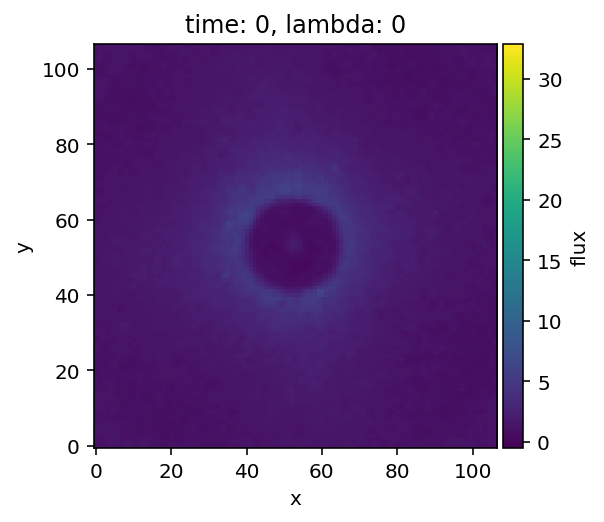

In [3]:
plot_cubes(cube)#, backend='bokeh')

We notice that the flux varies and the PSF size increases, both as a function of wavelength.

Now let's inspect the **PSF cube** (one frame per wavelength), which will be used for the actual injection of a fake planet:

<img src='data:image/png;base64,iVBORw0KGgoAAAANSUhEUgAAAEAAAABACAYAAACqaXHeAAAABHNCSVQICAgIfAhkiAAAAAlwSFlz
AAAB+wAAAfsBxc2miwAAABl0RVh0U29mdHdhcmUAd3d3Lmlua3NjYXBlLm9yZ5vuPBoAAA6zSURB
VHic7ZtpeFRVmsf/5966taWqUlUJ2UioBBJiIBAwCZtog9IOgjqACsogKtqirT2ttt069nQ/zDzt
tI4+CrJIREFaFgWhBXpUNhHZQoKBkIUASchWla1S+3ar7r1nPkDaCAnZKoQP/D7mnPOe9/xy76n3
nFSAW9ziFoPFNED2LLK5wcyBDObkb8ZkxuaoSYlI6ZcOKq1eWFdedqNzGHQBk9RMEwFAASkk0Xw3
ETacDNi2vtvc7L0ROdw0AjoSotQVkKSvHQz/wRO1lScGModBFbDMaNRN1A4tUBCS3lk7BWhQkgpD
lG4852/+7DWr1R3uHAZVQDsbh6ZPN7CyxUrCzJMRouusj0ipRwD2uKm0Zn5d2dFwzX1TCGhnmdGo
G62Nna+isiUqhkzuKrkQaJlPEv5mFl2fvGg2t/VnzkEV8F5ioioOEWkLG86fvbpthynjdhXYZziQ
x1hC9J2NFyi8vCTt91Fh04KGip0AaG9zuCk2wQCVyoNU3Hjezee9bq92duzzTmxsRJoy+jEZZZYo
GTKJ6SJngdJqAfRzpze0+jHreUtPc7gpBLQnIYK6BYp/uGhw9YK688eu7v95ysgshcg9qSLMo3JC
4jqLKQFBgdKDPoQ+Pltb8dUyQLpeDjeVgI6EgLIQFT5tEl3rn2losHVsexbZ3EyT9wE1uGdkIPcy
BGxn8QUq1QrA5nqW5i2tLqvrrM9NK6AdkVIvL9E9bZL/oyfMVd/jqvc8LylzRBKDJSzIExwhQzuL
QYGQj4rHfFTc8mUdu3E7yoLtbTe9gI4EqVgVkug2i5+uXGo919ixbRog+3fTbQ8qJe4ZOYNfMoTI
OoshUNosgO60AisX15aeI2PSIp5KiFLI9ubb1vV3Qb2ltwLakUCDAkWX7/nHKRmmGIl9VgYsUhJm
2NXjKYADtM1ygne9QQDIXlk49FBstMKx66D1v4+XuQr7vqTe0VcBHQlRWiOCbmmSYe2SqtL6q5rJ
zsTb7lKx3FKOYC4DoqyS/B5bvLPxvD9Qtf6saxYLQGJErmDOdOMr/zo96km1nElr8bmPOBwI9COv
HnFPRIwmkSOv9kcAS4heRsidOkpeWBgZM+UBrTFAXNYL5Vf2ii9c1trNzpYdaoVil3WIc+wdk+gQ
noie3ecCcxt9ITcLAPWt/laGEO/9U6PmzZkenTtsSMQ8uYywJVW+grCstAvCIaAdArAsIWkRDDs/
KzLm2YcjY1Lv0UdW73HabE9n6V66cxSzfEmuJssTpKGVp+0vHq73FwL46eOjpMpbRAnNmJFrGJNu
Ukf9Yrz+3rghiumCKNXXWPhLYcjxGsIpoCMsIRoFITkW8AuyM8jC1+/QLx4bozCEJIq38+1rtpR6
V/yzb8eBlRb3fo5l783N0CWolAzJHaVNzkrTzlEp2bQ2q3TC5gn6wpnoQAmwSiGh2GitnTmVMc5O
UyfKWUKCIsU7+fZDKwqdT6DDpvkzAX4/+AMFjk0tDp5GRXLpQ2MUmhgDp5gxQT8+Y7hyPsMi8uxF
71H0oebujHALECjFKaW9Lm68n18wXp2kVzIcABytD5iXFzg+WVXkegpAsOOYziqo0OkK76GyquC3
ltZAzMhhqlSNmmWTE5T6e3IN05ITFLM4GdN0vtZ3ob8Jh1NAKXFbm5PtLU/eqTSlGjkNAJjdgn/N
aedXa0tdi7+t9G0FIF49rtMSEgAs1kDLkTPO7ebm4IUWeyh1bKomXqlgMG6kJmHcSM0clYLJ8XtR
1GTnbV3F6I5wCGikAb402npp1h1s7LQUZZSMIfALFOuL3UUrfnS8+rez7v9qcold5tilgHbO1fjK
9ubb17u9oshxzMiUBKXWqJNxd+fqb0tLVs4lILFnK71H0Ind7uiPgACVcFJlrb0tV6DzxqqTIhUM
CwDf1/rrVhTa33/3pGPxJYdQ2l2cbgVcQSosdx8uqnDtbGjh9SlDVSMNWhlnilfqZk42Th2ZpLpf
xrHec5e815zrr0dfBZSwzkZfqsv+1FS1KUknUwPARVvItfKUY+cn57yP7qv07UE3p8B2uhUwLk09
e0SCOrK+hbdYHYLjRIl71wWzv9jpEoeOHhGRrJAzyEyNiJuUqX0g2sBN5kGK6y2Blp5M3lsB9Qh4
y2Ja6x6+i0ucmKgwMATwhSjdUu49tKrQ/pvN5d53ml2CGwCmJipmKjgmyuaXzNeL2a0AkQ01Th5j
2DktO3Jyk8f9vcOBQHV94OK+fPumJmvQHxJoWkaKWq9Vs+yUsbq0zGT1I4RgeH2b5wef7+c7bl8F
eKgoHVVZa8ZPEORzR6sT1BzDUAD/d9F78e2Tzv99v8D+fLVTqAKAsbGamKey1Mt9Ann4eH3gTXTz
idWtAJ8PQWOk7NzSeQn/OTHDuEikVF1R4z8BQCy+6D1aWRfY0tTGG2OM8rRoPaeIj5ZHzJxszElN
VM8K8JS5WOfv8mzRnQAKoEhmt8gyPM4lU9SmBK1MCQBnW4KONT86v1hZ1PbwSXPw4JWussVjtH9Y
NCoiL9UoH/6PSu8jFrfY2t36erQHXLIEakMi1SydmzB31h3GGXFDFNPaK8Rme9B79Ixrd0WN+1ij
NRQ/doRmuFLBkHSTOm5GruG+pFjFdAmorG4IXH1Qua6ASniclfFtDYt+oUjKipPrCQB7QBQ2lrgP
fFzm+9XWUtcqJ3/5vDLDpJ79XHZk3u8nGZ42qlj1+ydtbxysCezrydp6ugmipNJ7WBPB5tydY0jP
HaVNzs3QzeE4ZpTbI+ZbnSFPbVOw9vsfnVvqWnirPyCNGD08IlqtYkh2hjZ5dErEQzoNm+6ykyOt
Lt5/PQEuSRRKo22VkydK+vvS1XEKlhCJAnsqvcVvH7f/ZU2R67eXbMEGAMiIV5oWZWiWvz5Fv2xG
sjqNJQRvn3Rs2lji/lNP19VjAQDgD7FHhujZB9OGqYxRkZxixgRDVlqS6uEOFaJUVu0rPFzctrnF
JqijImVp8dEKVWyUXDk92zAuMZ6bFwpBU1HrOw6AdhQgUooChb0+ItMbWJitSo5Ws3IAOGEOtL53
0vHZih9sC4vtofZ7Qu6523V/fmGcds1TY3V36pUsBwAbSlxnVh2xLfAD/IAIMDf7XYIkNmXfpp2l
18rkAJAy9HKFaIr/qULkeQQKy9zf1JgDB2uaeFNGijo5QsUyacNUUTOnGO42xSnv4oOwpDi1zYkc
efUc3I5Gk6PhyTuVKaOGyLUAYPGIoY9Pu/atL/L92+4q9wbflRJ2Trpm/jPjdBtfnqB/dIThcl8A
KG7hbRuKnb8qsQsVvVlTrwQAQMUlf3kwJI24Z4JhPMtcfng5GcH49GsrxJpGvvHIaeem2ma+KSjQ
lIwUdYyCY8j4dE1KzijNnIP2llF2wcXNnsoapw9XxsgYAl6k+KzUXbi2yP3KR2ecf6z3BFsBICdW
nvnIaG3eHybqX7vbpEqUMT+9OL4Qpe8VON7dXuFd39v19FoAABRVePbGGuXTszO0P7tu6lghUonE
llRdrhArLvmKdh9u29jcFiRRkfLUxBiFNiqSU9icoZQHo5mYBI1MBgBH6wMNb+U7Pnw337H4gi1Y
ciWs+uks3Z9fztUvfzxTm9Ne8XXkvQLHNytOOZeiD4e0PgkAIAYCYknKUNUDSXEKzdWNpnil7r4p
xqkjTarZMtk/K8TQ6Qve78qqvXurGwIJqcOUKfUWHsm8KGvxSP68YudXq4pcj39X49uOK2X142O0
Tz5/u/7TVybqH0rSya6ZBwD21/gubbrgWdDgEOx9W

:Dataset   [x,y,time]   (flux)
:Cube_shape	[29, 29, 39]


:DynamicMap   [time]
   :Image   [x,y]   (flux)
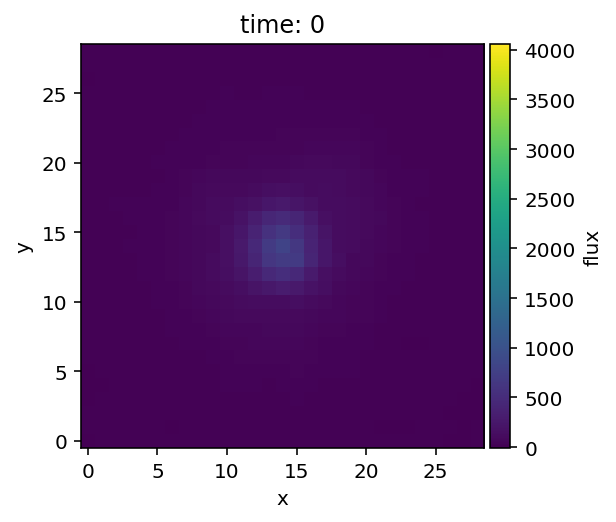

In [4]:
plot_cubes(psf)

As we can see, the flux varies as a function of wavelength. This reflects the intrinsic spectrum of the star but also the instrumental transmission and atmospheric absorption bands (e.g. associated to the water molecule) affecting some wavelengths more than others. The flux will be normalized in the next section, before injection.

Now let's check the **parallactic angle** and **airmass** variations:

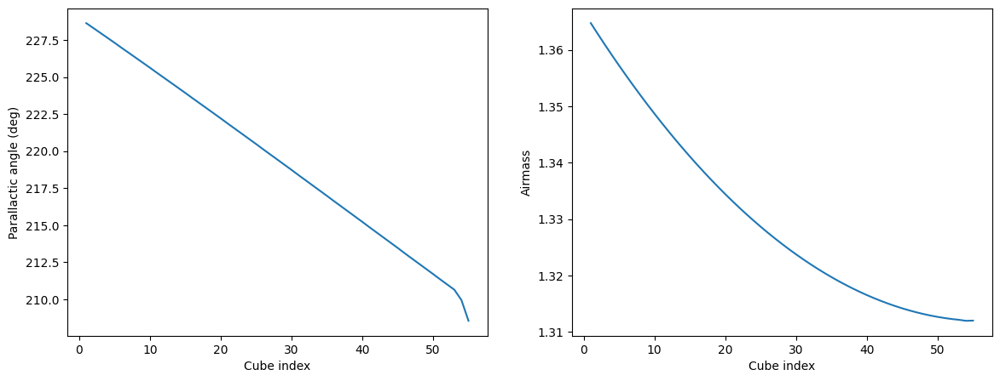

In [5]:
%matplotlib inline
fig, axes = plt.subplots(1,2, figsize = (14,5))
ax1, ax2 = axes
ax1.plot(range(1,nz+1), derot_angles)
ax1.set_xlabel("Cube index")
ax1.set_ylabel("Parallactic angle (deg)")
ax2.plot(range(1,nz+1), X_sci)
ax2.set_xlabel("Cube index")
ax2.set_ylabel("Airmass")
plt.show()

Note the sudden variation in parallactic angle at the end of the sequence is because we trimmed bad frames from the sequence (all were located towards the end of the observation).

Let's define the **pixel scale** for IFS - note that this is optional since the planet coordinates will be given in pixels. It will still be useful to have meaningful radial separations expressed in arcsec.

In [6]:
plsc = VLT_SPHERE_IFS['plsc']
print(plsc, "arcsec/px")

0.00746 arcsec/px


Let's now load and visualize the coronagraphic radial **transmission** profile:

In [7]:
trans = open_fits(path+"../datasets/sphere_ifs_YJ_APLC_CoroTransmission.fits")

FITS HDU-0 data successfully loaded. Data shape: (40, 23)


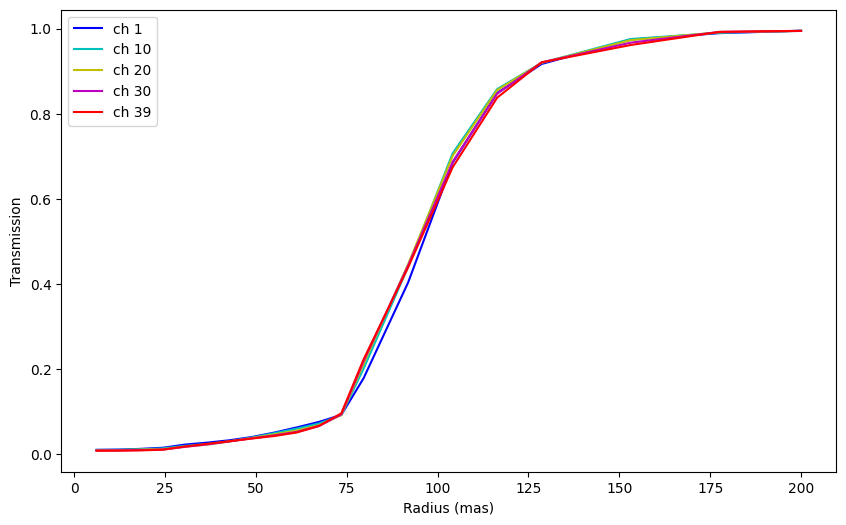

In [8]:
last_r = 20
plt.figure(figsize=(10,6))
plt.plot(trans[0,:last_r]*1000, trans[1,:last_r], 'b', label='ch 1')
plt.plot(trans[0,:last_r]*1000, trans[10,:last_r], 'c', label='ch 10')
plt.plot(trans[0,:last_r]*1000, trans[20,:last_r], 'y', label='ch 20')
plt.plot(trans[0,:last_r]*1000, trans[30,:last_r], 'm', label='ch 30')
plt.plot(trans[0,:last_r]*1000, trans[-1,:last_r], 'r', label='ch 39')
plt.xlabel("Radius (mas)")
plt.ylabel("Transmission")
plt.legend()

EDIT: this is not the most up-to-date SPHERE coronagraphic transmission curve. Please contact relevant SPHERE colleagues or check the ESO website for a newer version. Do not use the above curve for your research.

## 7.2. Planet parameters and spectra

Now let's set the **ground truth coordinates** and average **contrast** (over all wavelengths) at which two planets will be injected in this cube:

In [9]:
xy_b = (58.6,37.7)
contrast_b = 1e-3

xy_c = (83.8,29.9)
contrast_c = 2e-4

Let's convert cartesian to polar coordinates:

In [10]:
cy, cx = frame_center(cube)
r_b = dist(cy, cx, xy_b[1], xy_b[0])
r_c = dist(cy, cx, xy_c[1], xy_c[0])

theta_b = np.rad2deg(np.arctan2(xy_b[1]-cy, xy_b[0]-cx))
theta_c = np.rad2deg(np.arctan2(xy_c[1]-cy, xy_c[0]-cx))

In [11]:
print(cy, cx)
print(r_b, theta_b)
print(r_c, theta_c)

53 53
16.292636373527763 -69.89671372878468
38.5 -36.86989764584403


Now let's consider two fiducial model spectra for the injection of the 2 planets: a flat spectrum and a **1000K blackbody model** (note that this exercise is purely academic).

In [12]:
def blackbody(lbda, T): 
    fac = 2*c.h.value*(c.c.value**2)/(np.power(lbda*1e-6,5))
    div = (1/(np.exp((c.h.value*c.c.value)/((lbda*1e-6)*c.k_B.value*T))-1))
    # convert from W m-3 Sr-1 to W m-2 mu-1 Sr-1 
    conv = 1e-6
    return fac*div*conv

In [13]:
fluxes_b = np.ones_like(lbda)
fluxes_c = blackbody(lbda, 1000)

spec_b = np.array([lbda, fluxes_b])
spec_c = np.array([lbda, fluxes_c])

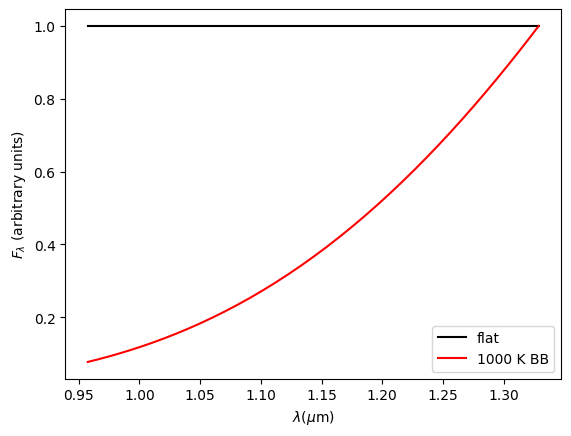

In [14]:
plt.plot(lbda, fluxes_b/np.amax(fluxes_b), 'k', label='flat')
plt.plot(lbda, fluxes_c/np.amax(fluxes_c), 'r', label='1000 K BB')
plt.xlabel(r"$\lambda (\mu$m)")
plt.ylabel(r"$ F_{\lambda}$ (arbitrary units)")
plt.legend()

## 7.3. Flux normalization

### 7.3.1. Non-coronagraphic PSF normalization

Let's measure the flux and FWHM of the non-coronagraphic PSF and normalize its flux to 1 in a 1-FWHM radius aperture (all at once), in all channels, using VIP's `fm/normalize_psf` function. We use the `debug` option to check that each 2D Gaussian fit worked properly:

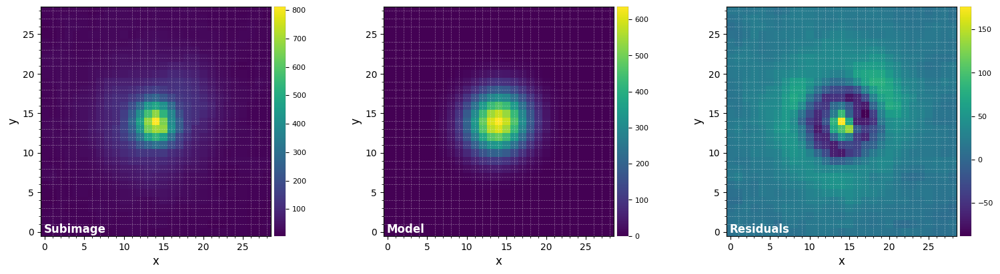

FWHM_y = 6.2499185906038734
FWHM_x = 5.955174570808004 

centroid y = 13.91271280451398
centroid x = 13.899308522396119
centroid y subim = 13.91271280451398
centroid x subim = 13.899308522396119 

amplitude = 636.3209207163184
theta = -40.20327494893463


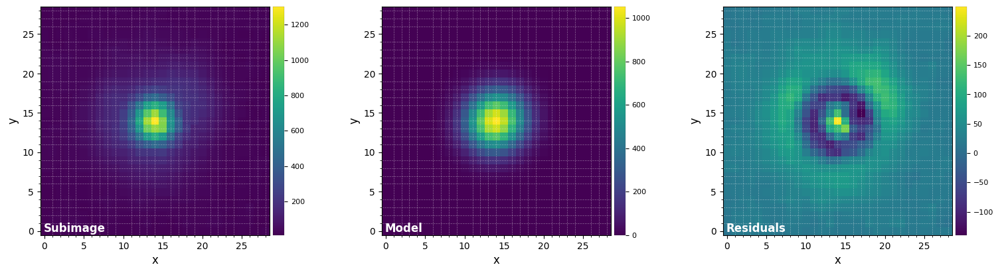

FWHM_y = 6.115031733429569
FWHM_x = 5.839092912200307 

centroid y = 14.027611189747118
centroid x = 13.902123414264741
centroid y subim = 14.027611189747118
centroid x subim = 13.902123414264741 

amplitude = 1054.2949916060757
theta = -37.53607125551687


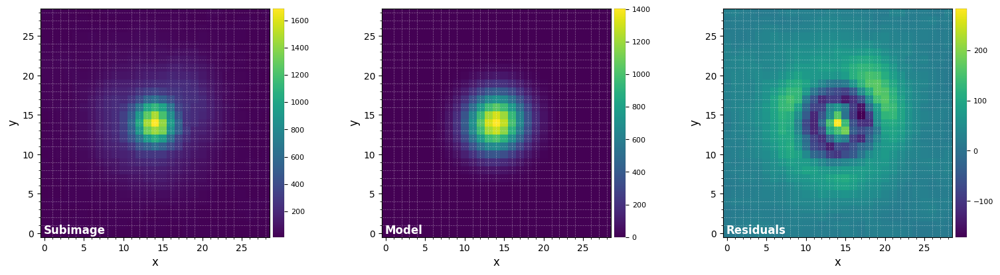

FWHM_y = 6.017536940985172
FWHM_x = 5.754055056932398 

centroid y = 14.064675014829234
centroid x = 13.921899407828272
centroid y subim = 14.064675014829234
centroid x subim = 13.921899407828272 

amplitude = 1404.794695125425
theta = -32.75340696040898


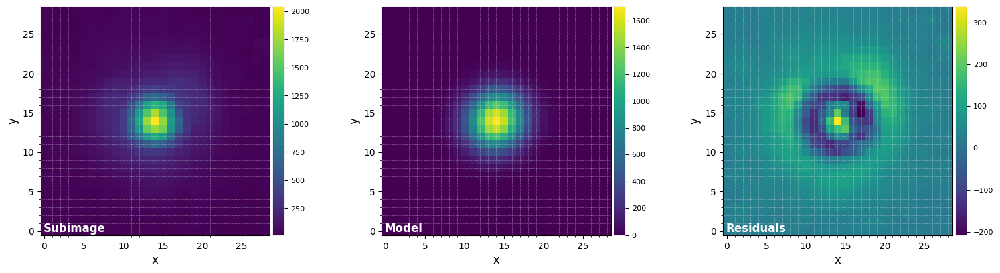

FWHM_y = 5.991878155204902
FWHM_x = 5.682647009421292 

centroid y = 14.065184394206566
centroid x = 13.946038597175642
centroid y subim = 14.065184394206566
centroid x subim = 13.946038597175642 

amplitude = 1705.2716467835362
theta = -37.3838283117331


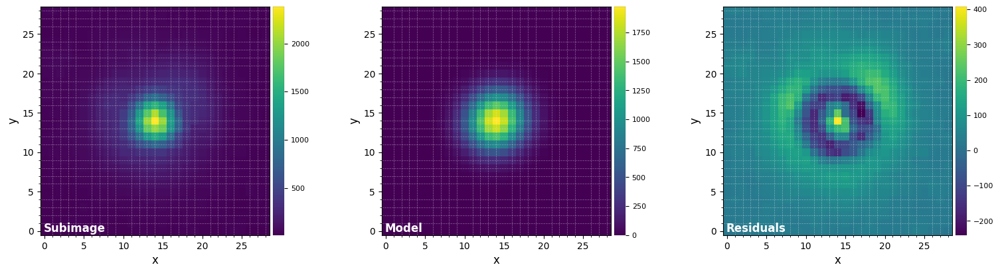

FWHM_y = 6.025210456840216
FWHM_x = 5.719302651409165 

centroid y = 14.075784813017492
centroid x = 13.955473078460203
centroid y subim = 14.075784813017492
centroid x subim = 13.955473078460203 

amplitude = 1975.5120237812189
theta = -39.22716810162709


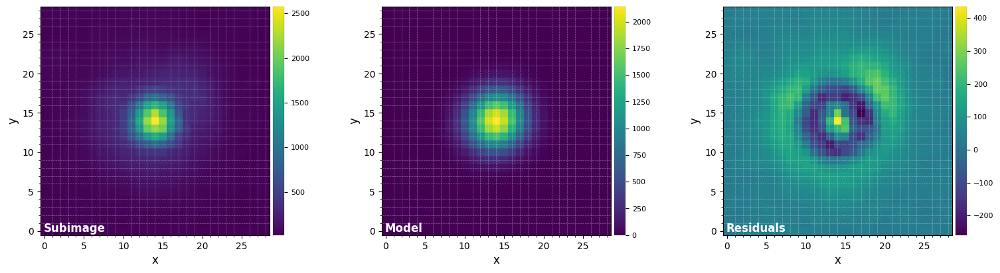

FWHM_y = 5.985037638845696
FWHM_x = 5.719904342290713 

centroid y = 14.090563585852337
centroid x = 13.954901979145369
centroid y subim = 14.090563585852337
centroid x subim = 13.954901979145369 

amplitude = 2143.9966998784653
theta = -37.89243906967075


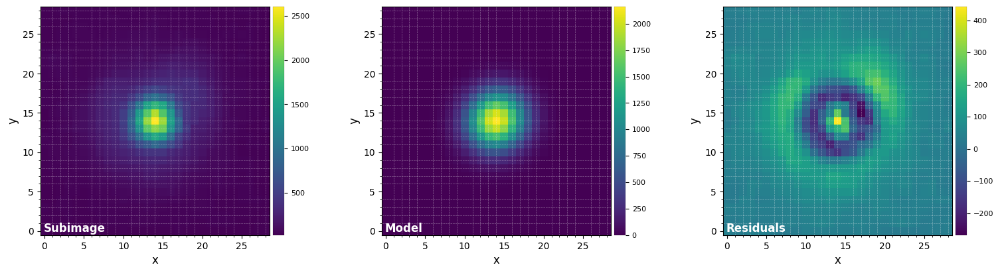

FWHM_y = 6.037449649433551
FWHM_x = 5.7537333670610575 

centroid y = 14.109510955089712
centroid x = 13.980317492176528
centroid y subim = 14.109510955089712
centroid x subim = 13.980317492176528 

amplitude = 2165.8668020759737
theta = -38.98816537803606


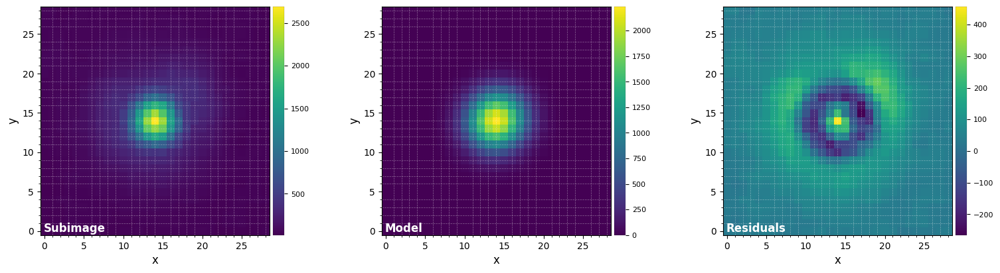

FWHM_y = 6.010425979656497
FWHM_x = 5.749988204486838 

centroid y = 14.09139902516843
centroid x = 13.986593684665714
centroid y subim = 14.09139902516843
centroid x subim = 13.986593684665714 

amplitude = 2237.452674183443
theta = -42.08255560940275


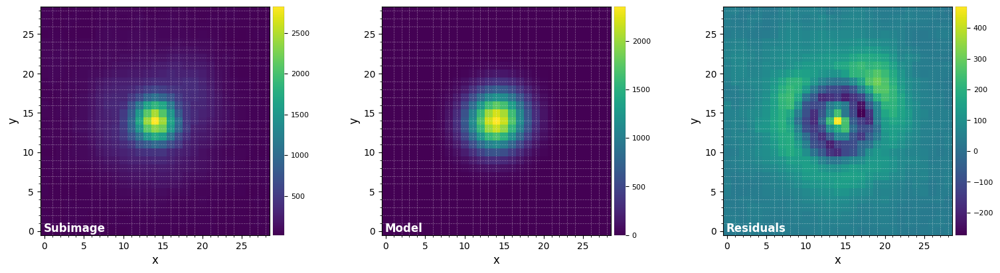

FWHM_y = 6.005151597188339
FWHM_x = 5.76618913736032 

centroid y = 14.090254937281216
centroid x = 14.000261828564383
centroid y subim = 14.090254937281216
centroid x subim = 14.000261828564383 

amplitude = 2355.107335363224
theta = -38.12872688402823


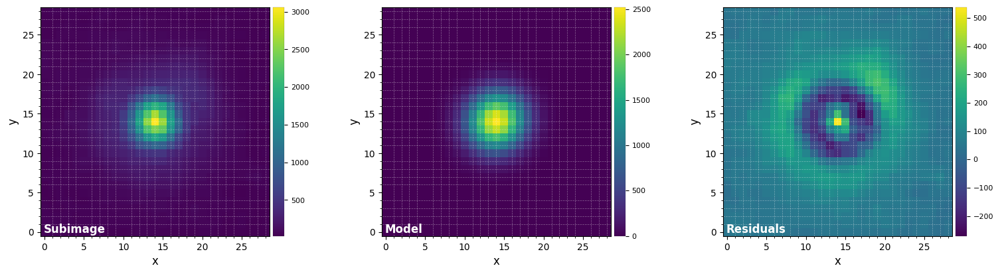

FWHM_y = 5.968097471114103
FWHM_x = 5.732989798767101 

centroid y = 14.102026780112466
centroid x = 14.00192256597961
centroid y subim = 14.102026780112466
centroid x subim = 14.00192256597961 

amplitude = 2523.9552216610077
theta = -36.166718794700756


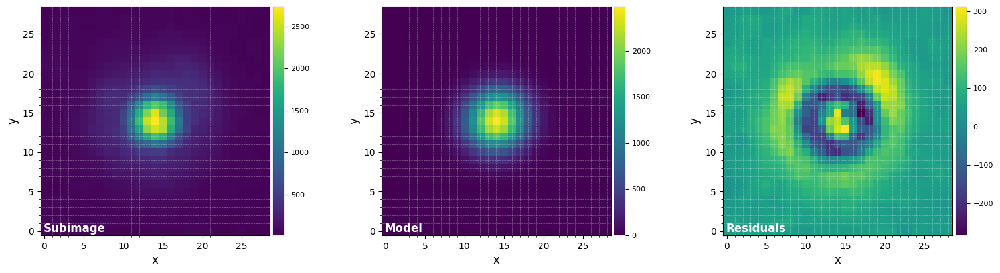

FWHM_y = 6.2010452530776154
FWHM_x = 5.952529125955214 

centroid y = 14.095618864845
centroid x = 14.011238141279225
centroid y subim = 14.095618864845
centroid x subim = 14.011238141279225 

amplitude = 2483.278573203233
theta = -40.01453306581354


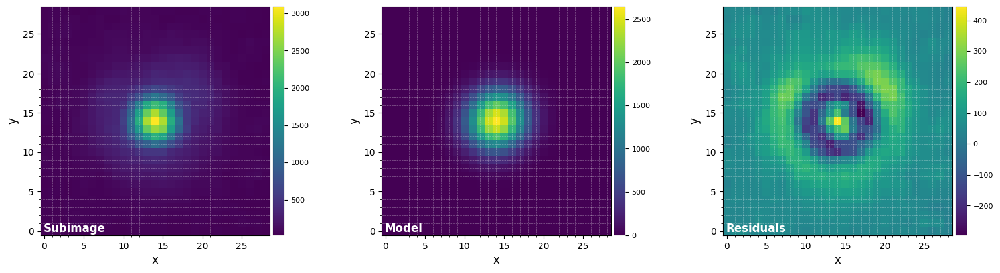

FWHM_y = 6.116743999603686
FWHM_x = 5.8392716209686455 

centroid y = 14.100847253492372
centroid x = 14.00962801008164
centroid y subim = 14.100847253492372
centroid x subim = 14.00962801008164 

amplitude = 2649.287384055851
theta = -42.972115252638694


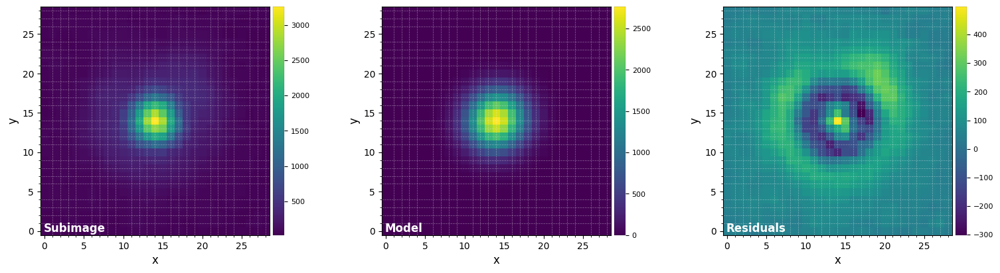

FWHM_y = 6.037056836634695
FWHM_x = 5.786392745945851 

centroid y = 14.110142788418528
centroid x = 14.004784235107898
centroid y subim = 14.110142788418528
centroid x subim = 14.004784235107898 

amplitude = 2770.024028598639
theta = -39.87700223679414


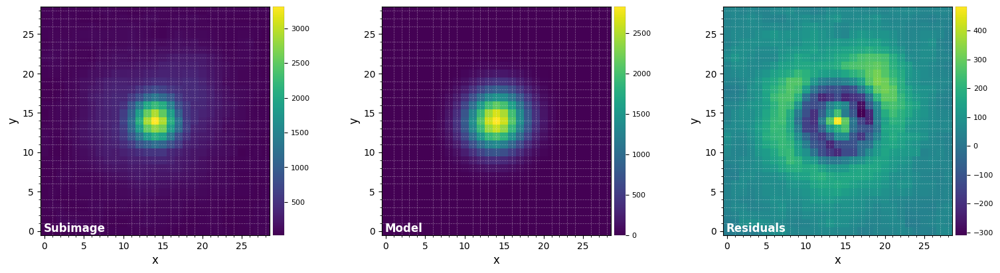

FWHM_y = 6.066318706454739
FWHM_x = 5.822724547903064 

centroid y = 14.099317823674594
centroid x = 14.003150239115127
centroid y subim = 14.099317823674594
centroid x subim = 14.003150239115127 

amplitude = 2830.2548549551825
theta = -47.812018317067206


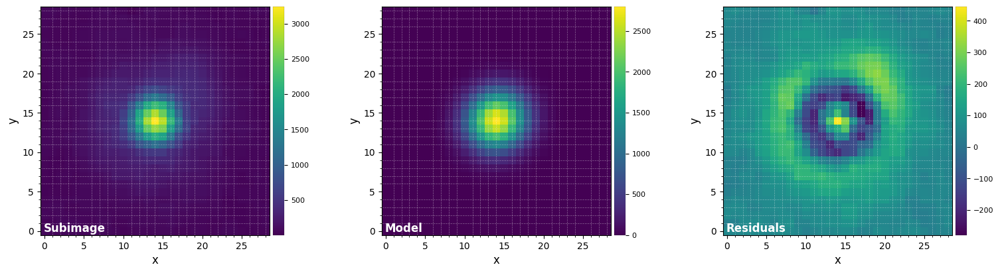

FWHM_y = 6.0762534866894
FWHM_x = 5.806486874018672 

centroid y = 14.112521461447967
centroid x = 14.034377198494248
centroid y subim = 14.112521461447967
centroid x subim = 14.034377198494248 

amplitude = 2803.4053532338025
theta = -1130.8992713799976


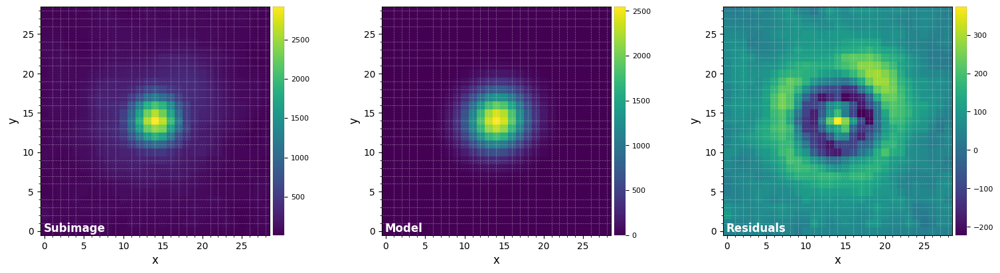

FWHM_y = 5.783408275201281
FWHM_x = 6.0947688987153565 

centroid y = 14.151451482312362
centroid x = 14.046235885495358
centroid y subim = 14.151451482312362
centroid x subim = 14.046235885495358 

amplitude = 2553.3202894435076
theta = -1046.1876651444493


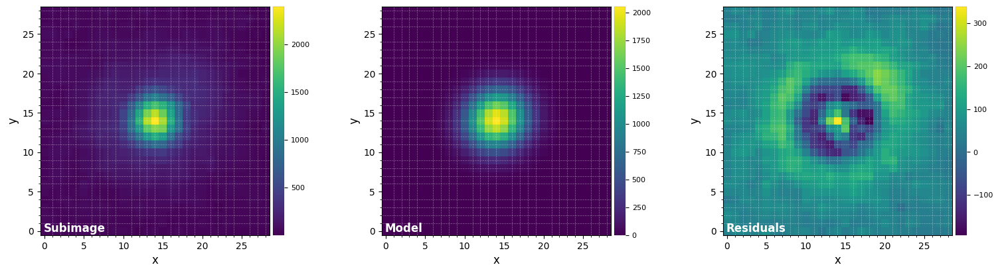

FWHM_y = 6.18160840917673
FWHM_x = 5.819390957373637 

centroid y = 14.20606445385617
centroid x = 14.027564827140305
centroid y subim = 14.20606445385617
centroid x subim = 14.027564827140305 

amplitude = 2063.1990467607516
theta = -591.897110332275


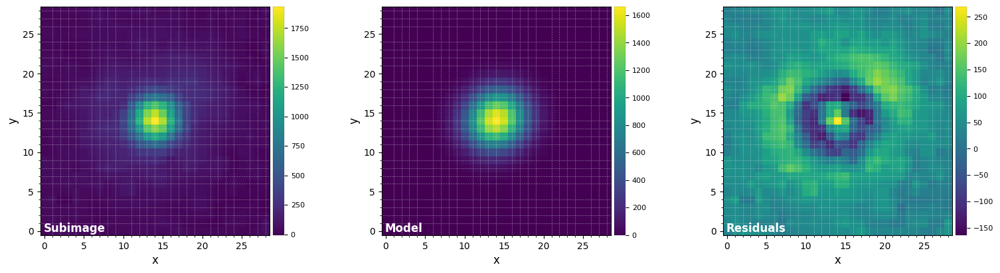

FWHM_y = 5.751799509227017
FWHM_x = 6.1765754988581305 

centroid y = 14.19949897448417
centroid x = 14.014692740126705
centroid y subim = 14.19949897448417
centroid x subim = 14.014692740126705 

amplitude = 1668.5838006836177
theta = 214.19574589903868


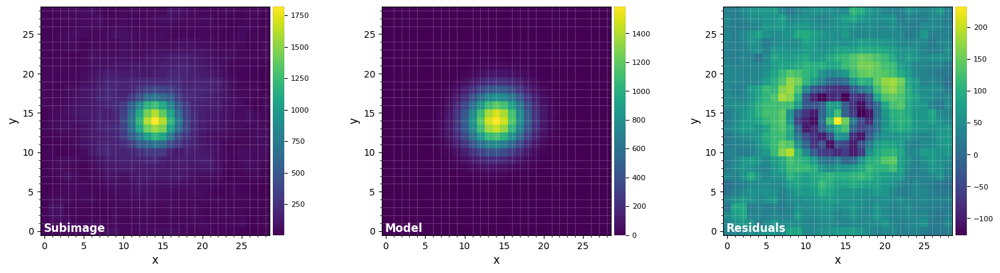

FWHM_y = 5.797247573087524
FWHM_x = 6.1407206833700165 

centroid y = 14.09188009914479
centroid x = 13.978278484577537
centroid y subim = 14.09188009914479
centroid x subim = 13.978278484577537 

amplitude = 1587.9799968312032
theta = 208.93362670690016


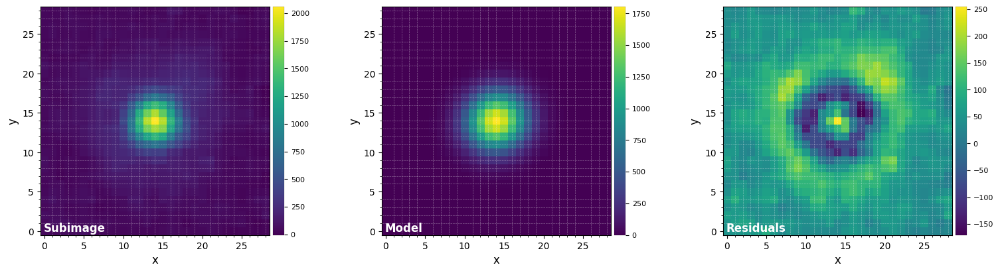

FWHM_y = 6.173286713166213
FWHM_x = 5.849770266197921 

centroid y = 14.020275158086994
centroid x = 14.002567343397786
centroid y subim = 14.020275158086994
centroid x subim = 14.002567343397786 

amplitude = 1805.5945901482098
theta = 117.55114919185252


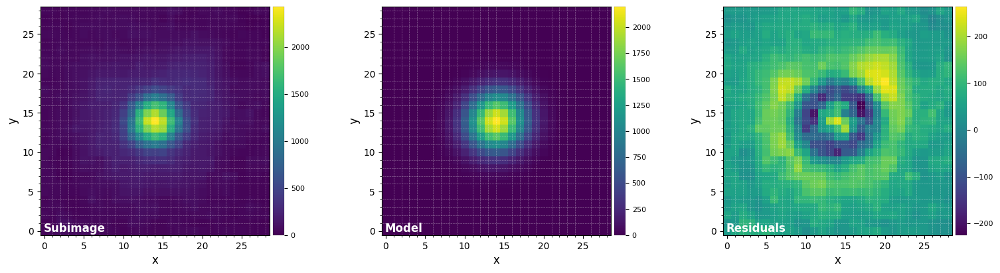

FWHM_y = 5.8792339430596385
FWHM_x = 6.127221726103625 

centroid y = 13.989753883492577
centroid x = 14.002807252408369
centroid y subim = 13.989753883492577
centroid x subim = 14.002807252408369 

amplitude = 2198.15726732781
theta = -320.21556683332454


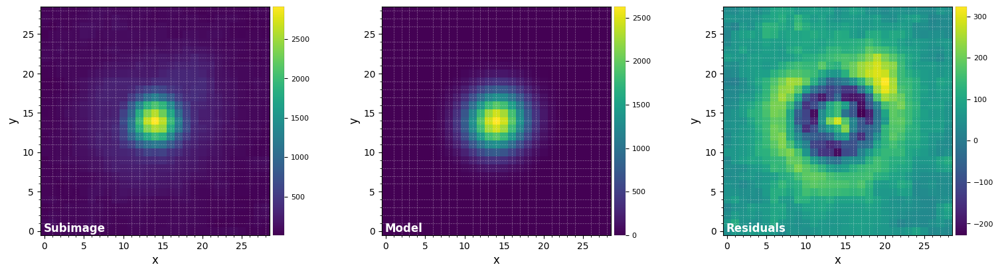

FWHM_y = 5.887171922875942
FWHM_x = 6.160164896057722 

centroid y = 14.006124941599417
centroid x = 14.009936779590372
centroid y subim = 14.006124941599417
centroid x subim = 14.009936779590372 

amplitude = 2628.450008946031
theta = -321.35901701076017


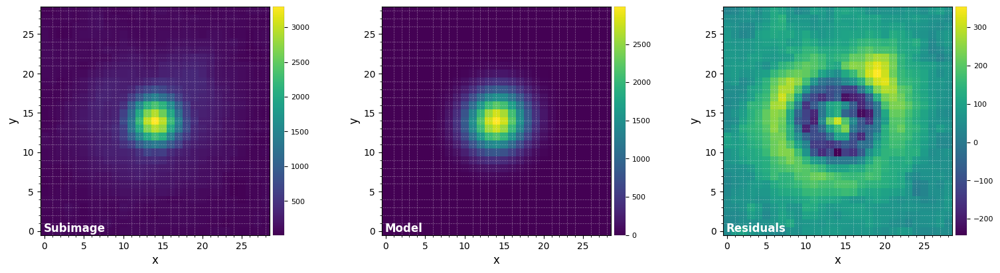

FWHM_y = 6.098319375621081
FWHM_x = 5.823811534748942 

centroid y = 14.045780781152429
centroid x = 14.014771011818317
centroid y subim = 14.045780781152429
centroid x subim = 14.014771011818317 

amplitude = 2992.271712291609
theta = -228.95610739084978


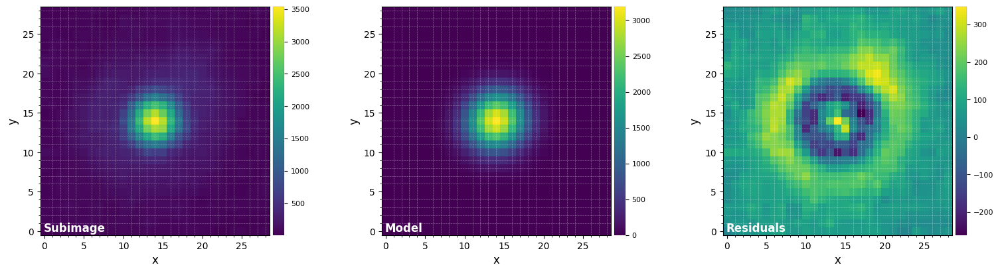

FWHM_y = 6.0881435225079805
FWHM_x = 5.800320948866406 

centroid y = 14.051247831816042
centroid x = 13.998093842075047
centroid y subim = 14.051247831816042
centroid x subim = 13.998093842075047 

amplitude = 3191.2868185639486
theta = -409.9397195034933


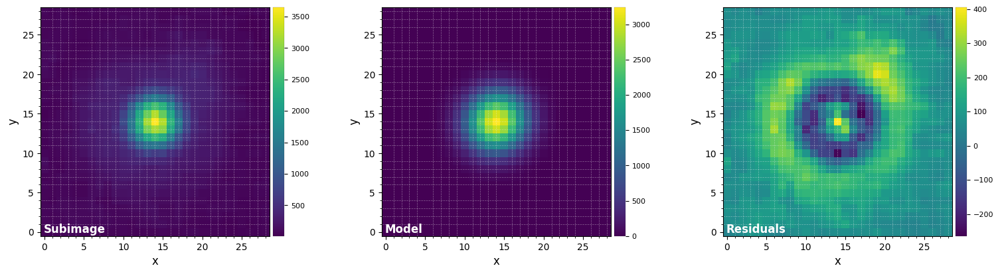

FWHM_y = 6.131166433598984
FWHM_x = 5.872212732710025 

centroid y = 14.035337815438458
centroid x = 13.998171477355866
centroid y subim = 14.035337815438458
centroid x subim = 13.998171477355866 

amplitude = 3243.1658846376727
theta = -50.094032052651215


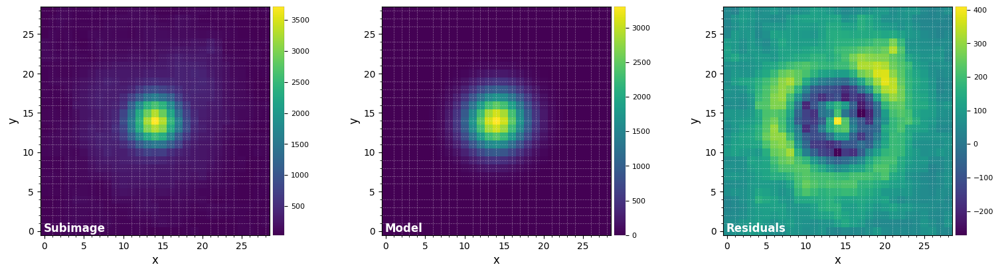

FWHM_y = 6.174942665281358
FWHM_x = 5.993212466027066 

centroid y = 14.039753518531834
centroid x = 13.991921001228043
centroid y subim = 14.039753518531834
centroid x subim = 13.991921001228043 

amplitude = 3307.870326350025
theta = -60.778524955012216


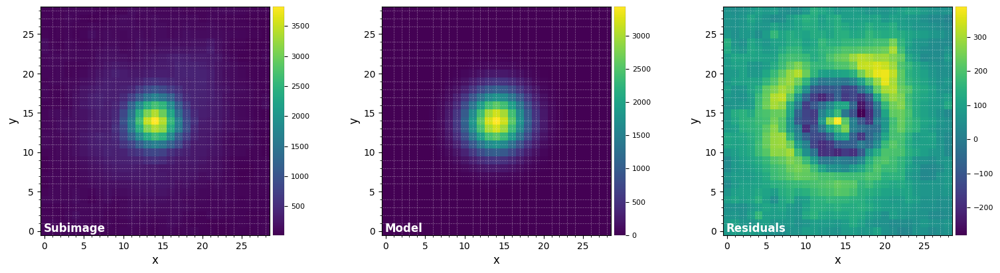

FWHM_y = 6.212946741792123
FWHM_x = 6.032862559194067 

centroid y = 14.009742407110084
centroid x = 13.967991908928983
centroid y subim = 14.009742407110084
centroid x subim = 13.967991908928983 

amplitude = 3436.0292572548005
theta = -233.0743437511544


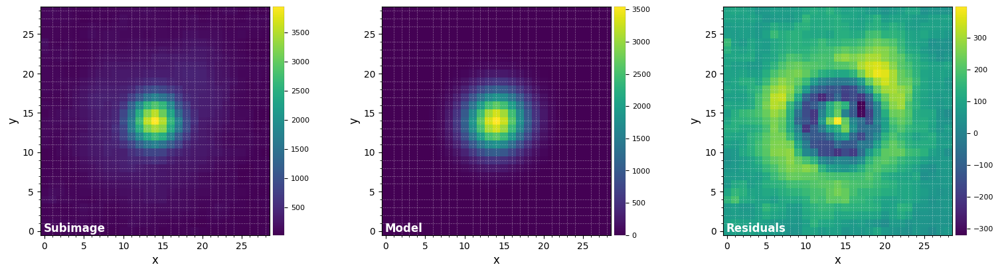

FWHM_y = 6.202834710260402
FWHM_x = 5.991454580720097 

centroid y = 14.020014512644996
centroid x = 13.952064722408837
centroid y subim = 14.020014512644996
centroid x subim = 13.952064722408837 

amplitude = 3546.6560417516
theta = -45.0887395475915


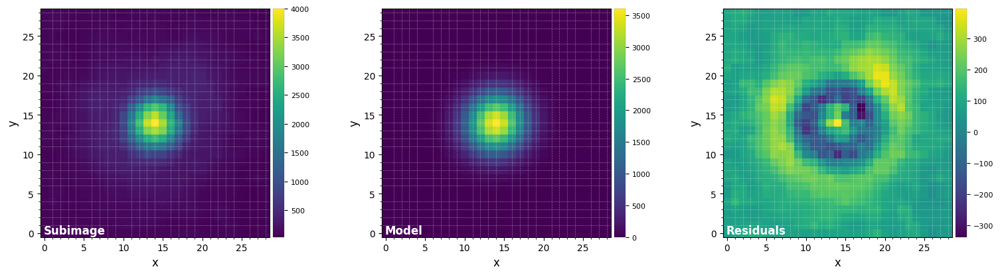

FWHM_y = 6.188582125824742
FWHM_x = 5.985402654686103 

centroid y = 14.01288592814225
centroid x = 13.933314914222532
centroid y subim = 14.01288592814225
centroid x subim = 13.933314914222532 

amplitude = 3607.1363107135303
theta = -45.54255278702486


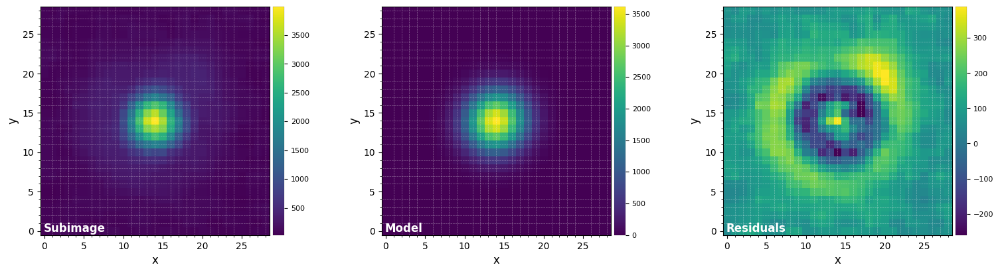

FWHM_y = 6.244755229547681
FWHM_x = 6.022172272874138 

centroid y = 14.005908973811751
centroid x = 13.928682611420811
centroid y subim = 14.005908973811751
centroid x subim = 13.928682611420811 

amplitude = 3616.190962501067
theta = -32.9257630430613


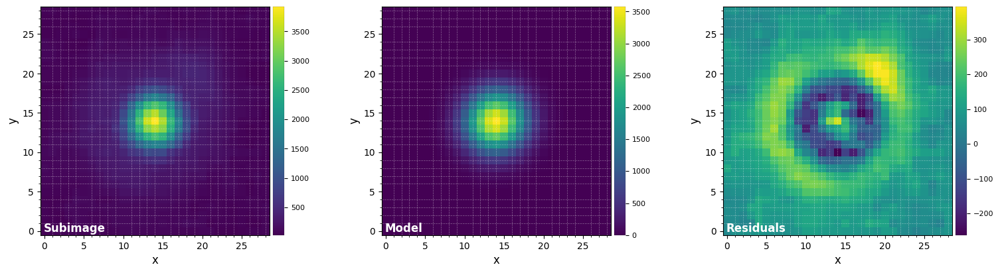

FWHM_y = 6.273041721822999
FWHM_x = 6.080609549848098 

centroid y = 13.982299985252563
centroid x = 13.934886096628695
centroid y subim = 13.982299985252563
centroid x subim = 13.934886096628695 

amplitude = 3579.5485931779963
theta = -38.8109468817101


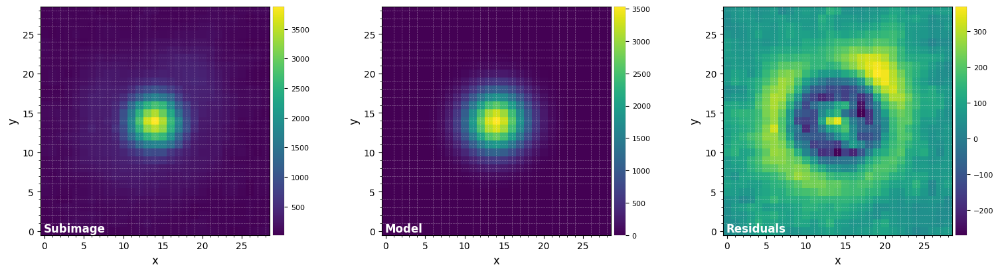

FWHM_y = 6.272897782073148
FWHM_x = 6.150604153616258 

centroid y = 13.949986873367504
centroid x = 13.940065010491569
centroid y subim = 13.949986873367504
centroid x subim = 13.940065010491569 

amplitude = 3535.362591691256
theta = -1487.0522520173815


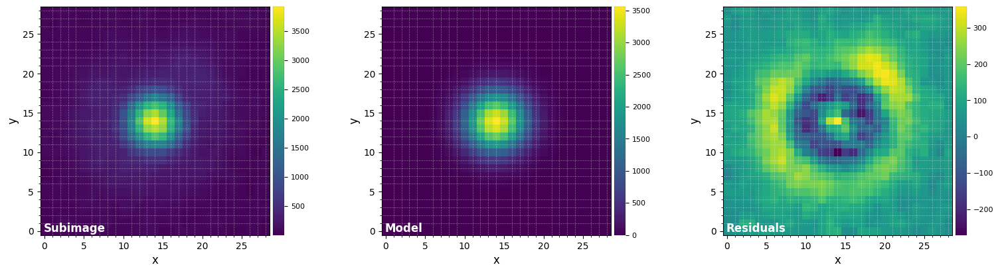

FWHM_y = 6.169653553625251
FWHM_x = 6.268150616054396 

centroid y = 13.93102667705402
centroid x = 13.920174694300993
centroid y subim = 13.93102667705402
centroid x subim = 13.920174694300993 

amplitude = 3562.2524885100333
theta = 32.84281796852144


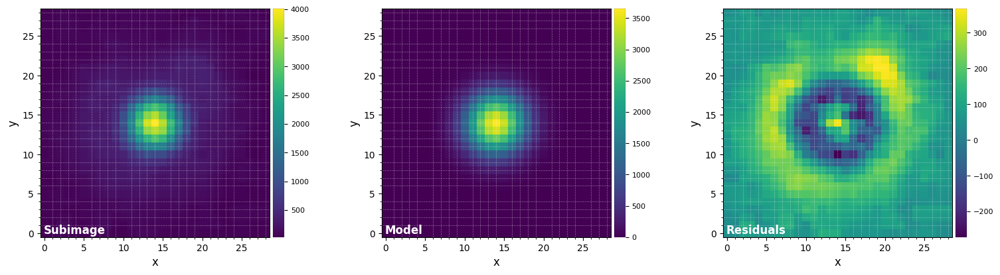

FWHM_y = 6.274537554461365
FWHM_x = 6.15783778729409 

centroid y = 13.934250084708731
centroid x = 13.921697907180066
centroid y subim = 13.934250084708731
centroid x subim = 13.921697907180066 

amplitude = 3655.6640709273543
theta = 129.00320367484554


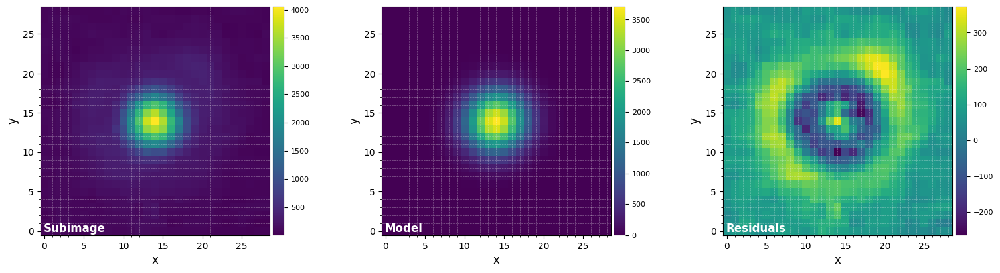

FWHM_y = 6.311436197883887
FWHM_x = 6.1353158474999905 

centroid y = 13.94518468204029
centroid x = 13.904558439173428
centroid y subim = 13.94518468204029
centroid x subim = 13.904558439173428 

amplitude = 3713.2225587915073
theta = -41.34373753295239


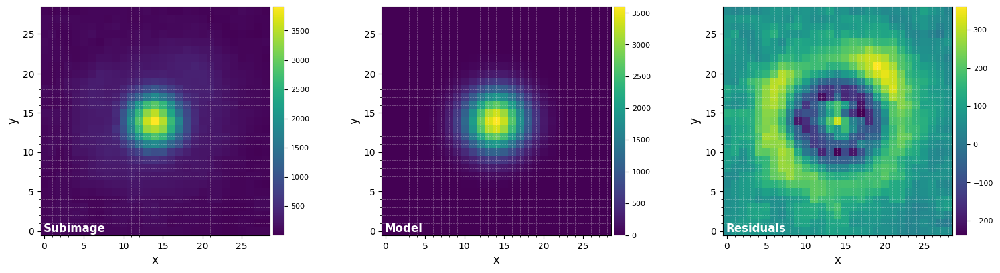

FWHM_y = 6.330588326064803
FWHM_x = 6.183593806778592 

centroid y = 13.972693149768391
centroid x = 13.88644208061843
centroid y subim = 13.972693149768391
centroid x subim = 13.88644208061843 

amplitude = 3603.9831791184242
theta = -39.62090236137112


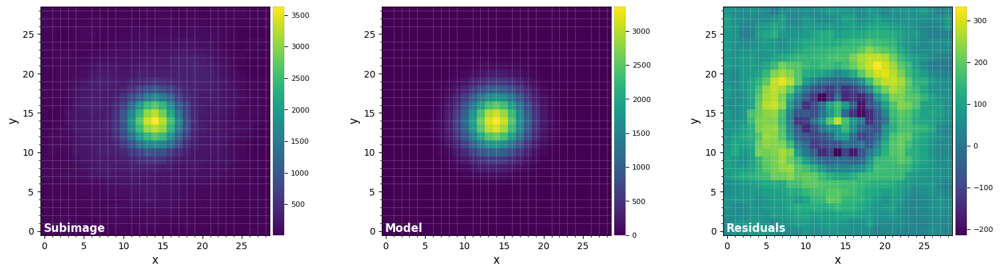

FWHM_y = 6.184001319791858
FWHM_x = 6.343494125581091 

centroid y = 13.949799213255506
centroid x = 13.88297982179931
centroid y subim = 13.949799213255506
centroid x subim = 13.88297982179931 

amplitude = 3362.4927849833225
theta = -131.56407953215066


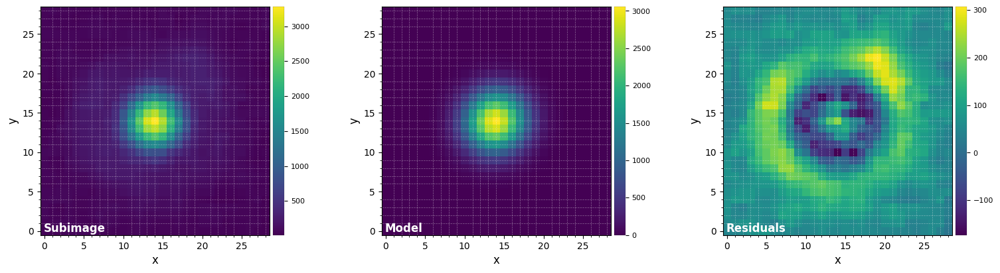

FWHM_y = 6.104938363807356
FWHM_x = 6.326105627594453 

centroid y = 13.96352838089737
centroid x = 13.869285619427107
centroid y subim = 13.96352838089737
centroid x subim = 13.869285619427107 

amplitude = 3062.496146821083
theta = -498.2520143063228


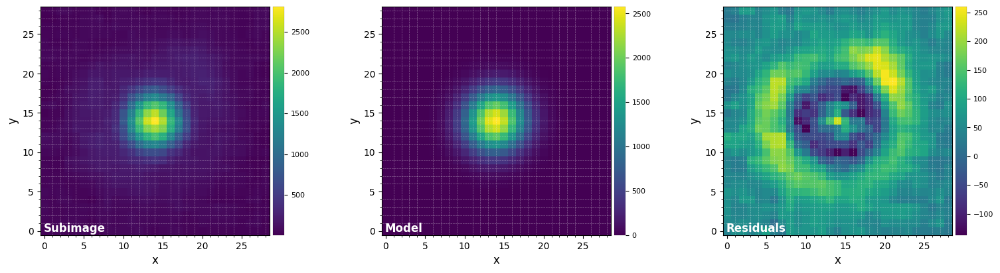

FWHM_y = 6.281872522406608
FWHM_x = 6.1068962716933175 

centroid y = 14.035165570900137
centroid x = 13.854666632371053
centroid y subim = 14.035165570900137
centroid x subim = 13.854666632371053 

amplitude = 2583.8408147326386
theta = -35.59944036195603
Mean FWHM per channel: 
[6.103 5.977 5.886 5.837 5.872 5.852 5.896 5.88  5.886 5.851 6.077 5.978
 5.912 5.945 5.941 5.939 6.    5.964 5.969 6.012 6.003 6.024 5.961 5.944
 6.002 6.084 6.123 6.097 6.087 6.133 6.177 6.212 6.219 6.216 6.223 6.257
 6.264 6.216 6.194]
Flux in 1xFWHM aperture: 
[13397.649 21373.517 27661.433 33057.763 38754.981 41781.661 42805.645
 44021.68  46395.703 49082.614 52371.307 53918.696 55093.806 56930.742
 56350.541 51298.303 42189.297 33733.493 32181.659 37142.073 45223.932
 54394.967 60556.863 64201.073 66477.378 69675.456 73203.718 74978.343
 76002.683 77311.678 77583.749 77448.172 78182.432 80187.787 81616.948
 80114.272 74899.496 67091.761 56185.008]


In [15]:
%matplotlib inline
psfn, flux_st, fwhm = normalize_psf(psf, fwhm='fit', full_output=True, debug=True)

Now let's plot the measured FWHM and stellar flux:

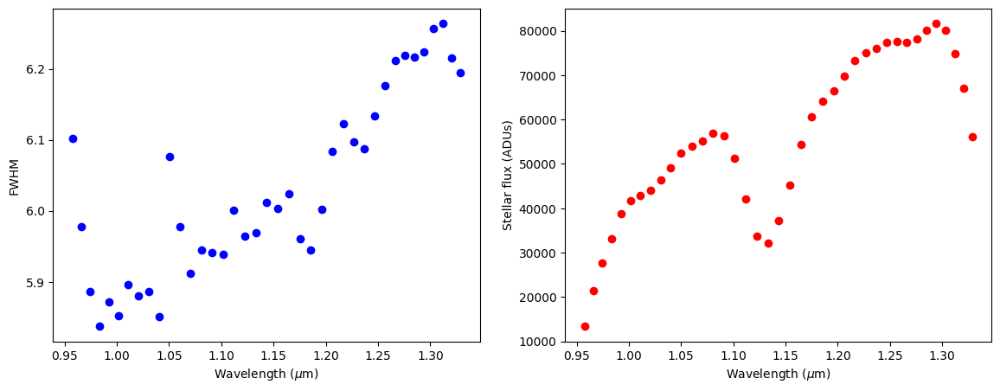

In [16]:
fig, axes = plt.subplots(1,2, figsize = (14,5))
ax1, ax2 = axes
ax1.plot(lbda, fwhm, 'bo')
ax1.set_xlabel(r"Wavelength ($\mu$m)")
ax1.set_ylabel("FWHM")
ax2.plot(lbda, flux_st, 'ro')
ax2.set_xlabel(r"Wavelength ($\mu$m)")
ax2.set_ylabel("Stellar flux (ADUs)")
plt.show()

**Fig. 3.1**: Measured FWHM and stellar flux in the non-coronagraphic PSF cube.

<img src='data:image/png;base64,iVBORw0KGgoAAAANSUhEUgAAAEAAAABACAYAAACqaXHeAAAABHNCSVQICAgIfAhkiAAAAAlwSFlz
AAAB+wAAAfsBxc2miwAAABl0RVh0U29mdHdhcmUAd3d3Lmlua3NjYXBlLm9yZ5vuPBoAAA6zSURB
VHic7ZtpeFRVmsf/5966taWqUlUJ2UioBBJiIBAwCZtog9IOgjqACsogKtqirT2ttt069nQ/zDzt
tI4+CrJIREFaFgWhBXpUNhHZQoKBkIUASchWla1S+3ar7r1nPkDaCAnZKoQP/D7mnPOe9/xy76n3
nFSAW9ziFoPFNED2LLK5wcyBDObkb8ZkxuaoSYlI6ZcOKq1eWFdedqNzGHQBk9RMEwFAASkk0Xw3
ETacDNi2vtvc7L0ROdw0AjoSotQVkKSvHQz/wRO1lScGModBFbDMaNRN1A4tUBCS3lk7BWhQkgpD
lG4852/+7DWr1R3uHAZVQDsbh6ZPN7CyxUrCzJMRouusj0ipRwD2uKm0Zn5d2dFwzX1TCGhnmdGo
G62Nna+isiUqhkzuKrkQaJlPEv5mFl2fvGg2t/VnzkEV8F5ioioOEWkLG86fvbpthynjdhXYZziQ
x1hC9J2NFyi8vCTt91Fh04KGip0AaG9zuCk2wQCVyoNU3Hjezee9bq92duzzTmxsRJoy+jEZZZYo
GTKJ6SJngdJqAfRzpze0+jHreUtPc7gpBLQnIYK6BYp/uGhw9YK688eu7v95ysgshcg9qSLMo3JC
4jqLKQFBgdKDPoQ+Pltb8dUyQLpeDjeVgI6EgLIQFT5tEl3rn2losHVsexbZ3EyT9wE1uGdkIPcy
BGxn8QUq1QrA5nqW5i2tLqvrrM9NK6AdkVIvL9E9bZL/oyfMVd/jqvc8LylzRBKDJSzIExwhQzuL
QYGQj4rHfFTc8mUdu3E7yoLtbTe9gI4EqVgVkug2i5+uXGo919ixbRog+3fTbQ8qJe4ZOYNfMoTI
OoshUNosgO60AisX15aeI2PSIp5KiFLI9ubb1vV3Qb2ltwLakUCDAkWX7/nHKRmmGIl9VgYsUhJm
2NXjKYADtM1ygne9QQDIXlk49FBstMKx66D1v4+XuQr7vqTe0VcBHQlRWiOCbmmSYe2SqtL6q5rJ
zsTb7lKx3FKOYC4DoqyS/B5bvLPxvD9Qtf6saxYLQGJErmDOdOMr/zo96km1nElr8bmPOBwI9COv
HnFPRIwmkSOv9kcAS4heRsidOkpeWBgZM+UBrTFAXNYL5Vf2ii9c1trNzpYdaoVil3WIc+wdk+gQ
noie3ecCcxt9ITcLAPWt/laGEO/9U6PmzZkenTtsSMQ8uYywJVW+grCstAvCIaAdArAsIWkRDDs/
KzLm2YcjY1Lv0UdW73HabE9n6V66cxSzfEmuJssTpKGVp+0vHq73FwL46eOjpMpbRAnNmJFrGJNu
Ukf9Yrz+3rghiumCKNXXWPhLYcjxGsIpoCMsIRoFITkW8AuyM8jC1+/QLx4bozCEJIq38+1rtpR6
V/yzb8eBlRb3fo5l783N0CWolAzJHaVNzkrTzlEp2bQ2q3TC5gn6wpnoQAmwSiGh2GitnTmVMc5O
UyfKWUKCIsU7+fZDKwqdT6DDpvkzAX4/+AMFjk0tDp5GRXLpQ2MUmhgDp5gxQT8+Y7hyPsMi8uxF
71H0oebujHALECjFKaW9Lm68n18wXp2kVzIcABytD5iXFzg+WVXkegpAsOOYziqo0OkK76GyquC3
ltZAzMhhqlSNmmWTE5T6e3IN05ITFLM4GdN0vtZ3ob8Jh1NAKXFbm5PtLU/eqTSlGjkNAJjdgn/N
aedXa0tdi7+t9G0FIF49rtMSEgAs1kDLkTPO7ebm4IUWeyh1bKomXqlgMG6kJmHcSM0clYLJ8XtR
1GTnbV3F6I5wCGikAb402npp1h1s7LQUZZSMIfALFOuL3UUrfnS8+rez7v9qcold5tilgHbO1fjK
9ubb17u9oshxzMiUBKXWqJNxd+fqb0tLVs4lILFnK71H0Ind7uiPgACVcFJlrb0tV6DzxqqTIhUM
CwDf1/rrVhTa33/3pGPxJYdQ2l2cbgVcQSosdx8uqnDtbGjh9SlDVSMNWhlnilfqZk42Th2ZpLpf
xrHec5e815zrr0dfBZSwzkZfqsv+1FS1KUknUwPARVvItfKUY+cn57yP7qv07UE3p8B2uhUwLk09
e0SCOrK+hbdYHYLjRIl71wWzv9jpEoeOHhGRrJAzyEyNiJuUqX0g2sBN5kGK6y2Blp5M3lsB9Qh4
y2Ja6x6+i0ucmKgwMATwhSjdUu49tKrQ/pvN5d53ml2CGwCmJipmKjgmyuaXzNeL2a0AkQ01Th5j
2DktO3Jyk8f9vcOBQHV94OK+fPumJmvQHxJoWkaKWq9Vs+yUsbq0zGT1I4RgeH2b5wef7+c7bl8F
eKgoHVVZa8ZPEORzR6sT1BzDUAD/d9F78e2Tzv99v8D+fLVTqAKAsbGamKey1Mt9Ann4eH3gTXTz
idWtAJ8PQWOk7NzSeQn/OTHDuEikVF1R4z8BQCy+6D1aWRfY0tTGG2OM8rRoPaeIj5ZHzJxszElN
VM8K8JS5WOfv8mzRnQAKoEhmt8gyPM4lU9SmBK1MCQBnW4KONT86v1hZ1PbwSXPw4JWussVjtH9Y
NCoiL9UoH/6PSu8jFrfY2t36erQHXLIEakMi1SydmzB31h3GGXFDFNPaK8Rme9B79Ixrd0WN+1ij
NRQ/doRmuFLBkHSTOm5GruG+pFjFdAmorG4IXH1Qua6ASniclfFtDYt+oUjKipPrCQB7QBQ2lrgP
fFzm+9XWUtcqJ3/5vDLDpJ79XHZk3u8nGZ42qlj1+ydtbxysCezrydp6ugmipNJ7WBPB5tydY0jP
HaVNzs3QzeE4ZpTbI+ZbnSFPbVOw9vsfnVvqWnirPyCNGD08IlqtYkh2hjZ5dErEQzoNm+6ykyOt
Lt5/PQEuSRRKo22VkydK+vvS1XEKlhCJAnsqvcVvH7f/ZU2R67eXbMEGAMiIV5oWZWiWvz5Fv2xG
sjqNJQRvn3Rs2lji/lNP19VjAQDgD7FHhujZB9OGqYxRkZxixgRDVlqS6uEOFaJUVu0rPFzctrnF
JqijImVp8dEKVWyUXDk92zAuMZ6bFwpBU1HrOw6AdhQgUooChb0+ItMbWJitSo5Ws3IAOGEOtL53
0vHZih9sC4vtofZ7Qu6523V/fmGcds1TY3V36pUsBwAbSlxnVh2xLfAD/IAIMDf7XYIkNmXfpp2l
18rkAJAy9HKFaIr/qULkeQQKy9zf1JgDB2uaeFNGijo5QsUyacNUUTOnGO42xSnv4oOwpDi1zYkc
efUc3I5Gk6PhyTuVKaOGyLUAYPGIoY9Pu/atL/L92+4q9wbflRJ2Trpm/jPjdBtfnqB/dIThcl8A
KG7hbRuKnb8qsQsVvVlTrwQAQMUlf3kwJI24Z4JhPMtcfng5GcH49GsrxJpGvvHIaeem2ma+KSjQ
lIwUdYyCY8j4dE1KzijNnIP2llF2wcXNnsoapw9XxsgYAl6k+KzUXbi2yP3KR2ecf6z3BFsBICdW
nvnIaG3eHybqX7vbpEqUMT+9OL4Qpe8VON7dXuFd39v19FoAABRVePbGGuXTszO0P7tu6lghUonE
llRdrhArLvmKdh9u29jcFiRRkfLUxBiFNiqSU9icoZQHo5mYBI1MBgBH6wMNb+U7Pnw337H4gi1Y
ciWs+uks3Z9fztUvfzxTm9Ne8XXkvQLHNytOOZeiD4e0PgkAIAYCYknKUNUDSXEKzdWNpnil7r4p
xqkjTarZMtk/K8TQ6Qve78qqvXurGwIJqcOUKfUWHsm8KGvxSP68YudXq4pcj39X49uOK2X142O0
Tz5/u/7TVybqH0rSya6ZBwD21/gubbrgWdDgEOx9W

:Dataset   [x,y,time]   (flux)
:Cube_shape	[29, 29, 39]


:DynamicMap   [time]
   :Image   [x,y]   (flux)
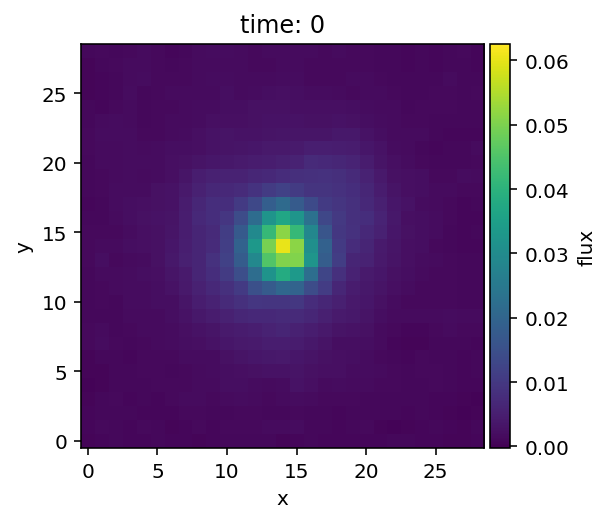

In [17]:
plot_cubes(psfn, grid=True)

Now let's save the measured spectrum of the star in the format we will need for the injection function:

In [18]:
spec_star = np.array([lbda, flux_st])

### 7.3.2. Stellar SED model

The spectral type of the star (HIP39826) is K7V. For the purpose of this tutorial, we simply load a BT-NextGen SED model that has already be resampled considering the spectral resolution and sampling of SPHERE-IFS:

In [19]:
spec_star_mod = open_fits("../datasets/sphere_ifs_HIP39826_SED_model.fits")

plt.plot(spec_star_mod[0], spec_star_mod[0]*spec_star_mod[1], 'k', label='Model SED for the star')
plt.ylabel(r"$\lambda F_{\lambda}$ (arbitrary units)")
plt.legend()

FITS HDU-0 data successfully loaded. Data shape: (2, 39)


### 7.3.3. Airmass

Airmass variation can also be taken into consideration during the injection of the planet spectra (more specifically we consider the ratio between individual airmass values and the median airmass over the observation):

In [20]:
med_X = np.median(X_sci)
X_fac = np.exp(-(X_sci-med_X))

Let's plot the factors to be applied to correct for airmass (w.r.t median airmass):

In [21]:
%matplotlib inline
plt.plot(range(1,nz+1), X_fac, 'k')
plt.xlabel("Cube index")
plt.ylabel("X factor")

Text(25.097222222222214, 0.5, 'X factor')

### 7.3.4. Final fluxes

Let's now calculate the fluxes at which the normalized PSF will actually be injected in each frame of each spectral cube.

Considering the effect of instrumental and atmospheric transmission, we have:

In [22]:
flux_b_trans = fluxes_b*(flux_st/spec_star_mod[1])
flux_c_trans = fluxes_c*(flux_st/spec_star_mod[1])                     

Considering the actual mean contrast we want the planet to be injected, with respect to the star, we have:

In [23]:
flux_b_scal = flux_b_trans*contrast_b*np.mean(flux_st)/np.mean(flux_b_trans)
flux_c_scal = flux_c_trans*contrast_c*np.mean(flux_st)/np.mean(flux_c_trans) 

Finally let's consider the airmass:

In [24]:
final_fluxes_b = np.outer(flux_b_scal, X_fac)
final_fluxes_c = np.outer(flux_c_scal, X_fac)

Note that the effect of coronagraphic transmission is directly taken into account in the injection function (next section).

## 7.4. Injection

The actual injection can be simply performed with the `cube_inject_companions` function, which can handle 4D input cubes. Let's inject the first planet first:

In [25]:
cube_fc = cube_inject_companions(cube, psfn, derot_angles, flevel=final_fluxes_b, 
                                 plsc=plsc, rad_dists=[r_b], n_branches=1, 
                                 theta=theta_b, transmission=trans, verbose=True)

*** Processing spectral channel 1/39 ***
*** Processing spectral channel 2/39 ***
*** Processing spectral channel 3/39 ***
*** Processing spectral channel 4/39 ***
*** Processing spectral channel 5/39 ***
*** Processing spectral channel 6/39 ***
*** Processing spectral channel 7/39 ***
*** Processing spectral channel 8/39 ***
*** Processing spectral channel 9/39 ***
*** Processing spectral channel 10/39 ***
*** Processing spectral channel 11/39 ***
*** Processing spectral channel 12/39 ***
*** Processing spectral channel 13/39 ***
*** Processing spectral channel 14/39 ***
*** Processing spectral channel 15/39 ***
*** Processing spectral channel 16/39 ***
*** Processing spectral channel 17/39 ***
*** Processing spectral channel 18/39 ***
*** Processing spectral channel 19/39 ***
*** Processing spectral channel 20/39 ***
*** Processing spectral channel 21/39 ***
*** Processing spectral channel 22/39 ***
*** Processing spectral channel 23/39 ***
*** Processing spectral channel 24/39 ***
*

Let's now inject the second planet in the same cube:

In [26]:
cube_fc = cube_inject_companions(cube_fc, psfn, derot_angles, flevel=final_fluxes_c, 
                                 plsc=plsc, rad_dists=[r_c], n_branches=1, 
                                 theta=theta_c, transmission=trans, verbose=False)

Let's inspect the cube with the inject companions:

<img src='data:image/png;base64,iVBORw0KGgoAAAANSUhEUgAAAEAAAABACAYAAACqaXHeAAAABHNCSVQICAgIfAhkiAAAAAlwSFlz
AAAB+wAAAfsBxc2miwAAABl0RVh0U29mdHdhcmUAd3d3Lmlua3NjYXBlLm9yZ5vuPBoAAA6zSURB
VHic7ZtpeFRVmsf/5966taWqUlUJ2UioBBJiIBAwCZtog9IOgjqACsogKtqirT2ttt069nQ/zDzt
tI4+CrJIREFaFgWhBXpUNhHZQoKBkIUASchWla1S+3ar7r1nPkDaCAnZKoQP/D7mnPOe9/xy76n3
nFSAW9ziFoPFNED2LLK5wcyBDObkb8ZkxuaoSYlI6ZcOKq1eWFdedqNzGHQBk9RMEwFAASkk0Xw3
ETacDNi2vtvc7L0ROdw0AjoSotQVkKSvHQz/wRO1lScGModBFbDMaNRN1A4tUBCS3lk7BWhQkgpD
lG4852/+7DWr1R3uHAZVQDsbh6ZPN7CyxUrCzJMRouusj0ipRwD2uKm0Zn5d2dFwzX1TCGhnmdGo
G62Nna+isiUqhkzuKrkQaJlPEv5mFl2fvGg2t/VnzkEV8F5ioioOEWkLG86fvbpthynjdhXYZziQ
x1hC9J2NFyi8vCTt91Fh04KGip0AaG9zuCk2wQCVyoNU3Hjezee9bq92duzzTmxsRJoy+jEZZZYo
GTKJ6SJngdJqAfRzpze0+jHreUtPc7gpBLQnIYK6BYp/uGhw9YK688eu7v95ysgshcg9qSLMo3JC
4jqLKQFBgdKDPoQ+Pltb8dUyQLpeDjeVgI6EgLIQFT5tEl3rn2losHVsexbZ3EyT9wE1uGdkIPcy
BGxn8QUq1QrA5nqW5i2tLqvrrM9NK6AdkVIvL9E9bZL/oyfMVd/jqvc8LylzRBKDJSzIExwhQzuL
QYGQj4rHfFTc8mUdu3E7yoLtbTe9gI4EqVgVkug2i5+uXGo919ixbRog+3fTbQ8qJe4ZOYNfMoTI
OoshUNosgO60AisX15aeI2PSIp5KiFLI9ubb1vV3Qb2ltwLakUCDAkWX7/nHKRmmGIl9VgYsUhJm
2NXjKYADtM1ygne9QQDIXlk49FBstMKx66D1v4+XuQr7vqTe0VcBHQlRWiOCbmmSYe2SqtL6q5rJ
zsTb7lKx3FKOYC4DoqyS/B5bvLPxvD9Qtf6saxYLQGJErmDOdOMr/zo96km1nElr8bmPOBwI9COv
HnFPRIwmkSOv9kcAS4heRsidOkpeWBgZM+UBrTFAXNYL5Vf2ii9c1trNzpYdaoVil3WIc+wdk+gQ
noie3ecCcxt9ITcLAPWt/laGEO/9U6PmzZkenTtsSMQ8uYywJVW+grCstAvCIaAdArAsIWkRDDs/
KzLm2YcjY1Lv0UdW73HabE9n6V66cxSzfEmuJssTpKGVp+0vHq73FwL46eOjpMpbRAnNmJFrGJNu
Ukf9Yrz+3rghiumCKNXXWPhLYcjxGsIpoCMsIRoFITkW8AuyM8jC1+/QLx4bozCEJIq38+1rtpR6
V/yzb8eBlRb3fo5l783N0CWolAzJHaVNzkrTzlEp2bQ2q3TC5gn6wpnoQAmwSiGh2GitnTmVMc5O
UyfKWUKCIsU7+fZDKwqdT6DDpvkzAX4/+AMFjk0tDp5GRXLpQ2MUmhgDp5gxQT8+Y7hyPsMi8uxF
71H0oebujHALECjFKaW9Lm68n18wXp2kVzIcABytD5iXFzg+WVXkegpAsOOYziqo0OkK76GyquC3
ltZAzMhhqlSNmmWTE5T6e3IN05ITFLM4GdN0vtZ3ob8Jh1NAKXFbm5PtLU/eqTSlGjkNAJjdgn/N
aedXa0tdi7+t9G0FIF49rtMSEgAs1kDLkTPO7ebm4IUWeyh1bKomXqlgMG6kJmHcSM0clYLJ8XtR
1GTnbV3F6I5wCGikAb402npp1h1s7LQUZZSMIfALFOuL3UUrfnS8+rez7v9qcold5tilgHbO1fjK
9ubb17u9oshxzMiUBKXWqJNxd+fqb0tLVs4lILFnK71H0Ind7uiPgACVcFJlrb0tV6DzxqqTIhUM
CwDf1/rrVhTa33/3pGPxJYdQ2l2cbgVcQSosdx8uqnDtbGjh9SlDVSMNWhlnilfqZk42Th2ZpLpf
xrHec5e815zrr0dfBZSwzkZfqsv+1FS1KUknUwPARVvItfKUY+cn57yP7qv07UE3p8B2uhUwLk09
e0SCOrK+hbdYHYLjRIl71wWzv9jpEoeOHhGRrJAzyEyNiJuUqX0g2sBN5kGK6y2Blp5M3lsB9Qh4
y2Ja6x6+i0ucmKgwMATwhSjdUu49tKrQ/pvN5d53ml2CGwCmJipmKjgmyuaXzNeL2a0AkQ01Th5j
2DktO3Jyk8f9vcOBQHV94OK+fPumJmvQHxJoWkaKWq9Vs+yUsbq0zGT1I4RgeH2b5wef7+c7bl8F
eKgoHVVZa8ZPEORzR6sT1BzDUAD/d9F78e2Tzv99v8D+fLVTqAKAsbGamKey1Mt9Ann4eH3gTXTz
idWtAJ8PQWOk7NzSeQn/OTHDuEikVF1R4z8BQCy+6D1aWRfY0tTGG2OM8rRoPaeIj5ZHzJxszElN
VM8K8JS5WOfv8mzRnQAKoEhmt8gyPM4lU9SmBK1MCQBnW4KONT86v1hZ1PbwSXPw4JWussVjtH9Y
NCoiL9UoH/6PSu8jFrfY2t36erQHXLIEakMi1SydmzB31h3GGXFDFNPaK8Rme9B79Ixrd0WN+1ij
NRQ/doRmuFLBkHSTOm5GruG+pFjFdAmorG4IXH1Qua6ASniclfFtDYt+oUjKipPrCQB7QBQ2lrgP
fFzm+9XWUtcqJ3/5vDLDpJ79XHZk3u8nGZ42qlj1+ydtbxysCezrydp6ugmipNJ7WBPB5tydY0jP
HaVNzs3QzeE4ZpTbI+ZbnSFPbVOw9vsfnVvqWnirPyCNGD08IlqtYkh2hjZ5dErEQzoNm+6ykyOt
Lt5/PQEuSRRKo22VkydK+vvS1XEKlhCJAnsqvcVvH7f/ZU2R67eXbMEGAMiIV5oWZWiWvz5Fv2xG
sjqNJQRvn3Rs2lji/lNP19VjAQDgD7FHhujZB9OGqYxRkZxixgRDVlqS6uEOFaJUVu0rPFzctrnF
JqijImVp8dEKVWyUXDk92zAuMZ6bFwpBU1HrOw6AdhQgUooChb0+ItMbWJitSo5Ws3IAOGEOtL53
0vHZih9sC4vtofZ7Qu6523V/fmGcds1TY3V36pUsBwAbSlxnVh2xLfAD/IAIMDf7XYIkNmXfpp2l
18rkAJAy9HKFaIr/qULkeQQKy9zf1JgDB2uaeFNGijo5QsUyacNUUTOnGO42xSnv4oOwpDi1zYkc
efUc3I5Gk6PhyTuVKaOGyLUAYPGIoY9Pu/atL/L92+4q9wbflRJ2Trpm/jPjdBtfnqB/dIThcl8A
KG7hbRuKnb8qsQsVvVlTrwQAQMUlf3kwJI24Z4JhPMtcfng5GcH49GsrxJpGvvHIaeem2ma+KSjQ
lIwUdYyCY8j4dE1KzijNnIP2llF2wcXNnsoapw9XxsgYAl6k+KzUXbi2yP3KR2ecf6z3BFsBICdW
nvnIaG3eHybqX7vbpEqUMT+9OL4Qpe8VON7dXuFd39v19FoAABRVePbGGuXTszO0P7tu6lghUonE
llRdrhArLvmKdh9u29jcFiRRkfLUxBiFNiqSU9icoZQHo5mYBI1MBgBH6wMNb+U7Pnw337H4gi1Y
ciWs+uks3Z9fztUvfzxTm9Ne8XXkvQLHNytOOZeiD4e0PgkAIAYCYknKUNUDSXEKzdWNpnil7r4p
xqkjTarZMtk/K8TQ6Qve78qqvXurGwIJqcOUKfUWHsm8KGvxSP68YudXq4pcj39X49uOK2X142O0
Tz5/u/7TVybqH0rSya6ZBwD21/gubbrgWdDgEOx9W

:Dataset   [x,y,time,lambda]   (flux)
:Cube_shape	[107, 107, 55, 39]


:DynamicMap   [time,lambda]
   :Image   [x,y]   (flux)
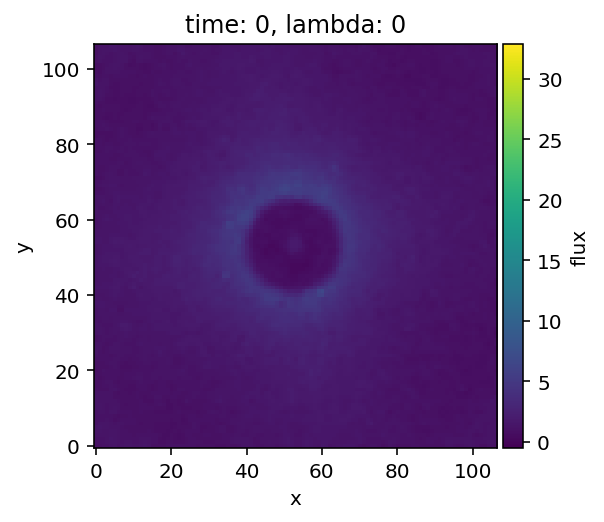

In [27]:
plot_cubes(cube_fc)

[Go to the top](#Table-of-contents)

## 7.5. Post-processing of IFS data

Let's now try to recover the 2 injected companions using different post-processing algorithms.

### 7.5.1. Optimal scaling factors

In order to leverage the radial expansion of the stellar PSF with wavelength through spectral differential imaging, let's first compute the optimal scaling factors between the spectral channels. For a perfect AO correction and flat stellar spectrum, one would expect the scaling factors to be (exactly) inversely proportional to the wavelength. Reality deviates a bit from these assumptions but this still makes for a good first guess:

In [28]:
th_scal = lbda[-1]/lbda
th_scal

array([1.3877398, 1.375682 , 1.3635113, 1.3512615, 1.3389585, 1.3266245,
       1.3142908, 1.3019674, 1.2896852, 1.2774729, 1.2653329, 1.2532798,
       1.2413497, 1.2295421, 1.217879 , 1.2063586, 1.1950108, 1.1838219,
       1.1728301, 1.1620203, 1.151418 , 1.1410172, 1.1308315, 1.1208638,
       1.1111166, 1.1016016, 1.092311 , 1.0832641, 1.0744526, 1.0658859,
       1.0575558, 1.0494791, 1.0416555, 1.0340765, 1.0267497, 1.0196825,
       1.0128585, 1.0063006, 1.       ], dtype=float32)

Let's use `preproc.find_scal_vector` to refine this estimate. This function will find the optimal scaling factors (both in terms of geometric scaling and flux scaling) between each spectral channel and the last one such that their subtraction yields minimal residuals. For coronagraphic observations, it is recommended to provide a binary `mask`, corresponding to the location where the residuals will be calculated, which avoids the area encompassed by the coronagraphic mask, in order to achieve the best estimate.
Here we use the mean of the 4D cube along the temporal direction to find the factors:

In [29]:
mask = np.ones_like(cube[0,0])
mask = mask_circle(mask, int(0.16/plsc))

opt_scal_mean, opt_flux = find_scal_vector(np.mean(cube,axis=1), lbda, flux_st, 
                                           mask=mask, nfp=2, fm="stddev")

Although a bit slower, another approach would be to calculate the scaling factors for each individual spectral cube, and use the median values:

In [30]:
opt_scals = np.zeros([cube.shape[1],cube.shape[0]])
opt_fluxes = np.zeros([cube.shape[1],cube.shape[0]])
for i in range(cube.shape[1]):
    opt_scals[i], opt_fluxes[i] = find_scal_vector(cube[:,i], lbda, flux_st, mask=mask, nfp=2, fm="stddev")

In [31]:
opt_scal_med = np.median(opt_scals,axis=0)
opt_flux_med = np.median(opt_fluxes,axis=0)

Let's plot the theoretical and empirical scaling factors: 

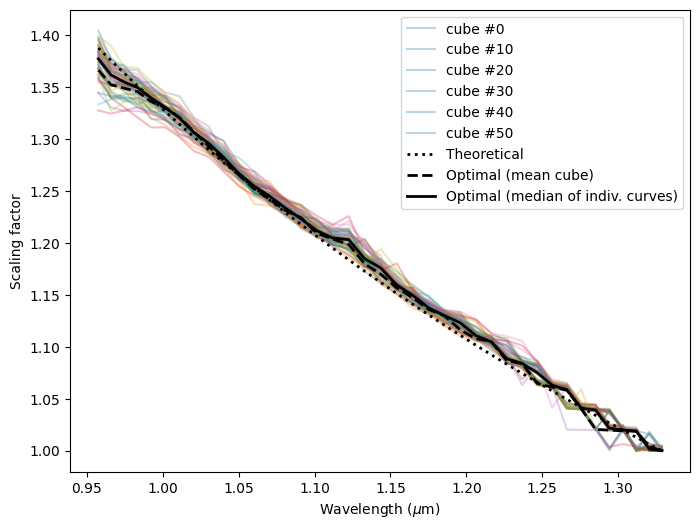

In [32]:
%matplotlib inline
plt.figure(figsize=(8,6))
for i in range(cube.shape[1]):
    if not i%10:
        label = 'cube #{}'.format(i)
    else:
        label = None
    plt.plot(lbda, opt_scals[i], alpha=0.3, label=label)
plt.plot(lbda, th_scal, 'k:', lw=2, label='Theoretical')
plt.plot(lbda, opt_scal_mean, 'k--', lw=2, label='Optimal (mean cube)')
plt.plot(lbda, np.median(opt_scals,axis=0), 'k-', lw=2, label='Optimal (median of indiv. curves)')
plt.xlabel(r"Wavelength ($\mu$m)")
plt.ylabel("Scaling factor")
plt.legend()

Let's visualize the actual residuals in the first spectral cube:

In [33]:
res_cube_test_opt = np.zeros([cube.shape[0],cube.shape[-2],cube.shape[-1]])
for i in range(cube.shape[0]):
    res_cube_test_opt[i] = opt_fluxes[0,i]*frame_rescaling(cube[i,0], scale=opt_scal_med[i])-cube[-1,0]

<img src='data:image/png;base64,iVBORw0KGgoAAAANSUhEUgAAAEAAAABACAYAAACqaXHeAAAABHNCSVQICAgIfAhkiAAAAAlwSFlz
AAAB+wAAAfsBxc2miwAAABl0RVh0U29mdHdhcmUAd3d3Lmlua3NjYXBlLm9yZ5vuPBoAAA6zSURB
VHic7ZtpeFRVmsf/5966taWqUlUJ2UioBBJiIBAwCZtog9IOgjqACsogKtqirT2ttt069nQ/zDzt
tI4+CrJIREFaFgWhBXpUNhHZQoKBkIUASchWla1S+3ar7r1nPkDaCAnZKoQP/D7mnPOe9/xy76n3
nFSAW9ziFoPFNED2LLK5wcyBDObkb8ZkxuaoSYlI6ZcOKq1eWFdedqNzGHQBk9RMEwFAASkk0Xw3
ETacDNi2vtvc7L0ROdw0AjoSotQVkKSvHQz/wRO1lScGModBFbDMaNRN1A4tUBCS3lk7BWhQkgpD
lG4852/+7DWr1R3uHAZVQDsbh6ZPN7CyxUrCzJMRouusj0ipRwD2uKm0Zn5d2dFwzX1TCGhnmdGo
G62Nna+isiUqhkzuKrkQaJlPEv5mFl2fvGg2t/VnzkEV8F5ioioOEWkLG86fvbpthynjdhXYZziQ
x1hC9J2NFyi8vCTt91Fh04KGip0AaG9zuCk2wQCVyoNU3Hjezee9bq92duzzTmxsRJoy+jEZZZYo
GTKJ6SJngdJqAfRzpze0+jHreUtPc7gpBLQnIYK6BYp/uGhw9YK688eu7v95ysgshcg9qSLMo3JC
4jqLKQFBgdKDPoQ+Pltb8dUyQLpeDjeVgI6EgLIQFT5tEl3rn2losHVsexbZ3EyT9wE1uGdkIPcy
BGxn8QUq1QrA5nqW5i2tLqvrrM9NK6AdkVIvL9E9bZL/oyfMVd/jqvc8LylzRBKDJSzIExwhQzuL
QYGQj4rHfFTc8mUdu3E7yoLtbTe9gI4EqVgVkug2i5+uXGo919ixbRog+3fTbQ8qJe4ZOYNfMoTI
OoshUNosgO60AisX15aeI2PSIp5KiFLI9ubb1vV3Qb2ltwLakUCDAkWX7/nHKRmmGIl9VgYsUhJm
2NXjKYADtM1ygne9QQDIXlk49FBstMKx66D1v4+XuQr7vqTe0VcBHQlRWiOCbmmSYe2SqtL6q5rJ
zsTb7lKx3FKOYC4DoqyS/B5bvLPxvD9Qtf6saxYLQGJErmDOdOMr/zo96km1nElr8bmPOBwI9COv
HnFPRIwmkSOv9kcAS4heRsidOkpeWBgZM+UBrTFAXNYL5Vf2ii9c1trNzpYdaoVil3WIc+wdk+gQ
noie3ecCcxt9ITcLAPWt/laGEO/9U6PmzZkenTtsSMQ8uYywJVW+grCstAvCIaAdArAsIWkRDDs/
KzLm2YcjY1Lv0UdW73HabE9n6V66cxSzfEmuJssTpKGVp+0vHq73FwL46eOjpMpbRAnNmJFrGJNu
Ukf9Yrz+3rghiumCKNXXWPhLYcjxGsIpoCMsIRoFITkW8AuyM8jC1+/QLx4bozCEJIq38+1rtpR6
V/yzb8eBlRb3fo5l783N0CWolAzJHaVNzkrTzlEp2bQ2q3TC5gn6wpnoQAmwSiGh2GitnTmVMc5O
UyfKWUKCIsU7+fZDKwqdT6DDpvkzAX4/+AMFjk0tDp5GRXLpQ2MUmhgDp5gxQT8+Y7hyPsMi8uxF
71H0oebujHALECjFKaW9Lm68n18wXp2kVzIcABytD5iXFzg+WVXkegpAsOOYziqo0OkK76GyquC3
ltZAzMhhqlSNmmWTE5T6e3IN05ITFLM4GdN0vtZ3ob8Jh1NAKXFbm5PtLU/eqTSlGjkNAJjdgn/N
aedXa0tdi7+t9G0FIF49rtMSEgAs1kDLkTPO7ebm4IUWeyh1bKomXqlgMG6kJmHcSM0clYLJ8XtR
1GTnbV3F6I5wCGikAb402npp1h1s7LQUZZSMIfALFOuL3UUrfnS8+rez7v9qcold5tilgHbO1fjK
9ubb17u9oshxzMiUBKXWqJNxd+fqb0tLVs4lILFnK71H0Ind7uiPgACVcFJlrb0tV6DzxqqTIhUM
CwDf1/rrVhTa33/3pGPxJYdQ2l2cbgVcQSosdx8uqnDtbGjh9SlDVSMNWhlnilfqZk42Th2ZpLpf
xrHec5e815zrr0dfBZSwzkZfqsv+1FS1KUknUwPARVvItfKUY+cn57yP7qv07UE3p8B2uhUwLk09
e0SCOrK+hbdYHYLjRIl71wWzv9jpEoeOHhGRrJAzyEyNiJuUqX0g2sBN5kGK6y2Blp5M3lsB9Qh4
y2Ja6x6+i0ucmKgwMATwhSjdUu49tKrQ/pvN5d53ml2CGwCmJipmKjgmyuaXzNeL2a0AkQ01Th5j
2DktO3Jyk8f9vcOBQHV94OK+fPumJmvQHxJoWkaKWq9Vs+yUsbq0zGT1I4RgeH2b5wef7+c7bl8F
eKgoHVVZa8ZPEORzR6sT1BzDUAD/d9F78e2Tzv99v8D+fLVTqAKAsbGamKey1Mt9Ann4eH3gTXTz
idWtAJ8PQWOk7NzSeQn/OTHDuEikVF1R4z8BQCy+6D1aWRfY0tTGG2OM8rRoPaeIj5ZHzJxszElN
VM8K8JS5WOfv8mzRnQAKoEhmt8gyPM4lU9SmBK1MCQBnW4KONT86v1hZ1PbwSXPw4JWussVjtH9Y
NCoiL9UoH/6PSu8jFrfY2t36erQHXLIEakMi1SydmzB31h3GGXFDFNPaK8Rme9B79Ixrd0WN+1ij
NRQ/doRmuFLBkHSTOm5GruG+pFjFdAmorG4IXH1Qua6ASniclfFtDYt+oUjKipPrCQB7QBQ2lrgP
fFzm+9XWUtcqJ3/5vDLDpJ79XHZk3u8nGZ42qlj1+ydtbxysCezrydp6ugmipNJ7WBPB5tydY0jP
HaVNzs3QzeE4ZpTbI+ZbnSFPbVOw9vsfnVvqWnirPyCNGD08IlqtYkh2hjZ5dErEQzoNm+6ykyOt
Lt5/PQEuSRRKo22VkydK+vvS1XEKlhCJAnsqvcVvH7f/ZU2R67eXbMEGAMiIV5oWZWiWvz5Fv2xG
sjqNJQRvn3Rs2lji/lNP19VjAQDgD7FHhujZB9OGqYxRkZxixgRDVlqS6uEOFaJUVu0rPFzctrnF
JqijImVp8dEKVWyUXDk92zAuMZ6bFwpBU1HrOw6AdhQgUooChb0+ItMbWJitSo5Ws3IAOGEOtL53
0vHZih9sC4vtofZ7Qu6523V/fmGcds1TY3V36pUsBwAbSlxnVh2xLfAD/IAIMDf7XYIkNmXfpp2l
18rkAJAy9HKFaIr/qULkeQQKy9zf1JgDB2uaeFNGijo5QsUyacNUUTOnGO42xSnv4oOwpDi1zYkc
efUc3I5Gk6PhyTuVKaOGyLUAYPGIoY9Pu/atL/L92+4q9wbflRJ2Trpm/jPjdBtfnqB/dIThcl8A
KG7hbRuKnb8qsQsVvVlTrwQAQMUlf3kwJI24Z4JhPMtcfng5GcH49GsrxJpGvvHIaeem2ma+KSjQ
lIwUdYyCY8j4dE1KzijNnIP2llF2wcXNnsoapw9XxsgYAl6k+KzUXbi2yP3KR2ecf6z3BFsBICdW
nvnIaG3eHybqX7vbpEqUMT+9OL4Qpe8VON7dXuFd39v19FoAABRVePbGGuXTszO0P7tu6lghUonE
llRdrhArLvmKdh9u29jcFiRRkfLUxBiFNiqSU9icoZQHo5mYBI1MBgBH6wMNb+U7Pnw337H4gi1Y
ciWs+uks3Z9fztUvfzxTm9Ne8XXkvQLHNytOOZeiD4e0PgkAIAYCYknKUNUDSXEKzdWNpnil7r4p
xqkjTarZMtk/K8TQ6Qve78qqvXurGwIJqcOUKfUWHsm8KGvxSP68YudXq4pcj39X49uOK2X142O0
Tz5/u/7TVybqH0rSya6ZBwD21/gubbrgWdDgEOx9W

:Dataset   [x,y,time]   (flux)
:Cube_shape	[107, 107, 39]


:DynamicMap   [time]
   :Image   [x,y]   (flux)
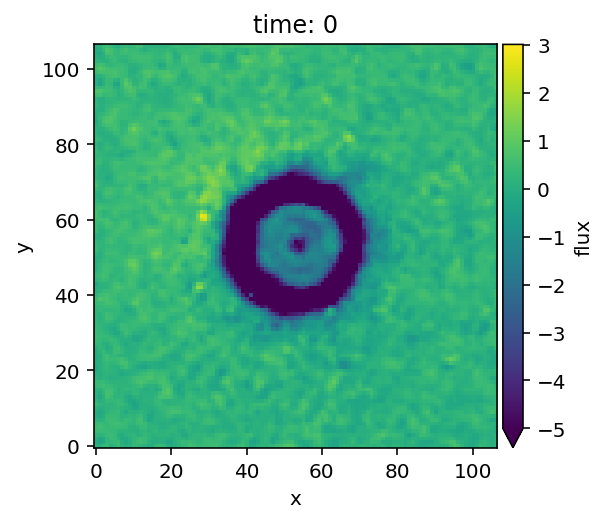

In [34]:
plot_cubes(res_cube_test_opt, vmin=-5)

Apart from the residual starlight at the edge of the coronagraphic mask (which does not expand radially), we see that the stellar halo is very well subtracted.

### 7.5.2. median-SDI 

The most basic way to leverage the radial diversity present in IFS data is to perform median-SDI (i.e. the radial equivalent to median-ADI). For that just use the `psfsub.median_sub` function, with the `sdi_only` option on: 

In [35]:
mask_px = int(0.1/plsc)

med_SDI = median_sub(cube_fc, derot_angles, scale_list=opt_scal_med, sdi_only=True,
                     radius_int=mask_px, interp_zeros=True, mask_val=0)

――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Starting time: 2023-09-04 21:01:03
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
39 spectral channels per IFS frame
First median subtraction exploiting spectral variability
Running time:  0:00:18.411018
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
55 ADI frames
Median subtraction in the ADI fashion
Done derotating and combining
Running time:  0:00:20.763640
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――


For better results, it is recommended to use both the geometrical and flux scaling factors found in the previous section:

In [36]:
med_SDI_opt = median_sub(cube_fc, derot_angles, scale_list=opt_scal_med, flux_sc_list=opt_flux_med, sdi_only=True,
                         radius_int=mask_px, interp_zeros=True, mask_val=0)

――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Starting time: 2023-09-04 21:01:24
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
39 spectral channels per IFS frame
First median subtraction exploiting spectral variability
Running time:  0:00:18.761731
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
55 ADI frames
Median subtraction in the ADI fashion
Done derotating and combining
Running time:  0:00:21.129925
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――


Let's compare both reductions, showing circles at the ground truth locations where we injected the fake companions.

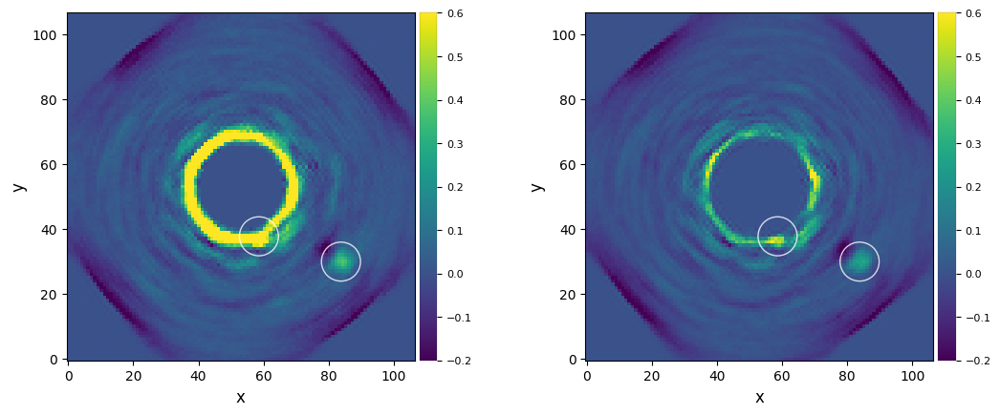

In [37]:
%matplotlib inline
plot_frames((med_SDI, med_SDI_opt), circle=(xy_b,xy_c), vmin=-0.2, vmax=0.6)

In the first image, we notice the limitation of SDI at short angular separation. Since the stellar residuals at the edge of the coronagraphic mask do not expand radially as the rest of the stellar halo, we are left with a bright spurious ring, preventing the re-detection of fake planet b.

We see that the median-SDI reduction with scaled fluxes performs slightly better at subtracting stellar residuals near the edge of the coronagraphic mask, although fake planet b is still not recovered.

Fake planet c is redetected. Let's compare its signal-to-noise ratio in both images:

In [38]:
snr_c = snr(med_SDI, xy_c, fwhm=np.mean(fwhm), exclude_negative_lobes=True)
snr_c_sc = snr(med_SDI_opt, xy_c, fwhm=np.mean(fwhm), exclude_negative_lobes=True)
print(snr_c, snr_c_sc)

19.817929423515157 23.22640656961355


Overall, we can conclude that the scaled flux version of median-SDI performs better than the non-flux scaled version.

### 7.5.3. PCA-SDI 

Let's now run a PCA-SDI reduction. Note that this approach may be useful in datasets with azimuthally extended disc features (since ADI can filter such signals). 

For PCA reductions, flux scaling factors are not necessary. This is because: i) the basis is orthonormal and an internal scaling is performed anyway when the principal components are projected onto each images; ii) flux scaling will typically increase the noise contribution before calculation of the principal components, which can bias their values. Our tests suggest indeed that better results are obtained (i.e. higher SNR for injected fake planets) when no flux scaling factor is considered before PCA.

#### 7.5.3.1. Full-frame PCA

To trigger SDI alone with the `psfsub.pca` function, you need to set: 

- `adimsdi='double'` to separate the PCA-SDI and PCA-ADI
- `ncomp` to a tuple of 2 values, the first of which being the number of principal components for PCA-SDI, and the second to be set to None - to prevent PCA-ADI (i.e. simply derotate and stack the SDI residual images);

Let's use the `mask_center_px` argument to set a numerical mask of 0.1'' radius in order not to include the coronagraphic mask.

In [39]:
ncomp_sdi = 1
mask_px = int(0.1/plsc)

pca_sdi = pca(cube_fc, derot_angles, scale_list=opt_scal_med, ncomp=(ncomp_sdi,None), 
              adimsdi='double', crop_ifs=False, imlib='opencv', 
              interp_zeros=True, mask_val=0, mask_center_px=mask_px)

――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Starting time: 2023-09-04 21:01:45
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
System total memory = 17.180 GB
System available memory = 1.049 GB
39 spectral channels in IFS cube
First PCA stage exploiting spectral variability
Running time:  0:00:22.523683
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
55 ADI frames
De-rotating and combining frames (skipping PCA)
Running time:  0:00:22.572396
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――


Let's show the final image with and without the application of a large (0.15'' radius) numerical mask, and with circles at the ground truth location where we injected the fake companions.

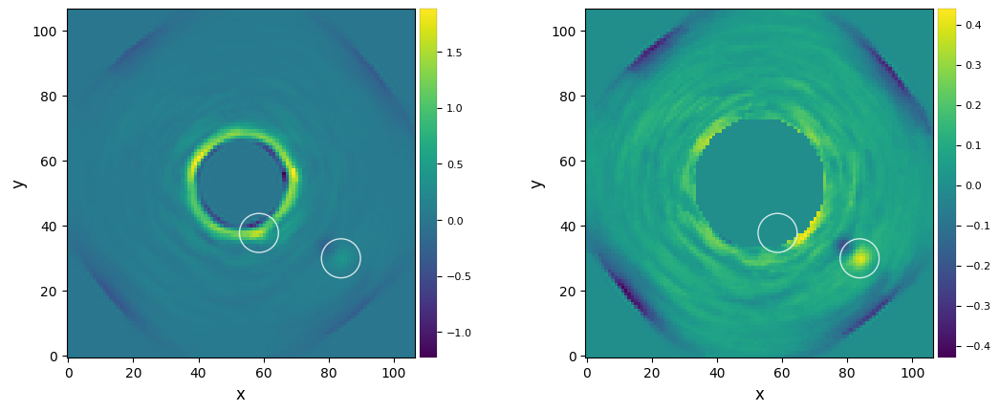

In [40]:
%matplotlib inline
plot_frames((pca_sdi, mask_circle(pca_sdi,20)),
            circle=(xy_b,xy_c))

In the first image, we notice the same effect as with median-SDI: significant stellar residuals at the edge of the coronagraphic mask.

On the other hand, fake planet c is easily re-detected. Notice the negative side lobe, that is reminiscent of ADI side lobes.

<font color=orange> **Question 7.1**: Why is the negative side lobe only radially inward of the planet in our final SDI image? </font>

This time the images obtained without and with flux-scaling applied to the cube before PCA appears to yield similar results. We note that flux scaling may actually have been slightly counter-productive, based on the raw fluxes at the location of the companion (peak value closer to ~0.4 without flux scaling, while closer to ~0.3 with flux scaling). Let's confirm that by measuring the SNR of c:

In [41]:
snr_c = snr(pca_sdi, xy_c, fwhm=np.mean(fwhm), exclude_negative_lobes=True)
print(snr_c)

13.016305973174017


#### 7.5.3.2. Annular PCA

PCA-SDI can also be performed in concentric annuli using `psfsub.pca_annular`. Again let's demonstrate whether flux scaling is useful or not:

In [42]:
ncomp_sdi = 1
mask_px = int(0.1/plsc)
fwhm_m = np.mean(fwhm)

pca_sdi_ann = pca_annular(cube_fc, derot_angles, scale_list=opt_scal_med, 
                          ncomp=(ncomp_sdi,None), radius_int=mask_px, fwhm=fwhm_m, asize=fwhm_m,
                          delta_sep=(0.4, 1), delta_rot=(0.5, 1),
                          mask_val=0, interp_zeros=True)

――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Starting time: 2023-09-04 21:02:08
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
First PCA subtraction exploiting the spectral variability
39 spectral channels per IFS frame
N annuli = 6, mean FWHM = 6.000
Running time:  0:00:53.785225
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
55 ADI frames
Skipping the second PCA subtraction


We mask the central part of the image, dominated by residual stellar light, to only focus on planet c:

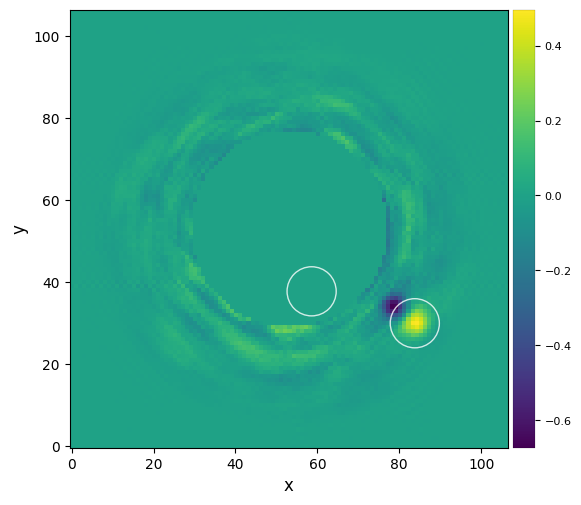

In [43]:
plot_frames(mask_circle(pca_sdi_ann, int(0.18/plsc)), circle=(xy_b,xy_c))

In [44]:
snr_c = snr(pca_sdi_ann, xy_c, fwhm=np.mean(fwhm), exclude_negative_lobes=True)
print(snr_c)

16.07166810409601


Despite both reductions yielding relatively similar final images, we note that flux-scaling is slightly counter-productive (SNR slightly lower), similarly to the full-frame PCA reduction.

### 7.5.4. median-ASDI

Let's now combine both SDI and ADI, which should yield a better subtraction of the stellar residuals. Again, let's start with the most basic way to combine both strategies: median-ASDI. 

This simply involves the same calls to `median_sub` as in Sec. [7.5.2.](#7.5.2.-median-SDI), but removing `sdi_only=True`:

In [45]:
mask_px = int(0.1/plsc)

med_ASDI = median_sub(cube_fc, derot_angles, scale_list=opt_scal_med, flux_sc_list=opt_flux_med,
                      radius_int=mask_px, interp_zeros=True, mask_val=0)

――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Starting time: 2023-09-04 21:03:04
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
39 spectral channels per IFS frame
First median subtraction exploiting spectral variability
Running time:  0:00:18.674228
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
55 ADI frames
Median subtraction in the ADI fashion
Done derotating and combining
Running time:  0:00:21.059474
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――


Let's check the ASDI image:

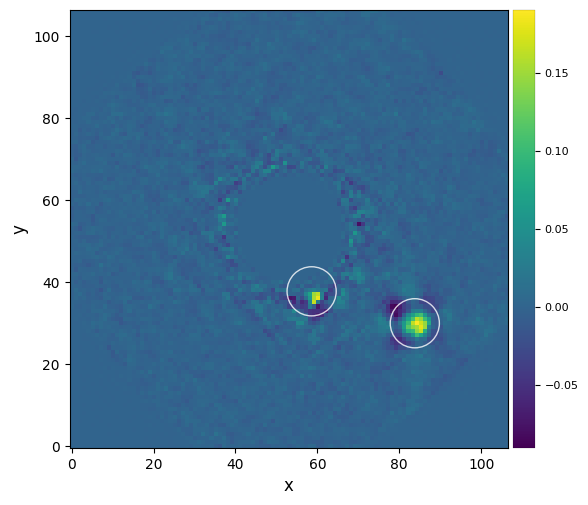

In [46]:
%matplotlib inline
plot_frames(med_ASDI, circle=(xy_b,xy_c))

This time we find signal at the location of fake planet b - although it does appear significantly filtered.

Fake planet c is easily redetected. Let's measure the signal-to-noise ratio for both fake planets:

In [47]:
snr_b = snr(med_SDI, xy_b, fwhm=np.mean(fwhm), exclude_negative_lobes=True)
print(snr_b)

snr_c = snr(med_SDI, xy_c, fwhm=np.mean(fwhm), exclude_negative_lobes=True)
print(snr_c)

0.9096708138344058
19.817929423515157


### 7.5.5. PCA-ASDI

#### 7.5.4.1. Full-frame PCA-ASDI (single step)

The ``psfsub.pca`` function in `VIP` offers the possibility to do this in either a single or 2 consecutive steps. 

In the first case, a master PCA library is created with all images acquired at different parallactic angles and at different wavelengths (i.e. containing both angular and radial diversity). This is done by setting:

- `adimsdi='single'` (default);
- `ncomp` to either a scalar value (integer to use that number of principal components, or float between 0 and 1 to indicate the desired cumulative explained variance ratio), or a list (of integer values to be tested).

Let's try with a list of a few ncomp values:

In [48]:
ncomp = [1,5,10,20]
pca_asdi = pca(cube_fc, derot_angles, scale_list=opt_scal_med, ncomp=ncomp, 
               adimsdi='single', crop_ifs=False, mask_center_px=mask_px) #, imlib='skimage', interpolation='biquintic'

――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Starting time: 2023-09-04 21:03:25
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
System total memory = 17.180 GB
System available memory = 1.068 GB
Rescaling the spectral channels to align the speckles
0% [##############################] 100% | ETA: 00:00:00
Total time elapsed: 00:00:08
Running time:  0:00:09.061561
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
2145 total frames
Performing single-pass PCA
Done SVD/PCA with numpy SVD (LAPACK)
Running time:  0:00:40.950270
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Descaling the spectral channels and obtaining a final frame
Descaling the spectral channels and obtaining a final frame
Descaling the spectral channels and obtaining a final frame
Descaling the spectral channels and obtaining a final frame
Computed residual frames for PCs interval: [1, 5, 10

Let's visualize the resulting image, including circles at the ground truth locations of the injected planets:

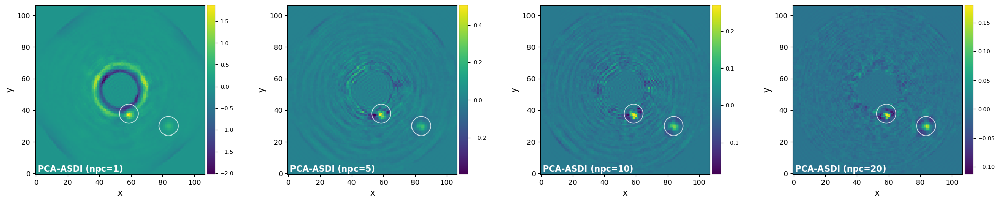

In [49]:
labels = tuple(['PCA-ASDI (npc={:.0f})'.format(npc) for npc in ncomp])
plot_frames(pca_asdi, label=labels,
            dpi=100, colorbar=True, circle=(xy_b,xy_c))

Let's estimate the signal-to-noise ratio of both detections:

In [50]:
snr_b = [snr(pca_asdi[i], xy_b, fwhm=np.mean(fwhm), exclude_negative_lobes=True) for i in range(len(ncomp))]
print(snr_b)

snr_c = [snr(pca_asdi[i], xy_c, fwhm=np.mean(fwhm), exclude_negative_lobes=True) for i in range(len(ncomp))]
print(snr_c)

[1.7049603217379254, 4.833826061829592, 9.580783934031048, 6.046321815480483]
[11.54820357261915, 22.09119795478683, 31.30574019291637, 30.18596315675108]


#### 7.5.4.2. Full-frame PCA-ASDI (double step)

The second option consists in performing PCA-SDI first, and then PCA-ADI on the cube consisting of SDI frames obtained for each individual spectral cube. This mode can be activated by setting `adimsdi='double'` (instead of the default 'single' value).

Given the high correlation in the spectral dimension, let's just try with 1pc for each step:

In [51]:
ncomp = (1,1)
pca_asdi_2s = pca(cube_fc, derot_angles, scale_list=opt_scal_med, ncomp=ncomp, 
                adimsdi='double', crop_ifs=False, mask_center_px=mask_px,
                interp_zeros=True, mask_val=0)

――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Starting time: 2023-09-04 21:04:51
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
System total memory = 17.180 GB
System available memory = 1.163 GB
39 spectral channels in IFS cube
First PCA stage exploiting spectral variability
Running time:  0:00:23.937560
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
55 ADI frames
Second PCA stage exploiting rotational variability
De-rotating and combining residuals
Running time:  0:00:26.471324
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――


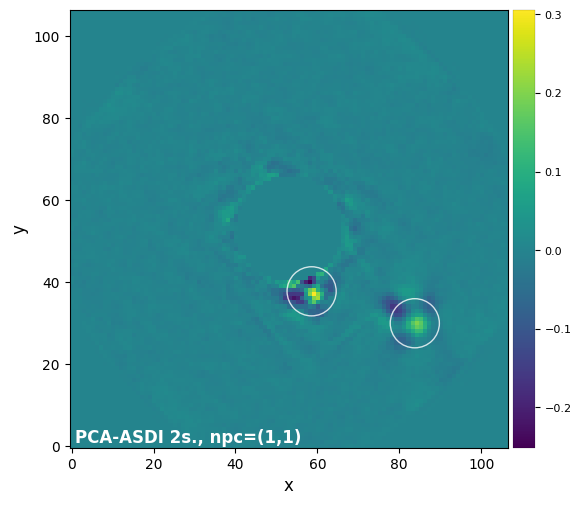

In [52]:
plot_frames(pca_asdi_2s,
            label='PCA-ASDI 2s., npc=({:.0f},{})'.format(ncomp[0],ncomp[1]),
            dpi=100, colorbar=True, circle=(xy_b,xy_c))

Let's estimate the signal-to-noise ratio of both detections:

In [53]:
snr_b = snr(pca_asdi_2s, xy_b, fwhm=np.mean(fwhm), exclude_negative_lobes=True)
print(snr_b)

snr_c = snr(pca_asdi_2s, xy_c, fwhm=np.mean(fwhm), exclude_negative_lobes=True)
print(snr_c)

5.077882384494332
50.36533166315326


We see that with only 1 spectral PC followed by 1 angular PC, parts of the final images can be much cleaner of residual starlight, as also testified by the SNR~50 for injected planet c.

#### 7.5.4.3. Annular PCA-ASDI (double step) 

Similarly, ASDI can be done in concentric annuli with the `pca_annular` function:

In [54]:
ncomp = (1,1)
pca_ann = pca_annular(cube_fc, derot_angles, scale_list=opt_scal_med, ncomp=ncomp, 
                      radius_int=mask_px, fwhm=np.mean(fwhm), asize=np.mean(fwhm), 
                      mask_val=0, interp_zeros=True)

――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Starting time: 2023-09-04 21:05:18
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
First PCA subtraction exploiting the spectral variability
39 spectral channels per IFS frame
N annuli = 6, mean FWHM = 6.000
Running time:  0:01:20.247194
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
55 ADI frames
Second PCA subtraction exploiting the angular variability
N annuli = 6, FWHM = 6.000
PCA per annulus (or annular sectors):
Ann 1    PA thresh:  2.15    Ann center:  16    N segments: 1 
Done PCA with SvdMode.LAPACK for current annulus
Running time:  0:01:20.788793
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Ann 2    PA thresh:  4.36    Ann center:  22    N segments: 1 
Done PCA with SvdMode.LAPACK for current annulus
Running time:  0:01:21.217667
―――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――

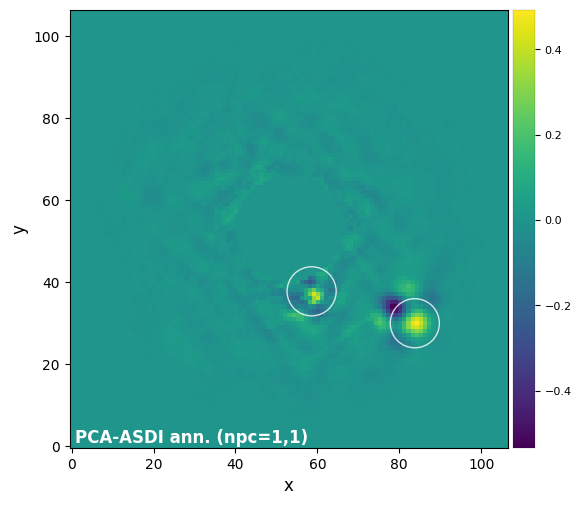

In [55]:
plot_frames(pca_ann, label='PCA-ASDI ann. (npc={:.0f},{:.0f})'.format(ncomp[0], ncomp[1]),
            dpi=100, colorbar=True, circle=(xy_b,xy_c))

Let's estimate the signal-to-noise ratio and signifance of both detections:

In [56]:
snr_b = snr(pca_ann, xy_b, fwhm=np.mean(fwhm), exclude_negative_lobes=True)
print(snr_b)

snr_c = snr(pca_ann, xy_c, fwhm=np.mean(fwhm), exclude_negative_lobes=True)
print(snr_c)

7.4702151169406825
38.30967444041898


In [57]:
sig_b = significance(snr_b, r_b, np.mean(fwhm))
print(sig_b)

sig_c = significance(snr_c, r_c, np.mean(fwhm))
print(sig_c)

4.75314997086797
Warning high S/N! cdf>0.9999999999999999 is rounded to 1
Returning 8.2 sigma, but quote significance > 8.2 sigma.
8.2


### 7.5.6. PCA-ADI for all spectral channels

If you provide a 4d input cube without `scale_list` to the `pca` or `pca_annular` functions, their default behaviour will be to perform PCA-ADI on each spectral channel and then combine the final ADI images from each spectral channel into a single one. 

In [58]:
mask_px = int(0.08/plsc)

Let's try different flavours of PCA. First let's run it in full frames:

In [59]:
ncomp_ff = 6
pca_adi_mean = pca(cube_fc, derot_angles, ncomp=ncomp_ff, mask_center_px=mask_px,
                   interp_zeros=True, mask_val=0)

――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Starting time: 2023-09-04 21:06:43
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
System total memory = 17.180 GB
System available memory = 1.015 GB
Done vectorizing the frames. Matrix shape: (55, 11449)
Done SVD/PCA with numpy SVD (LAPACK)
Running time:  0:00:00.109632
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Done de-rotating and combining
Running time:  0:00:02.487012
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Done vectorizing the frames. Matrix shape: (55, 11449)
Done SVD/PCA with numpy SVD (LAPACK)
Running time:  0:00:02.589139
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Done de-rotating and combining
Running time:  0:00:04.967689
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Done vectorizing the frames. Matrix shape: (55

Done de-rotating and combining
Running time:  0:00:59.597488
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Done vectorizing the frames. Matrix shape: (55, 11449)
Done SVD/PCA with numpy SVD (LAPACK)
Running time:  0:00:59.697966
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Done de-rotating and combining
Running time:  0:01:02.065398
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Done vectorizing the frames. Matrix shape: (55, 11449)
Done SVD/PCA with numpy SVD (LAPACK)
Running time:  0:01:02.167880
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Done de-rotating and combining
Running time:  0:01:04.534925
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Done vectorizing the frames. Matrix shape: (55, 11449)
Done SVD/PCA with numpy SVD (LAPACK)
Running time:  0:01:04.638477
――――――――――――――――――――――――――――――――――――――――――――――

Now in concentric annuli, with a PA threshold (set by `delta_rot`):

In [60]:
ncomp_ann = 4
pca_adi_ann_mean = pca_annular(cube_fc, derot_angles, ncomp=ncomp_ann, radius_int=mask_px, 
                               fwhm=np.mean(fwhm), asize=2*np.mean(fwhm), delta_rot=(0.2,1),
                               mask_val=0, interp_zeros=True)

――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Starting time: 2023-09-04 21:08:20
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
N annuli = 3, FWHM = 6.031
PCA per annulus (or annular sectors):
Ann 1    PA thresh:  4.31    Ann center:  16    N segments: 1 
Done PCA with SvdMode.LAPACK for current annulus
Running time:  0:00:00.565543
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Ann 2    PA thresh:  7.37    Ann center:  28    N segments: 1 
Done PCA with SvdMode.LAPACK for current annulus
Running time:  0:00:01.054694
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Ann 3    PA thresh:  8.81    Ann center:  39    N segments: 1 
Done PCA with SvdMode.LAPACK for current annulus
Running time:  0:00:01.517229
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Done derotating and combining.
Running time:  0:00:03.887719
――――――――

Done PCA with SvdMode.LAPACK for current annulus
Running time:  0:00:35.821030
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Ann 2    PA thresh:  7.37    Ann center:  28    N segments: 1 
Done PCA with SvdMode.LAPACK for current annulus
Running time:  0:00:36.402780
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Ann 3    PA thresh:  8.81    Ann center:  39    N segments: 1 
Done PCA with SvdMode.LAPACK for current annulus
Running time:  0:00:36.865093
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Done derotating and combining.
Running time:  0:00:39.297157
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
N annuli = 3, FWHM = 6.031
PCA per annulus (or annular sectors):
Ann 1    PA thresh:  4.31    Ann center:  16    N segments: 1 
Done PCA with SvdMode.LAPACK for current annulus
Running time:  0:00:39.881205
―――――――――――――――――――――――――――――――――――――――――――――

Done PCA with SvdMode.LAPACK for current annulus
Running time:  0:01:12.042835
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Done derotating and combining.
Running time:  0:01:14.410206
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
N annuli = 3, FWHM = 6.031
PCA per annulus (or annular sectors):
Ann 1    PA thresh:  4.31    Ann center:  16    N segments: 1 
Done PCA with SvdMode.LAPACK for current annulus
Running time:  0:01:14.988657
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Ann 2    PA thresh:  7.37    Ann center:  28    N segments: 1 
Done PCA with SvdMode.LAPACK for current annulus
Running time:  0:01:15.448131
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Ann 3    PA thresh:  8.81    Ann center:  39    N segments: 1 
Done PCA with SvdMode.LAPACK for current annulus
Running time:  0:01:15.880361
―――――――――――――――――――――――――――――――――――――――――――――

Done PCA with SvdMode.LAPACK for current annulus
Running time:  0:01:49.579859
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Ann 2    PA thresh:  7.37    Ann center:  28    N segments: 1 
Done PCA with SvdMode.LAPACK for current annulus
Running time:  0:01:50.101250
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Ann 3    PA thresh:  8.81    Ann center:  39    N segments: 1 
Done PCA with SvdMode.LAPACK for current annulus
Running time:  0:01:50.517896
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Done derotating and combining.
Running time:  0:01:52.889167
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
N annuli = 3, FWHM = 6.031
PCA per annulus (or annular sectors):
Ann 1    PA thresh:  4.31    Ann center:  16    N segments: 1 
Done PCA with SvdMode.LAPACK for current annulus
Running time:  0:01:53.510397
―――――――――――――――――――――――――――――――――――――――――――――

Done PCA with SvdMode.LAPACK for current annulus
Running time:  0:02:25.052289
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Done derotating and combining.
Running time:  0:02:27.416946
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
N annuli = 3, FWHM = 6.031
PCA per annulus (or annular sectors):
Ann 1    PA thresh:  4.31    Ann center:  16    N segments: 1 
Done PCA with SvdMode.LAPACK for current annulus
Running time:  0:02:28.011655
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Ann 2    PA thresh:  7.37    Ann center:  28    N segments: 1 
Done PCA with SvdMode.LAPACK for current annulus
Running time:  0:02:28.470096
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Ann 3    PA thresh:  8.81    Ann center:  39    N segments: 1 
Done PCA with SvdMode.LAPACK for current annulus
Running time:  0:02:28.911330
―――――――――――――――――――――――――――――――――――――――――――――

Finally, let's also run it as a single wide annulus including both injected planets:

In [61]:
ncomp_a = 3
pca_adi_a_mean = pca_annulus(cube_fc, derot_angles, ncomp=ncomp_a, r_guess=(r_b+r_c)/2, 
                           annulus_width=r_c, mask_val=0, interp_zeros=True)

Let's compare the results:

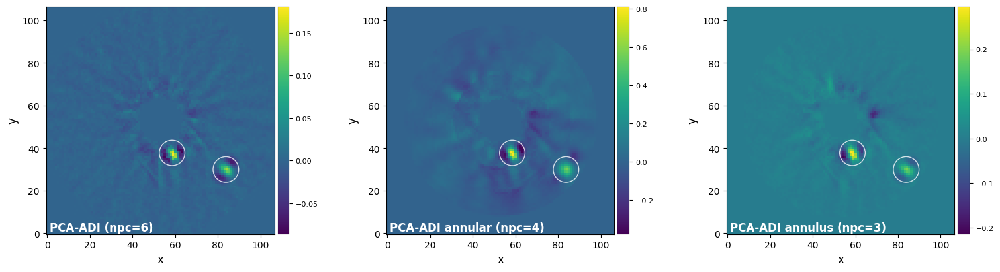

In [62]:
plot_frames((pca_adi_mean, pca_adi_ann_mean, pca_adi_a_mean),
            label=('PCA-ADI (npc={:.0f})'.format(ncomp_ff),
                   'PCA-ADI annular (npc={:.0f})'.format(ncomp_ann),
                   'PCA-ADI annulus (npc={:.0f})'.format(ncomp_a)),
            dpi=100, colorbar=True, circle=(xy_b,xy_c))

Let's estimate the signal-to-noise ratio and signifance of both detections:

In [63]:
snr_b_ff = snr(pca_adi_mean, xy_b, fwhm=np.mean(fwhm), exclude_negative_lobes=True)
snr_b_ann = snr(pca_adi_ann_mean, xy_b, fwhm=np.mean(fwhm), exclude_negative_lobes=True)
snr_b_a = snr(pca_adi_a_mean, xy_b, fwhm=np.mean(fwhm), exclude_negative_lobes=True)
print(snr_b_ff, snr_b_ann, snr_b_a)
snr_b = max(snr_b_ff, snr_b_ann, snr_b_a)

snr_c_ff = snr(pca_adi_mean, xy_c, fwhm=np.mean(fwhm), exclude_negative_lobes=True)
snr_c_ann = snr(pca_adi_ann_mean, xy_c, fwhm=np.mean(fwhm), exclude_negative_lobes=True)
snr_c_a = snr(pca_adi_a_mean, xy_c, fwhm=np.mean(fwhm), exclude_negative_lobes=True)
print(snr_c_ff, snr_c_ann, snr_c_a)
snr_c = max(snr_c_ff, snr_c_ann, snr_c_a)

9.935243599527908 6.209986724918728 4.704459026815971
31.48109617062875 11.398186426969303 24.70475296809838


In [64]:
sig_b = significance(snr_b, r_b, np.mean(fwhm))
print(sig_b)

sig_c = significance(snr_c, r_c, np.mean(fwhm))
print(sig_c)

5.433364722813859
Warning high S/N! cdf>0.9999999999999999 is rounded to 1
Returning 8.2 sigma, but quote significance > 8.2 sigma.
8.2


In this case, we see that ADI alone recovers better the innermost planet. This is because of the bright stellar residuals at the edge of the coronagraphic mask, preventing SDI to do a good job at good separation.

<font color=green> **Answer 7.1**: The scaling factors are such that all spectral channels are upscaled, for the stellar halo to match the last spectral channel, i.e. all factors are >= 1 (exactly 1 for the last spectral channel). The PSF model and subtraction with PCA is then made with these upscaled images, where the planet is now present at different radial separations. However since we injected a very red spectrum for planet c (blackbody of 1100 K), it is the brightest in the last spectral channels. This means the strongest positive (resp. negative) imprint will be in the long (resp. short) wavelength channels, where the planet was not moved (resp. moved radially outward), i.e. the positive (resp. negative) imprint is unchanged (resp. radially inward) with respect to its position in the upscaled cube. After final downscaling, the negative imprint stays thus radially inward from the location of the fake planet. 
You can test this explanation by injecting a blue spectrum for planet c (e.g. 1/blackbody). </font>

## 7.6. Astrometry retrieval

The `firstguess` function can accept a 4D input cube to infer a first guess on the position (a single one for all channels) and fluxes (one per channel). Since it would be very slow to run it on all 39 spectral channels, let's just focus on the 8 channels (~20% of all channels) with the maximum S/N ratio. Let's find these channels for planet c. 

As the rest of this tutorial is CPU-intensive, **we will only focus on planet c** - although the same procedure can be applied to planet b.

### 7.6.1. Spectral channels with maximum SNR

――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Starting time: 2023-09-04 21:12:26
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Done SVD/PCA with numpy SVD (LAPACK)
Running time:  0:00:00.063201
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Number of steps 11
Optimal number of PCs = 1, for S/N=1.380
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Coords of chosen px (X,Y) = 83.8, 29.9
Flux in a centered 1xFWHM circular aperture = 0.213
Central pixel S/N = 1.124
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Inside a centered 1xFWHM circular aperture:
Mean S/N (shifting the aperture center) = 1.375
Max S/N (shifting the aperture center) = 2.200
stddev S/N (shifting the aperture center) = 0.565

Opt SNR: 1.3801916275528059, for npc=1
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Starti

/var/folders/c8/p96qsd5x0bzcl1g1w145r9z40000gn/T/ipykernel_61319/3203288616.py:13: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  print("Opt SNR: {}, for npc={}".format(float(opt_snr), opt_npc_ann))
/var/folders/c8/p96qsd5x0bzcl1g1w145r9z40000gn/T/ipykernel_61319/3203288616.py:14: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  all_snrs.append(float(opt_snr))


Number of steps 11
Optimal number of PCs = 1, for S/N=3.570
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Coords of chosen px (X,Y) = 83.8, 29.9
Flux in a centered 1xFWHM circular aperture = 1.134
Central pixel S/N = 4.537
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Inside a centered 1xFWHM circular aperture:
Mean S/N (shifting the aperture center) = 3.582
Max S/N (shifting the aperture center) = 4.669
stddev S/N (shifting the aperture center) = 0.761

Opt SNR: 3.569572865199436, for npc=1
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Starting time: 2023-09-04 21:12:28
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Done SVD/PCA with numpy SVD (LAPACK)
Running time:  0:00:00.060323
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――


/var/folders/c8/p96qsd5x0bzcl1g1w145r9z40000gn/T/ipykernel_61319/3203288616.py:13: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  print("Opt SNR: {}, for npc={}".format(float(opt_snr), opt_npc_ann))
/var/folders/c8/p96qsd5x0bzcl1g1w145r9z40000gn/T/ipykernel_61319/3203288616.py:14: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  all_snrs.append(float(opt_snr))


Number of steps 11
Optimal number of PCs = 1, for S/N=3.384
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Coords of chosen px (X,Y) = 83.8, 29.9
Flux in a centered 1xFWHM circular aperture = 1.378
Central pixel S/N = 3.798
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Inside a centered 1xFWHM circular aperture:
Mean S/N (shifting the aperture center) = 3.380
Max S/N (shifting the aperture center) = 4.865
stddev S/N (shifting the aperture center) = 0.671

Opt SNR: 3.3843922448871435, for npc=1
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Starting time: 2023-09-04 21:12:29
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Done SVD/PCA with numpy SVD (LAPACK)
Running time:  0:00:00.063833
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――


/var/folders/c8/p96qsd5x0bzcl1g1w145r9z40000gn/T/ipykernel_61319/3203288616.py:13: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  print("Opt SNR: {}, for npc={}".format(float(opt_snr), opt_npc_ann))
/var/folders/c8/p96qsd5x0bzcl1g1w145r9z40000gn/T/ipykernel_61319/3203288616.py:14: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  all_snrs.append(float(opt_snr))


Number of steps 11
Optimal number of PCs = 1, for S/N=3.538
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Coords of chosen px (X,Y) = 83.8, 29.9
Flux in a centered 1xFWHM circular aperture = 1.718
Central pixel S/N = 4.374
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Inside a centered 1xFWHM circular aperture:
Mean S/N (shifting the aperture center) = 3.554
Max S/N (shifting the aperture center) = 4.297
stddev S/N (shifting the aperture center) = 0.503

Opt SNR: 3.5377834729055544, for npc=1
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Starting time: 2023-09-04 21:12:30
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Done SVD/PCA with numpy SVD (LAPACK)
Running time:  0:00:00.055171
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――


/var/folders/c8/p96qsd5x0bzcl1g1w145r9z40000gn/T/ipykernel_61319/3203288616.py:13: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  print("Opt SNR: {}, for npc={}".format(float(opt_snr), opt_npc_ann))
/var/folders/c8/p96qsd5x0bzcl1g1w145r9z40000gn/T/ipykernel_61319/3203288616.py:14: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  all_snrs.append(float(opt_snr))


Number of steps 11
Optimal number of PCs = 1, for S/N=3.486
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Coords of chosen px (X,Y) = 83.8, 29.9
Flux in a centered 1xFWHM circular aperture = 1.989
Central pixel S/N = 4.425
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Inside a centered 1xFWHM circular aperture:
Mean S/N (shifting the aperture center) = 3.488
Max S/N (shifting the aperture center) = 4.297
stddev S/N (shifting the aperture center) = 0.507

Opt SNR: 3.4860830354309655, for npc=1
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Starting time: 2023-09-04 21:12:31
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Done SVD/PCA with numpy SVD (LAPACK)
Running time:  0:00:00.051167
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――


/var/folders/c8/p96qsd5x0bzcl1g1w145r9z40000gn/T/ipykernel_61319/3203288616.py:13: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  print("Opt SNR: {}, for npc={}".format(float(opt_snr), opt_npc_ann))
/var/folders/c8/p96qsd5x0bzcl1g1w145r9z40000gn/T/ipykernel_61319/3203288616.py:14: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  all_snrs.append(float(opt_snr))


Number of steps 11
Optimal number of PCs = 1, for S/N=3.913
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Coords of chosen px (X,Y) = 83.8, 29.9
Flux in a centered 1xFWHM circular aperture = 2.236
Central pixel S/N = 4.852
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Inside a centered 1xFWHM circular aperture:
Mean S/N (shifting the aperture center) = 3.906
Max S/N (shifting the aperture center) = 4.805
stddev S/N (shifting the aperture center) = 0.594

Opt SNR: 3.9129844764200956, for npc=1
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Starting time: 2023-09-04 21:12:32
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Done SVD/PCA with numpy SVD (LAPACK)
Running time:  0:00:00.055181
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――


/var/folders/c8/p96qsd5x0bzcl1g1w145r9z40000gn/T/ipykernel_61319/3203288616.py:13: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  print("Opt SNR: {}, for npc={}".format(float(opt_snr), opt_npc_ann))
/var/folders/c8/p96qsd5x0bzcl1g1w145r9z40000gn/T/ipykernel_61319/3203288616.py:14: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  all_snrs.append(float(opt_snr))


Number of steps 11
Optimal number of PCs = 1, for S/N=3.632
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Coords of chosen px (X,Y) = 83.8, 29.9
Flux in a centered 1xFWHM circular aperture = 2.046
Central pixel S/N = 4.416
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Inside a centered 1xFWHM circular aperture:
Mean S/N (shifting the aperture center) = 3.601
Max S/N (shifting the aperture center) = 4.576
stddev S/N (shifting the aperture center) = 0.568

Opt SNR: 3.6323039929489287, for npc=1
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Starting time: 2023-09-04 21:12:33
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Done SVD/PCA with numpy SVD (LAPACK)
Running time:  0:00:00.053231
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――


/var/folders/c8/p96qsd5x0bzcl1g1w145r9z40000gn/T/ipykernel_61319/3203288616.py:13: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  print("Opt SNR: {}, for npc={}".format(float(opt_snr), opt_npc_ann))
/var/folders/c8/p96qsd5x0bzcl1g1w145r9z40000gn/T/ipykernel_61319/3203288616.py:14: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  all_snrs.append(float(opt_snr))


Number of steps 11
Optimal number of PCs = 1, for S/N=4.143
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Coords of chosen px (X,Y) = 83.8, 29.9
Flux in a centered 1xFWHM circular aperture = 2.449
Central pixel S/N = 5.386
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Inside a centered 1xFWHM circular aperture:
Mean S/N (shifting the aperture center) = 4.148
Max S/N (shifting the aperture center) = 5.303
stddev S/N (shifting the aperture center) = 0.670

Opt SNR: 4.143193729826148, for npc=1
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Starting time: 2023-09-04 21:12:34
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Done SVD/PCA with numpy SVD (LAPACK)
Running time:  0:00:00.056147
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――


/var/folders/c8/p96qsd5x0bzcl1g1w145r9z40000gn/T/ipykernel_61319/3203288616.py:13: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  print("Opt SNR: {}, for npc={}".format(float(opt_snr), opt_npc_ann))
/var/folders/c8/p96qsd5x0bzcl1g1w145r9z40000gn/T/ipykernel_61319/3203288616.py:14: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  all_snrs.append(float(opt_snr))


Number of steps 11
Optimal number of PCs = 1, for S/N=4.457
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Coords of chosen px (X,Y) = 83.8, 29.9
Flux in a centered 1xFWHM circular aperture = 2.664
Central pixel S/N = 5.837
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Inside a centered 1xFWHM circular aperture:
Mean S/N (shifting the aperture center) = 4.441
Max S/N (shifting the aperture center) = 5.895
stddev S/N (shifting the aperture center) = 0.880

Opt SNR: 4.457385421253395, for npc=1
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Starting time: 2023-09-04 21:12:35
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Done SVD/PCA with numpy SVD (LAPACK)
Running time:  0:00:00.053414
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――


/var/folders/c8/p96qsd5x0bzcl1g1w145r9z40000gn/T/ipykernel_61319/3203288616.py:13: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  print("Opt SNR: {}, for npc={}".format(float(opt_snr), opt_npc_ann))
/var/folders/c8/p96qsd5x0bzcl1g1w145r9z40000gn/T/ipykernel_61319/3203288616.py:14: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  all_snrs.append(float(opt_snr))


Number of steps 11
Optimal number of PCs = 1, for S/N=4.096
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Coords of chosen px (X,Y) = 83.8, 29.9
Flux in a centered 1xFWHM circular aperture = 2.551
Central pixel S/N = 5.117
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Inside a centered 1xFWHM circular aperture:
Mean S/N (shifting the aperture center) = 4.025
Max S/N (shifting the aperture center) = 5.454
stddev S/N (shifting the aperture center) = 0.851

Opt SNR: 4.095758083355251, for npc=1
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Starting time: 2023-09-04 21:12:36
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Done SVD/PCA with numpy SVD (LAPACK)
Running time:  0:00:00.061273
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――


/var/folders/c8/p96qsd5x0bzcl1g1w145r9z40000gn/T/ipykernel_61319/3203288616.py:13: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  print("Opt SNR: {}, for npc={}".format(float(opt_snr), opt_npc_ann))
/var/folders/c8/p96qsd5x0bzcl1g1w145r9z40000gn/T/ipykernel_61319/3203288616.py:14: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  all_snrs.append(float(opt_snr))


Number of steps 11
Optimal number of PCs = 1, for S/N=4.282
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Coords of chosen px (X,Y) = 83.8, 29.9
Flux in a centered 1xFWHM circular aperture = 3.074
Central pixel S/N = 5.362
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Inside a centered 1xFWHM circular aperture:
Mean S/N (shifting the aperture center) = 4.252
Max S/N (shifting the aperture center) = 5.566
stddev S/N (shifting the aperture center) = 0.937

Opt SNR: 4.281749743702011, for npc=1
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Starting time: 2023-09-04 21:12:37
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Done SVD/PCA with numpy SVD (LAPACK)
Running time:  0:00:00.068576
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――


/var/folders/c8/p96qsd5x0bzcl1g1w145r9z40000gn/T/ipykernel_61319/3203288616.py:13: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  print("Opt SNR: {}, for npc={}".format(float(opt_snr), opt_npc_ann))
/var/folders/c8/p96qsd5x0bzcl1g1w145r9z40000gn/T/ipykernel_61319/3203288616.py:14: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  all_snrs.append(float(opt_snr))


Number of steps 11
Optimal number of PCs = 4, for S/N=4.445
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Coords of chosen px (X,Y) = 83.8, 29.9
Flux in a centered 1xFWHM circular aperture = 0.997
Central pixel S/N = 5.858
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Inside a centered 1xFWHM circular aperture:
Mean S/N (shifting the aperture center) = 4.115
Max S/N (shifting the aperture center) = 6.379
stddev S/N (shifting the aperture center) = 1.112

Opt SNR: 4.444589215208261, for npc=4
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Starting time: 2023-09-04 21:12:38
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Done SVD/PCA with numpy SVD (LAPACK)
Running time:  0:00:00.056332
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――


/var/folders/c8/p96qsd5x0bzcl1g1w145r9z40000gn/T/ipykernel_61319/3203288616.py:13: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  print("Opt SNR: {}, for npc={}".format(float(opt_snr), opt_npc_ann))
/var/folders/c8/p96qsd5x0bzcl1g1w145r9z40000gn/T/ipykernel_61319/3203288616.py:14: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  all_snrs.append(float(opt_snr))


Number of steps 11
Optimal number of PCs = 5, for S/N=5.324
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Coords of chosen px (X,Y) = 83.8, 29.9
Flux in a centered 1xFWHM circular aperture = 0.983
Central pixel S/N = 6.557
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Inside a centered 1xFWHM circular aperture:
Mean S/N (shifting the aperture center) = 4.820
Max S/N (shifting the aperture center) = 7.051
stddev S/N (shifting the aperture center) = 1.409

Opt SNR: 5.323671172061005, for npc=5
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Starting time: 2023-09-04 21:12:39
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Done SVD/PCA with numpy SVD (LAPACK)
Running time:  0:00:00.055294
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――


/var/folders/c8/p96qsd5x0bzcl1g1w145r9z40000gn/T/ipykernel_61319/3203288616.py:13: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  print("Opt SNR: {}, for npc={}".format(float(opt_snr), opt_npc_ann))
/var/folders/c8/p96qsd5x0bzcl1g1w145r9z40000gn/T/ipykernel_61319/3203288616.py:14: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  all_snrs.append(float(opt_snr))


Number of steps 11
Optimal number of PCs = 4, for S/N=6.188
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Coords of chosen px (X,Y) = 83.8, 29.9
Flux in a centered 1xFWHM circular aperture = 1.252
Central pixel S/N = 7.141
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Inside a centered 1xFWHM circular aperture:
Mean S/N (shifting the aperture center) = 5.329
Max S/N (shifting the aperture center) = 7.451
stddev S/N (shifting the aperture center) = 1.474

Opt SNR: 6.1879143028055115, for npc=4
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Starting time: 2023-09-04 21:12:40
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Done SVD/PCA with numpy SVD (LAPACK)
Running time:  0:00:00.056033
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――


/var/folders/c8/p96qsd5x0bzcl1g1w145r9z40000gn/T/ipykernel_61319/3203288616.py:13: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  print("Opt SNR: {}, for npc={}".format(float(opt_snr), opt_npc_ann))
/var/folders/c8/p96qsd5x0bzcl1g1w145r9z40000gn/T/ipykernel_61319/3203288616.py:14: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  all_snrs.append(float(opt_snr))


Number of steps 11
Optimal number of PCs = 6, for S/N=6.063
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Coords of chosen px (X,Y) = 83.8, 29.9
Flux in a centered 1xFWHM circular aperture = 1.062
Central pixel S/N = 7.120
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Inside a centered 1xFWHM circular aperture:
Mean S/N (shifting the aperture center) = 5.028
Max S/N (shifting the aperture center) = 7.533
stddev S/N (shifting the aperture center) = 1.633

Opt SNR: 6.063078806745727, for npc=6
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Starting time: 2023-09-04 21:12:41
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Done SVD/PCA with numpy SVD (LAPACK)
Running time:  0:00:00.054174
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――


/var/folders/c8/p96qsd5x0bzcl1g1w145r9z40000gn/T/ipykernel_61319/3203288616.py:13: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  print("Opt SNR: {}, for npc={}".format(float(opt_snr), opt_npc_ann))
/var/folders/c8/p96qsd5x0bzcl1g1w145r9z40000gn/T/ipykernel_61319/3203288616.py:14: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  all_snrs.append(float(opt_snr))


Number of steps 11
Optimal number of PCs = 7, for S/N=7.297
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Coords of chosen px (X,Y) = 83.8, 29.9
Flux in a centered 1xFWHM circular aperture = 1.233
Central pixel S/N = 8.846
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Inside a centered 1xFWHM circular aperture:
Mean S/N (shifting the aperture center) = 6.376
Max S/N (shifting the aperture center) = 9.764
stddev S/N (shifting the aperture center) = 1.999

Opt SNR: 7.297307899668932, for npc=7
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Starting time: 2023-09-04 21:12:42
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Done SVD/PCA with numpy SVD (LAPACK)
Running time:  0:00:00.059603
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――


/var/folders/c8/p96qsd5x0bzcl1g1w145r9z40000gn/T/ipykernel_61319/3203288616.py:13: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  print("Opt SNR: {}, for npc={}".format(float(opt_snr), opt_npc_ann))
/var/folders/c8/p96qsd5x0bzcl1g1w145r9z40000gn/T/ipykernel_61319/3203288616.py:14: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  all_snrs.append(float(opt_snr))


Number of steps 11
Optimal number of PCs = 1, for S/N=5.542
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Coords of chosen px (X,Y) = 83.8, 29.9
Flux in a centered 1xFWHM circular aperture = 2.950
Central pixel S/N = 7.021
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Inside a centered 1xFWHM circular aperture:
Mean S/N (shifting the aperture center) = 5.521
Max S/N (shifting the aperture center) = 8.210
stddev S/N (shifting the aperture center) = 1.461

Opt SNR: 5.542426844570617, for npc=1
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Starting time: 2023-09-04 21:12:43
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Done SVD/PCA with numpy SVD (LAPACK)
Running time:  0:00:00.056368
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――


/var/folders/c8/p96qsd5x0bzcl1g1w145r9z40000gn/T/ipykernel_61319/3203288616.py:13: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  print("Opt SNR: {}, for npc={}".format(float(opt_snr), opt_npc_ann))
/var/folders/c8/p96qsd5x0bzcl1g1w145r9z40000gn/T/ipykernel_61319/3203288616.py:14: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  all_snrs.append(float(opt_snr))


Number of steps 11
Optimal number of PCs = 1, for S/N=4.976
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Coords of chosen px (X,Y) = 83.8, 29.9
Flux in a centered 1xFWHM circular aperture = 2.305
Central pixel S/N = 5.791
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Inside a centered 1xFWHM circular aperture:
Mean S/N (shifting the aperture center) = 5.041
Max S/N (shifting the aperture center) = 7.733
stddev S/N (shifting the aperture center) = 1.357

Opt SNR: 4.976408389408834, for npc=1
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Starting time: 2023-09-04 21:12:44
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Done SVD/PCA with numpy SVD (LAPACK)
Running time:  0:00:00.052429
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――


/var/folders/c8/p96qsd5x0bzcl1g1w145r9z40000gn/T/ipykernel_61319/3203288616.py:13: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  print("Opt SNR: {}, for npc={}".format(float(opt_snr), opt_npc_ann))
/var/folders/c8/p96qsd5x0bzcl1g1w145r9z40000gn/T/ipykernel_61319/3203288616.py:14: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  all_snrs.append(float(opt_snr))


Number of steps 11
Optimal number of PCs = 1, for S/N=4.888
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Coords of chosen px (X,Y) = 83.8, 29.9
Flux in a centered 1xFWHM circular aperture = 2.248
Central pixel S/N = 6.085
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Inside a centered 1xFWHM circular aperture:
Mean S/N (shifting the aperture center) = 4.908
Max S/N (shifting the aperture center) = 7.287
stddev S/N (shifting the aperture center) = 1.327

Opt SNR: 4.887618306863193, for npc=1
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Starting time: 2023-09-04 21:12:45
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Done SVD/PCA with numpy SVD (LAPACK)
Running time:  0:00:00.059746
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――


/var/folders/c8/p96qsd5x0bzcl1g1w145r9z40000gn/T/ipykernel_61319/3203288616.py:13: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  print("Opt SNR: {}, for npc={}".format(float(opt_snr), opt_npc_ann))
/var/folders/c8/p96qsd5x0bzcl1g1w145r9z40000gn/T/ipykernel_61319/3203288616.py:14: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  all_snrs.append(float(opt_snr))


Number of steps 11
Optimal number of PCs = 2, for S/N=6.132
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Coords of chosen px (X,Y) = 83.8, 29.9
Flux in a centered 1xFWHM circular aperture = 1.768
Central pixel S/N = 8.101
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Inside a centered 1xFWHM circular aperture:
Mean S/N (shifting the aperture center) = 5.968
Max S/N (shifting the aperture center) = 8.960
stddev S/N (shifting the aperture center) = 1.641

Opt SNR: 6.131787040588891, for npc=2
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Starting time: 2023-09-04 21:12:46
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Done SVD/PCA with numpy SVD (LAPACK)
Running time:  0:00:00.056514
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――


/var/folders/c8/p96qsd5x0bzcl1g1w145r9z40000gn/T/ipykernel_61319/3203288616.py:13: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  print("Opt SNR: {}, for npc={}".format(float(opt_snr), opt_npc_ann))
/var/folders/c8/p96qsd5x0bzcl1g1w145r9z40000gn/T/ipykernel_61319/3203288616.py:14: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  all_snrs.append(float(opt_snr))


Number of steps 11
Optimal number of PCs = 3, for S/N=7.050
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Coords of chosen px (X,Y) = 83.8, 29.9
Flux in a centered 1xFWHM circular aperture = 1.945
Central pixel S/N = 8.241
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Inside a centered 1xFWHM circular aperture:
Mean S/N (shifting the aperture center) = 6.651
Max S/N (shifting the aperture center) = 9.537
stddev S/N (shifting the aperture center) = 1.668

Opt SNR: 7.05004660935525, for npc=3
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Starting time: 2023-09-04 21:12:47
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Done SVD/PCA with numpy SVD (LAPACK)
Running time:  0:00:00.063795
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――


/Users/valentin/GitHub/VIP/vip_hci/psfsub/utils_pca.py:383: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  plt.figure(figsize=vip_figsize, dpi=vip_figdpi)
/var/folders/c8/p96qsd5x0bzcl1g1w145r9z40000gn/T/ipykernel_61319/3203288616.py:13: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  print("Opt SNR: {}, for npc={}".format(float(opt_snr), opt_npc_ann))
/var/folders/c8/p96qsd5x0bzcl1g1w145r9z40000gn/T/ipykernel_61319/3203288616.py:14: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  all_snrs.append(float(opt_snr))


Number of steps 11
Optimal number of PCs = 3, for S/N=8.520
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Coords of chosen px (X,Y) = 83.8, 29.9
Flux in a centered 1xFWHM circular aperture = 2.583
Central pixel S/N = 9.774
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Inside a centered 1xFWHM circular aperture:
Mean S/N (shifting the aperture center) = 7.872
Max S/N (shifting the aperture center) = 12.441
stddev S/N (shifting the aperture center) = 2.382

Opt SNR: 8.51991694741128, for npc=3
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Starting time: 2023-09-04 21:12:48
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Done SVD/PCA with numpy SVD (LAPACK)
Running time:  0:00:00.074798
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――


/var/folders/c8/p96qsd5x0bzcl1g1w145r9z40000gn/T/ipykernel_61319/3203288616.py:13: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  print("Opt SNR: {}, for npc={}".format(float(opt_snr), opt_npc_ann))
/var/folders/c8/p96qsd5x0bzcl1g1w145r9z40000gn/T/ipykernel_61319/3203288616.py:14: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  all_snrs.append(float(opt_snr))


Number of steps 11
Optimal number of PCs = 4, for S/N=10.523
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Coords of chosen px (X,Y) = 83.8, 29.9
Flux in a centered 1xFWHM circular aperture = 2.150
Central pixel S/N = 12.074
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Inside a centered 1xFWHM circular aperture:
Mean S/N (shifting the aperture center) = 8.799
Max S/N (shifting the aperture center) = 12.193
stddev S/N (shifting the aperture center) = 2.371

Opt SNR: 10.522543185354458, for npc=4
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Starting time: 2023-09-04 21:12:49
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Done SVD/PCA with numpy SVD (LAPACK)
Running time:  0:00:00.060967
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――


/var/folders/c8/p96qsd5x0bzcl1g1w145r9z40000gn/T/ipykernel_61319/3203288616.py:13: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  print("Opt SNR: {}, for npc={}".format(float(opt_snr), opt_npc_ann))
/var/folders/c8/p96qsd5x0bzcl1g1w145r9z40000gn/T/ipykernel_61319/3203288616.py:14: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  all_snrs.append(float(opt_snr))


Number of steps 11
Optimal number of PCs = 4, for S/N=10.808
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Coords of chosen px (X,Y) = 83.8, 29.9
Flux in a centered 1xFWHM circular aperture = 2.420
Central pixel S/N = 12.540
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Inside a centered 1xFWHM circular aperture:
Mean S/N (shifting the aperture center) = 8.680
Max S/N (shifting the aperture center) = 12.377
stddev S/N (shifting the aperture center) = 2.430

Opt SNR: 10.8078900868622, for npc=4
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Starting time: 2023-09-04 21:12:50
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Done SVD/PCA with numpy SVD (LAPACK)
Running time:  0:00:00.059664
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――


/var/folders/c8/p96qsd5x0bzcl1g1w145r9z40000gn/T/ipykernel_61319/3203288616.py:13: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  print("Opt SNR: {}, for npc={}".format(float(opt_snr), opt_npc_ann))
/var/folders/c8/p96qsd5x0bzcl1g1w145r9z40000gn/T/ipykernel_61319/3203288616.py:14: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  all_snrs.append(float(opt_snr))


Number of steps 11
Optimal number of PCs = 4, for S/N=13.470
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Coords of chosen px (X,Y) = 83.8, 29.9
Flux in a centered 1xFWHM circular aperture = 2.973
Central pixel S/N = 13.874
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Inside a centered 1xFWHM circular aperture:
Mean S/N (shifting the aperture center) = 10.462
Max S/N (shifting the aperture center) = 14.511
stddev S/N (shifting the aperture center) = 2.743

Opt SNR: 13.469995229225095, for npc=4
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Starting time: 2023-09-04 21:12:51
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Done SVD/PCA with numpy SVD (LAPACK)
Running time:  0:00:00.137803
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――


/var/folders/c8/p96qsd5x0bzcl1g1w145r9z40000gn/T/ipykernel_61319/3203288616.py:13: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  print("Opt SNR: {}, for npc={}".format(float(opt_snr), opt_npc_ann))
/var/folders/c8/p96qsd5x0bzcl1g1w145r9z40000gn/T/ipykernel_61319/3203288616.py:14: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  all_snrs.append(float(opt_snr))


Number of steps 11
Optimal number of PCs = 5, for S/N=11.545
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Coords of chosen px (X,Y) = 83.8, 29.9
Flux in a centered 1xFWHM circular aperture = 2.677
Central pixel S/N = 13.461
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Inside a centered 1xFWHM circular aperture:
Mean S/N (shifting the aperture center) = 8.936
Max S/N (shifting the aperture center) = 13.917
stddev S/N (shifting the aperture center) = 3.185

Opt SNR: 11.54528352825929, for npc=5
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Starting time: 2023-09-04 21:12:53
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Done SVD/PCA with numpy SVD (LAPACK)
Running time:  0:00:00.055683
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――


/var/folders/c8/p96qsd5x0bzcl1g1w145r9z40000gn/T/ipykernel_61319/3203288616.py:13: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  print("Opt SNR: {}, for npc={}".format(float(opt_snr), opt_npc_ann))
/var/folders/c8/p96qsd5x0bzcl1g1w145r9z40000gn/T/ipykernel_61319/3203288616.py:14: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  all_snrs.append(float(opt_snr))


Number of steps 11
Optimal number of PCs = 5, for S/N=12.399
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Coords of chosen px (X,Y) = 83.8, 29.9
Flux in a centered 1xFWHM circular aperture = 2.907
Central pixel S/N = 14.168
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Inside a centered 1xFWHM circular aperture:
Mean S/N (shifting the aperture center) = 9.529
Max S/N (shifting the aperture center) = 14.563
stddev S/N (shifting the aperture center) = 3.334

Opt SNR: 12.399403452618305, for npc=5
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Starting time: 2023-09-04 21:12:54
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Done SVD/PCA with numpy SVD (LAPACK)
Running time:  0:00:00.067853
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――


/var/folders/c8/p96qsd5x0bzcl1g1w145r9z40000gn/T/ipykernel_61319/3203288616.py:13: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  print("Opt SNR: {}, for npc={}".format(float(opt_snr), opt_npc_ann))
/var/folders/c8/p96qsd5x0bzcl1g1w145r9z40000gn/T/ipykernel_61319/3203288616.py:14: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  all_snrs.append(float(opt_snr))


Number of steps 11
Optimal number of PCs = 5, for S/N=14.401
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Coords of chosen px (X,Y) = 83.8, 29.9
Flux in a centered 1xFWHM circular aperture = 3.256
Central pixel S/N = 14.394
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Inside a centered 1xFWHM circular aperture:
Mean S/N (shifting the aperture center) = 10.335
Max S/N (shifting the aperture center) = 16.271
stddev S/N (shifting the aperture center) = 3.354

Opt SNR: 14.400880849221048, for npc=5
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Starting time: 2023-09-04 21:12:55
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Done SVD/PCA with numpy SVD (LAPACK)
Running time:  0:00:00.059053
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――


/var/folders/c8/p96qsd5x0bzcl1g1w145r9z40000gn/T/ipykernel_61319/3203288616.py:13: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  print("Opt SNR: {}, for npc={}".format(float(opt_snr), opt_npc_ann))
/var/folders/c8/p96qsd5x0bzcl1g1w145r9z40000gn/T/ipykernel_61319/3203288616.py:14: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  all_snrs.append(float(opt_snr))


Number of steps 11
Optimal number of PCs = 5, for S/N=15.905
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Coords of chosen px (X,Y) = 83.8, 29.9
Flux in a centered 1xFWHM circular aperture = 3.374
Central pixel S/N = 13.677
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Inside a centered 1xFWHM circular aperture:
Mean S/N (shifting the aperture center) = 10.019
Max S/N (shifting the aperture center) = 14.897
stddev S/N (shifting the aperture center) = 3.339

Opt SNR: 15.905222243634217, for npc=5
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Starting time: 2023-09-04 21:12:56
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Done SVD/PCA with numpy SVD (LAPACK)
Running time:  0:00:00.087297
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――


/var/folders/c8/p96qsd5x0bzcl1g1w145r9z40000gn/T/ipykernel_61319/3203288616.py:13: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  print("Opt SNR: {}, for npc={}".format(float(opt_snr), opt_npc_ann))
/var/folders/c8/p96qsd5x0bzcl1g1w145r9z40000gn/T/ipykernel_61319/3203288616.py:14: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  all_snrs.append(float(opt_snr))


Number of steps 11
Optimal number of PCs = 5, for S/N=16.850
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Coords of chosen px (X,Y) = 83.8, 29.9
Flux in a centered 1xFWHM circular aperture = 3.725
Central pixel S/N = 13.695
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Inside a centered 1xFWHM circular aperture:
Mean S/N (shifting the aperture center) = 10.344
Max S/N (shifting the aperture center) = 15.549
stddev S/N (shifting the aperture center) = 3.404

Opt SNR: 16.85041666766923, for npc=5
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Starting time: 2023-09-04 21:12:57
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Done SVD/PCA with numpy SVD (LAPACK)
Running time:  0:00:00.066172
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――


/var/folders/c8/p96qsd5x0bzcl1g1w145r9z40000gn/T/ipykernel_61319/3203288616.py:13: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  print("Opt SNR: {}, for npc={}".format(float(opt_snr), opt_npc_ann))
/var/folders/c8/p96qsd5x0bzcl1g1w145r9z40000gn/T/ipykernel_61319/3203288616.py:14: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  all_snrs.append(float(opt_snr))


Number of steps 11
Optimal number of PCs = 5, for S/N=18.350
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Coords of chosen px (X,Y) = 83.8, 29.9
Flux in a centered 1xFWHM circular aperture = 3.657
Central pixel S/N = 13.588
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Inside a centered 1xFWHM circular aperture:
Mean S/N (shifting the aperture center) = 10.839
Max S/N (shifting the aperture center) = 16.412
stddev S/N (shifting the aperture center) = 3.782

Opt SNR: 18.350086921277214, for npc=5
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Starting time: 2023-09-04 21:12:58
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Done SVD/PCA with numpy SVD (LAPACK)
Running time:  0:00:00.066896
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――


/var/folders/c8/p96qsd5x0bzcl1g1w145r9z40000gn/T/ipykernel_61319/3203288616.py:13: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  print("Opt SNR: {}, for npc={}".format(float(opt_snr), opt_npc_ann))
/var/folders/c8/p96qsd5x0bzcl1g1w145r9z40000gn/T/ipykernel_61319/3203288616.py:14: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  all_snrs.append(float(opt_snr))


Number of steps 11
Optimal number of PCs = 4, for S/N=17.783
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Coords of chosen px (X,Y) = 83.8, 29.9
Flux in a centered 1xFWHM circular aperture = 4.466
Central pixel S/N = 17.643
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Inside a centered 1xFWHM circular aperture:
Mean S/N (shifting the aperture center) = 12.036
Max S/N (shifting the aperture center) = 18.667
stddev S/N (shifting the aperture center) = 3.600

Opt SNR: 17.783140514296875, for npc=4
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Starting time: 2023-09-04 21:12:59
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Done SVD/PCA with numpy SVD (LAPACK)
Running time:  0:00:00.082050
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――


/var/folders/c8/p96qsd5x0bzcl1g1w145r9z40000gn/T/ipykernel_61319/3203288616.py:13: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  print("Opt SNR: {}, for npc={}".format(float(opt_snr), opt_npc_ann))
/var/folders/c8/p96qsd5x0bzcl1g1w145r9z40000gn/T/ipykernel_61319/3203288616.py:14: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  all_snrs.append(float(opt_snr))


Number of steps 11
Optimal number of PCs = 3, for S/N=18.553
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Coords of chosen px (X,Y) = 83.8, 29.9
Flux in a centered 1xFWHM circular aperture = 7.253
Central pixel S/N = 18.294
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Inside a centered 1xFWHM circular aperture:
Mean S/N (shifting the aperture center) = 12.658
Max S/N (shifting the aperture center) = 18.712
stddev S/N (shifting the aperture center) = 3.802

Opt SNR: 18.55268571440183, for npc=3
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Starting time: 2023-09-04 21:13:00
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Done SVD/PCA with numpy SVD (LAPACK)
Running time:  0:00:00.070276
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――


/var/folders/c8/p96qsd5x0bzcl1g1w145r9z40000gn/T/ipykernel_61319/3203288616.py:13: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  print("Opt SNR: {}, for npc={}".format(float(opt_snr), opt_npc_ann))
/var/folders/c8/p96qsd5x0bzcl1g1w145r9z40000gn/T/ipykernel_61319/3203288616.py:14: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  all_snrs.append(float(opt_snr))


Number of steps 11
Optimal number of PCs = 3, for S/N=19.464
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Coords of chosen px (X,Y) = 83.8, 29.9
Flux in a centered 1xFWHM circular aperture = 7.656
Central pixel S/N = 17.124
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Inside a centered 1xFWHM circular aperture:
Mean S/N (shifting the aperture center) = 11.872
Max S/N (shifting the aperture center) = 18.229
stddev S/N (shifting the aperture center) = 3.599

Opt SNR: 19.463793274816332, for npc=3
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Starting time: 2023-09-04 21:13:01
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Done SVD/PCA with numpy SVD (LAPACK)
Running time:  0:00:00.057086
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――


/var/folders/c8/p96qsd5x0bzcl1g1w145r9z40000gn/T/ipykernel_61319/3203288616.py:13: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  print("Opt SNR: {}, for npc={}".format(float(opt_snr), opt_npc_ann))
/var/folders/c8/p96qsd5x0bzcl1g1w145r9z40000gn/T/ipykernel_61319/3203288616.py:14: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  all_snrs.append(float(opt_snr))


Number of steps 11
Optimal number of PCs = 4, for S/N=21.409
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Coords of chosen px (X,Y) = 83.8, 29.9
Flux in a centered 1xFWHM circular aperture = 5.131
Central pixel S/N = 18.370
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Inside a centered 1xFWHM circular aperture:
Mean S/N (shifting the aperture center) = 13.538
Max S/N (shifting the aperture center) = 22.127
stddev S/N (shifting the aperture center) = 4.682

Opt SNR: 21.408706896724635, for npc=4
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Starting time: 2023-09-04 21:13:02
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Done SVD/PCA with numpy SVD (LAPACK)
Running time:  0:00:00.060472
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――


/var/folders/c8/p96qsd5x0bzcl1g1w145r9z40000gn/T/ipykernel_61319/3203288616.py:13: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  print("Opt SNR: {}, for npc={}".format(float(opt_snr), opt_npc_ann))
/var/folders/c8/p96qsd5x0bzcl1g1w145r9z40000gn/T/ipykernel_61319/3203288616.py:14: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  all_snrs.append(float(opt_snr))


Number of steps 11
Optimal number of PCs = 3, for S/N=20.230
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Coords of chosen px (X,Y) = 83.8, 29.9
Flux in a centered 1xFWHM circular aperture = 7.500
Central pixel S/N = 16.489
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Inside a centered 1xFWHM circular aperture:
Mean S/N (shifting the aperture center) = 11.942
Max S/N (shifting the aperture center) = 18.383
stddev S/N (shifting the aperture center) = 3.846

Opt SNR: 20.22991160189573, for npc=3
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Starting time: 2023-09-04 21:13:03
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Done SVD/PCA with numpy SVD (LAPACK)
Running time:  0:00:00.064235
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――


/var/folders/c8/p96qsd5x0bzcl1g1w145r9z40000gn/T/ipykernel_61319/3203288616.py:13: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  print("Opt SNR: {}, for npc={}".format(float(opt_snr), opt_npc_ann))
/var/folders/c8/p96qsd5x0bzcl1g1w145r9z40000gn/T/ipykernel_61319/3203288616.py:14: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  all_snrs.append(float(opt_snr))


Number of steps 11
Optimal number of PCs = 1, for S/N=19.659
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Coords of chosen px (X,Y) = 83.8, 29.9
Flux in a centered 1xFWHM circular aperture = 16.885
Central pixel S/N = 21.916
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Inside a centered 1xFWHM circular aperture:
Mean S/N (shifting the aperture center) = 16.410
Max S/N (shifting the aperture center) = 22.823
stddev S/N (shifting the aperture center) = 4.146

Opt SNR: 19.65899244349856, for npc=1
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Starting time: 2023-09-04 21:13:04
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Done SVD/PCA with numpy SVD (LAPACK)
Running time:  0:00:00.056616
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――


/var/folders/c8/p96qsd5x0bzcl1g1w145r9z40000gn/T/ipykernel_61319/3203288616.py:13: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  print("Opt SNR: {}, for npc={}".format(float(opt_snr), opt_npc_ann))
/var/folders/c8/p96qsd5x0bzcl1g1w145r9z40000gn/T/ipykernel_61319/3203288616.py:14: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  all_snrs.append(float(opt_snr))


Number of steps 11
Optimal number of PCs = 1, for S/N=20.985
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Coords of chosen px (X,Y) = 83.8, 29.9
Flux in a centered 1xFWHM circular aperture = 15.664
Central pixel S/N = 24.092
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Inside a centered 1xFWHM circular aperture:
Mean S/N (shifting the aperture center) = 17.044
Max S/N (shifting the aperture center) = 24.572
stddev S/N (shifting the aperture center) = 4.642

Opt SNR: 20.985161521318123, for npc=1
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Starting time: 2023-09-04 21:13:05
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Done SVD/PCA with numpy SVD (LAPACK)
Running time:  0:00:00.063836
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――


/var/folders/c8/p96qsd5x0bzcl1g1w145r9z40000gn/T/ipykernel_61319/3203288616.py:13: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  print("Opt SNR: {}, for npc={}".format(float(opt_snr), opt_npc_ann))
/var/folders/c8/p96qsd5x0bzcl1g1w145r9z40000gn/T/ipykernel_61319/3203288616.py:14: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  all_snrs.append(float(opt_snr))


Number of steps 11
Optimal number of PCs = 2, for S/N=23.447
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Coords of chosen px (X,Y) = 83.8, 29.9
Flux in a centered 1xFWHM circular aperture = 7.526
Central pixel S/N = 14.151
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Inside a centered 1xFWHM circular aperture:
Mean S/N (shifting the aperture center) = 14.491
Max S/N (shifting the aperture center) = 19.392
stddev S/N (shifting the aperture center) = 3.315

Opt SNR: 23.446658828695938, for npc=2


/var/folders/c8/p96qsd5x0bzcl1g1w145r9z40000gn/T/ipykernel_61319/3203288616.py:13: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  print("Opt SNR: {}, for npc={}".format(float(opt_snr), opt_npc_ann))
/var/folders/c8/p96qsd5x0bzcl1g1w145r9z40000gn/T/ipykernel_61319/3203288616.py:14: FutureWarning: Calling float on a single element Series is deprecated and will raise a TypeError in the future. Use float(ser.iloc[0]) instead
  all_snrs.append(float(opt_snr))


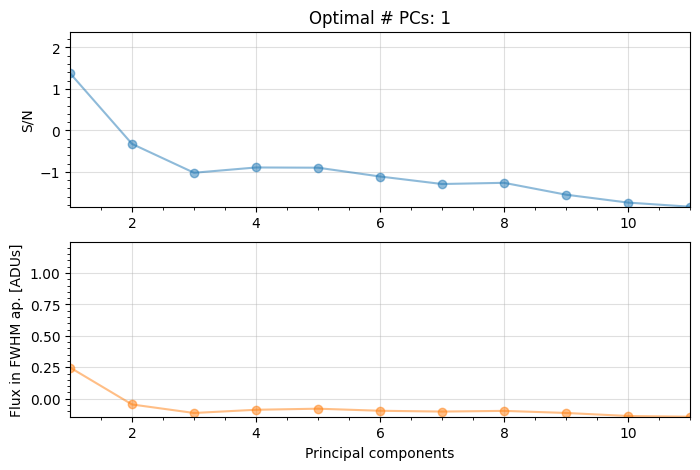

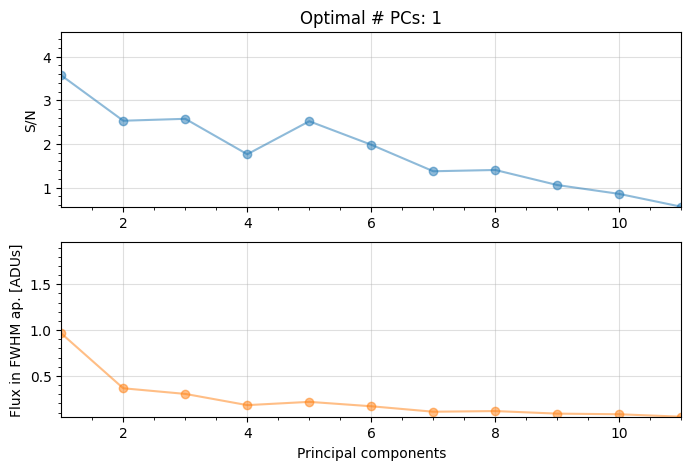

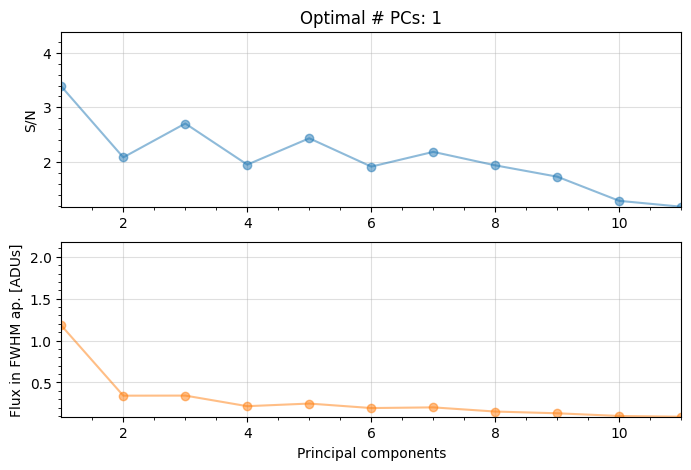

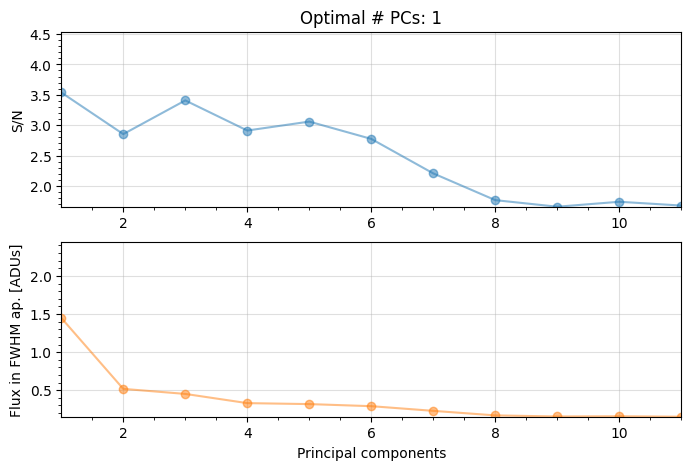

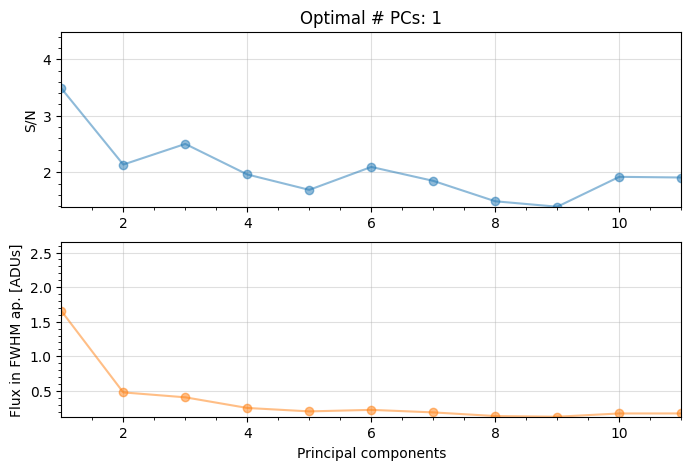

...

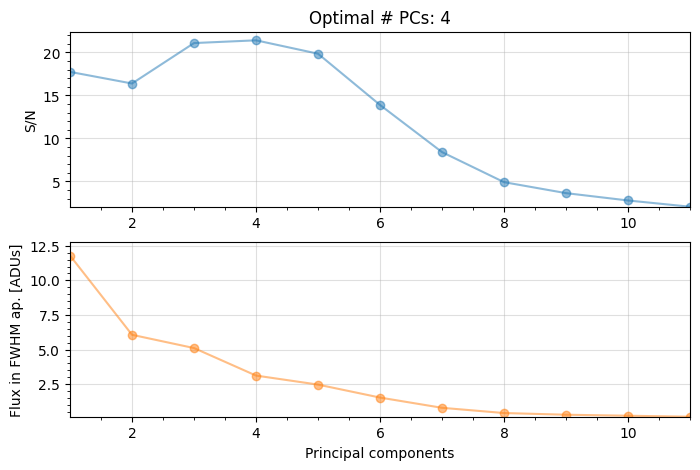

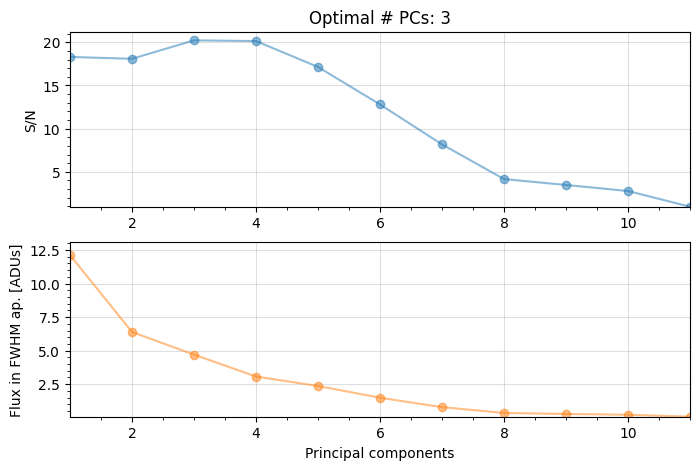

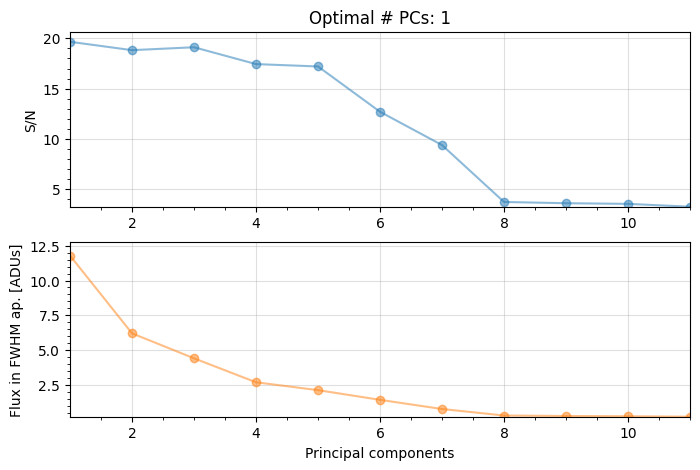

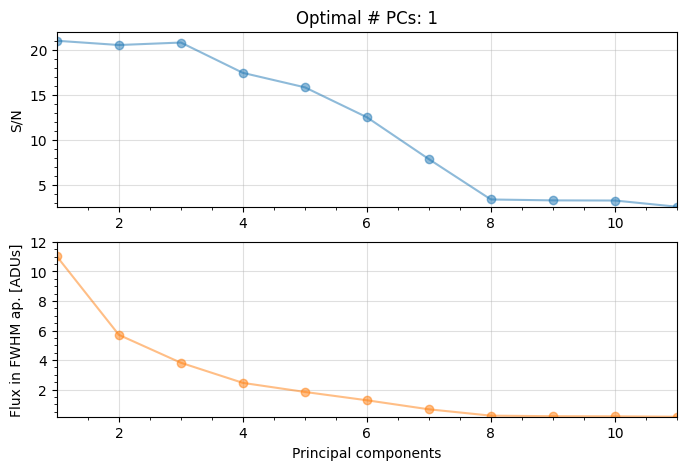

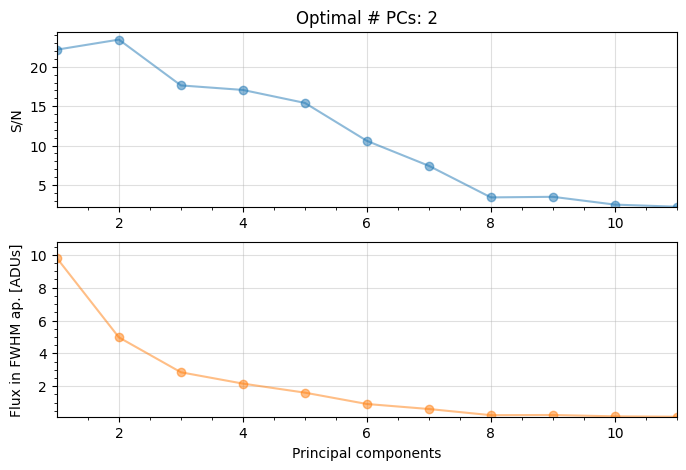

In [65]:
all_frs = []
all_snrs = []
all_pcs = []
for i in range(nch):
    res_ann_opt = pca_grid(cube_fc[i], derot_angles, fwhm=fwhm[i], range_pcs=(1,11,1), 
                           source_xy=xy_c, mode='annular', annulus_width=int(4*fwhm[i]), 
                           imlib='opencv', full_output=True, plot=True, exclude_negative_lobes=True)
    _, final_ann_opt, df, opt_npc_ann = res_ann_opt
    all_frs.append(final_ann_opt)
    pcs = df['PCs']
    snrs = df['S/Ns']
    opt_snr = snrs[df.index[pcs==opt_npc_ann]]
    print("Opt SNR: {}, for npc={}".format(float(opt_snr), opt_npc_ann))
    all_snrs.append(float(opt_snr))
    all_pcs.append(opt_npc_ann)

Let's plot the results:

Text(0, 0.5, 'SNR of c')

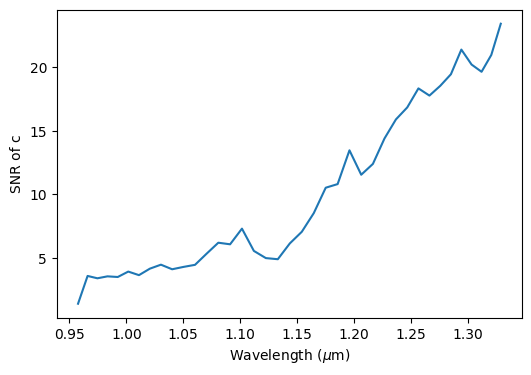

In [66]:
plt.figure(figsize=(6,4))
plt.plot(lbda, all_snrs)
plt.xlabel(r"Wavelength ($\mu$m)")
plt.ylabel("SNR of c")

Let's (reverse) sort to only keep the best 8 channels:

In [67]:
order_snr = np.flip(np.argsort(all_snrs))
sorted_npc = np.array(all_pcs)[order_snr]
sorted_ch = np.arange(nch)[order_snr]
sorted_frs = np.array(all_frs)[order_snr]
sorted_snr = np.array(all_snrs)[order_snr]

Let's finally show these 8 channels with optimal SNR:

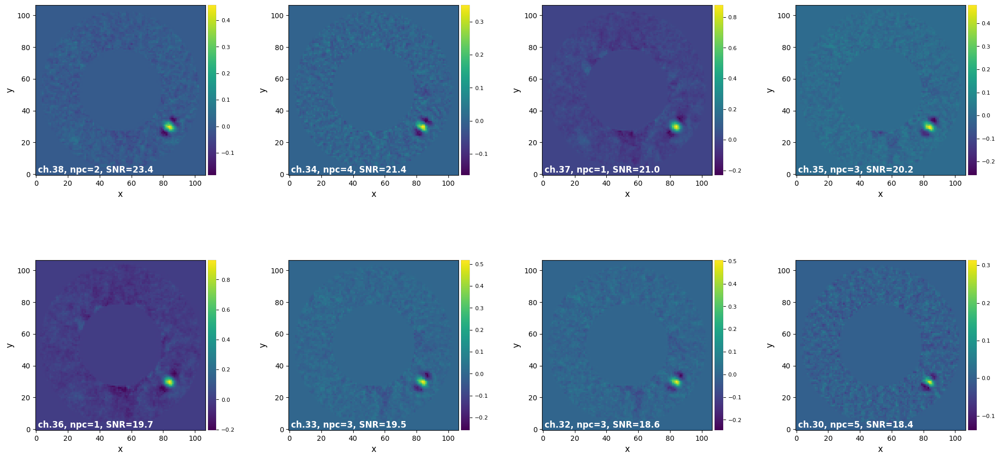

In [68]:
cutoff = 8
final_frs_c = tuple(sorted_frs[:cutoff])
final_chs_c = sorted_ch[:cutoff]
final_npcs_c = sorted_npc[:cutoff]

labels = ['ch.{}, npc={}, SNR={:.1f}'.format(final_chs_c[i], final_npcs_c[i], sorted_snr[i]) for i in range(cutoff)]
labels = tuple(labels)

plot_frames(final_frs_c, label=labels, rows=2)

### 7.6.2. NEGFC+PCA-ADI (simplex)

Let's now find the optimal position of planet c by running the `firstguess` function on the 8 best spectral channels (corresponding to the highest SNR, as determined above):

In [69]:
crop_cube_c = cube_fc[final_chs_c]
crop_cube_c.shape

(8, 55, 107, 107)

In [70]:
psfn_crop_c = psfn[final_chs_c]

In [71]:
trans_crop_c = [trans[0]]
for i in final_chs_c:
    trans_crop_c.append(trans[i])
trans_crop_c = np.array(trans_crop_c)

――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Starting time: 2023-09-04 21:13:17
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――

――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
             Planet 0           
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――

Planet 0: flux estimation at the position [83.8,29.9], running ...
Processing spectral channel 0...
... optimal grid flux: 25.929 ($\chi^2_r$ = 1.4)
Processing spectral channel 1...
... optimal grid flux: 25.929 ($\chi^2_r$ = 1.5)
Processing spectral channel 2...
... optimal grid flux: 25.929 ($\chi^2_r$ = 1.2)
Processing spectral channel 3...
... optimal grid flux: 38.566 ($\chi^2_r$ = 1.4)
Processing spectral channel 4...
... optimal grid flux: 25.929 ($\chi^2_r$ = 1.2)
Processing spectral channel 5...
... optimal grid flux: 25.929 ($\chi^2_r$ = 1.4)
Processing spectral channel 6...
... optimal gr

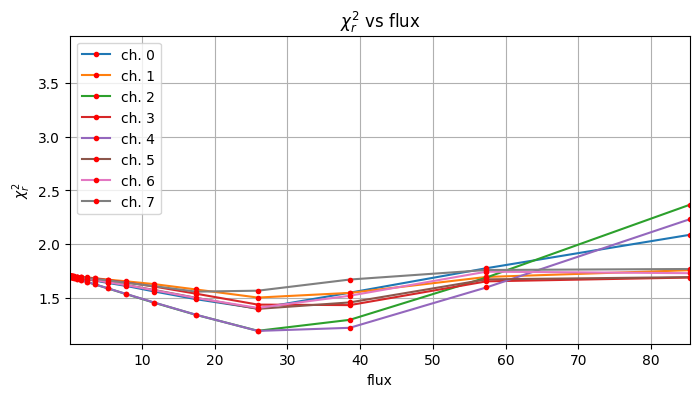

Planet 0: preliminary position guess: (r, theta)=(38.5, 323.1)
Planet 0: preliminary flux guess: 25.9, 25.9, 25.9, 38.6, 25.9, 25.9, 25.9, 17.4
Planet 0: Simplex Nelder-Mead minimization, running ...
Planet 0: Success: True, nit: 446, nfev: 821, chi2r: 0.08853499430766378
message: Optimization terminated successfully.
Planet 0 simplex result: (r, theta, f0, f1, f2, f3, f4, f5, f6, f7)=(25.571, 23.625, 29.279, 31.809, 31.204, 29.231, 27.062, 17.118) at 
          (X,Y)=(83.77, 29.95)

 ―――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――― 
DONE !
 ――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Running time:  0:19:06.681801
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――


In [72]:
res = firstguess(crop_cube_c, derot_angles, psfn_crop_c, ncomp=list(final_npcs_c),
                 planets_xy_coord=[xy_c], fwhm=np.mean(fwhm), annulus_width=int(4*np.mean(fwhm)),
                 aperture_radius=2, imlib='opencv', transmission=trans_crop_c, mu_sigma=True, 
                 force_rPA=False, simplex=True, plot=True, verbose=True)
r0c = res[0]
theta0c = res[1]
fluxes0c = res[2]

In [73]:
res

(array([38.448522]),
 array([323.1687874]),
 array([[25.57130164, 23.62535398, 29.27905427, 31.80925639, 31.20381454,
         29.23071464, 27.06177037, 17.11751566]]))

Let's compare the estimates to their respective ground truth values:

In [74]:
print("r (gt): {:.2f} VS. r (estimated): {:.2f}".format(r_c, r0c[0]))
print("theta (gt): {:.2f} VS. r (estimated): {:.2f}".format(theta_c%360, theta0c[0]))
for i, ch in enumerate(final_chs_c):
    print("flux ch.{} (gt): {:.2f} VS. r (estimated): {:.2f}".format(ch, flux_c_scal[ch], fluxes0c[0,i]))

r (gt): 38.50 VS. r (estimated): 38.45
theta (gt): 323.13 VS. r (estimated): 323.17
flux ch.38 (gt): 24.66 VS. r (estimated): 25.57
flux ch.34 (gt): 29.42 VS. r (estimated): 23.63
flux ch.37 (gt): 28.25 VS. r (estimated): 29.28
flux ch.35 (gt): 30.51 VS. r (estimated): 31.81
flux ch.36 (gt): 30.09 VS. r (estimated): 31.20
flux ch.33 (gt): 27.34 VS. r (estimated): 29.23
flux ch.32 (gt): 25.13 VS. r (estimated): 27.06
flux ch.30 (gt): 22.10 VS. r (estimated): 17.12


### 7.6.3. NEGFC+PCA-ADI (MCMC)

A better, albeit slower way, to infer the astrometry of each planet with uncertainties is to use an MCMC approach. Our specific case can be solved with the `mcmc_negfc_sampling`, which can, since VIP v1.2.3, also deal with 4D cubes. We refer to tutorial 5 for more details on how to set up the parameters for the MCMC algorithm.

In [75]:
import pickle

lab='c'
ann_width = 4*np.mean(fwhm)
aperture_radius=2
imlib_rot='opencv'
interpolation = 'lanczos4'
nwalkers, itermin, itermax = (100, 200, 500)
conv_test, ac_c, ac_count_thr, check_maxgap = ('ac', 50, 1, 50)

algo_params = {'algo': pca_annulus,
               'annulus_width': ann_width,
               'svd_mode': 'lapack',
               'imlib': imlib_rot, 
               'interpolation': interpolation}
conv_params = {'conv_test': conv_test,
               'ac_c': ac_c,
               'ac_count_thr': ac_count_thr,
               'check_maxgap': check_maxgap}
mcmc_params = {'nwalkers': nwalkers,
               'niteration_min': itermin,
               'niteration_limit': itermax,
               'bounds': None,
               'sigma':'spe', 
               'nproc': 2}
negfc_params = {'mu_sigma': True,
                'aperture_radius': aperture_radius}
obs_params = {}

Note that when the flux variation is known throughout the observation (e.g. through a background star or satellite spots) or if you wish to take into account the effect of airmass, it is possible to provide a `weights` parameter for the injection of the mean flux to be scaled at the moment of injection in each image to follow in (this is a new addition since [Christiaens et al. 2021](https://ui.adsabs.harvard.edu/abs/2021MNRAS.502.6117C/abstract)).

In [76]:
weights=X_fac

In [77]:
# input to MCMC
init = [r0c[0], theta0c[0]]
for i in range(cutoff):
    init.append(fluxes0c[0,i])
initial_state = np.array(init)
obs_params['psfn']= psfn[final_chs_c]
obs_params['fwhm']= np.mean(fwhm[final_chs_c]) # REPLACE AFTER DEALING WITH FWHM format
obs_params['transmission']= trans_crop_c
algo_params['ncomp'] = list(final_npcs_c)

**Warning**: The following box is very computer intensive. It can be skipped if needed.

――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Starting time: 2023-09-04 21:32:24
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
        MCMC sampler for the NEGFC technique       
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
The mean and stddev in the annulus at the radius of the companion (excluding the PA area directly adjacent to it) are -0.00 and 0.08 respectively.
Beginning emcee Ensemble sampler...
emcee Ensemble sampler successful

Start of the MCMC run ...
Step  |  Duration/step (sec)  |  Remaining Estimated Time (sec)
0		41.81712			20866.74113
1		42.05517			20943.47366
2		42.25058			20998.53776
3		42.05411			20858.83806
4		41.91217			20746.52662
5		42.18080			20837.31421
6		42.14913			20779.52109
7		42.30519			20814.15496
8		41.98141			20612.87329
9		41.94757			20554.30930
10		42.14506			20608.93630
11		42.13808			20563.38450
12		42.07663			20491.31784
13		41.86861			20348.

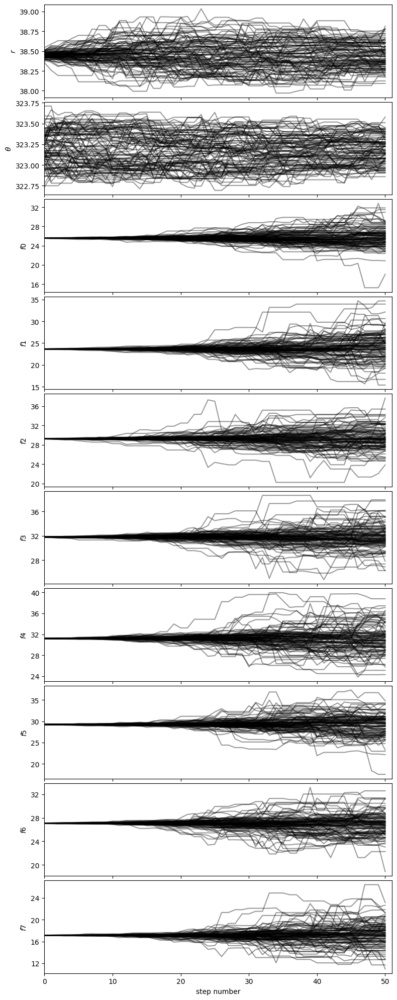

51		43.63322			19547.68166
52		41.83144			18698.65189
53		42.39968			18910.25505
54		41.92196			18655.27265
55		42.14612			18712.87550
56		41.26352			18279.73980
57		42.06086			18590.89924
58		41.95651			18502.82047
59		41.94094			18454.01272
60		41.87321			18382.33963
61		41.89608			18350.48129
62		41.90630			18313.05091
63		41.83366			18239.47402
64		41.91617			18233.53351
65		41.92651			18196.10621
66		42.03279			18200.19980
67		41.97386			18132.70666
68		41.86475			18043.70768
69		41.86256			18000.89994
70		42.05472			18041.47316
71		41.86669			17918.94503
72		41.89884			17890.80511
73		41.92190			17858.73110
74		41.89440			17805.12043
75		42.02425			17818.28285
76		41.96995			17753.28885
77		41.86499			17667.02705
78		42.10452			17726.00208
79		42.18541			17717.87052
80		42.12267			17649.39915
81		42.45607			17746.63517
82		42.23024			17610.00966
83		42.82494			17815.17629
84		477.98540			198363.94058
85		892.92053			369669.10025
86		53.74804			22197.94176
87		638.08666			262891.7

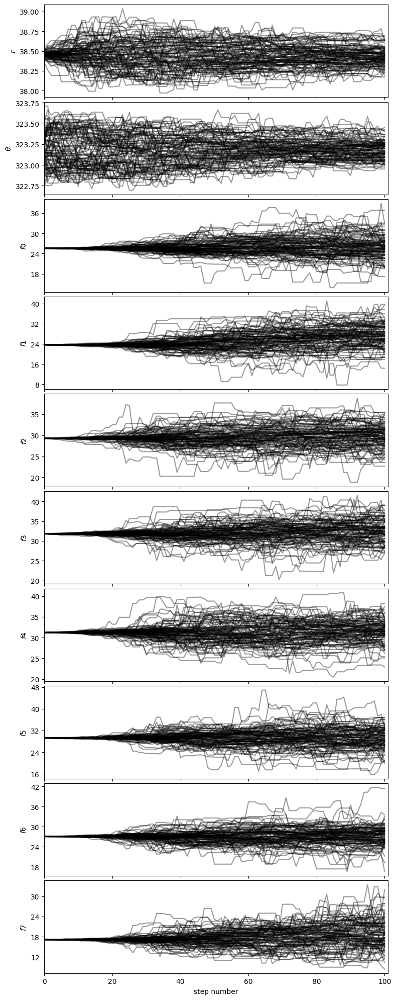

101		55.64731			22147.63097
102		53.79225			21355.52523
103		53.71390			21270.70242
104		52.79842			20855.37472
105		53.78711			21192.12134
106		53.89019			21178.84271
107		53.74832			21069.34066
108		53.84558			21053.62256
109		53.80480			20983.87200
110		53.80542			20930.30994
111		53.72449			20845.10290
112		53.83877			20835.60244
113		52.84701			20398.94663
114		52.85735			20350.07821
115		52.94721			20331.72864
116		51.83082			19851.20483
117		53.91624			20596.00444
118		53.96386			20560.22876
119		53.07004			20166.61558
120		53.91000			20431.89076
121		53.86298			20360.20606
122		52.95943			19965.70323
123		52.97351			19918.04051
124		52.96810			19863.03675
125		53.97739			20187.54349
126		52.90297			19732.80669
127		53.86008			20035.95088
128		52.98388			19657.01948
129		52.96288			19596.26560
130		53.03563			19570.14784
131		51.92094			19106.90445
132		51.82886			19021.19089
133		53.87127			19716.88372
134		51.86272			18929.89171
135		50.85476			18511.13191
136		51.88363			1883

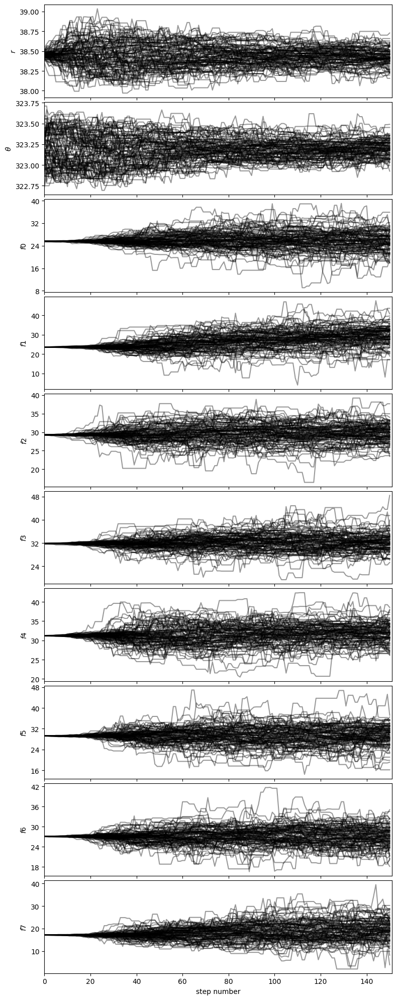

151		56.17343			19548.35260
152		537.94615			186667.31509
153		43.83984			15168.58326
154		40.32653			13912.65251
155		41.09566			14136.90773
156		41.24589			14147.33856
157		41.30415			14126.01964
158		41.55931			14171.72607
159		40.85453			13890.53918
160		41.71178			14140.29342
161		41.00115			13858.39005
162		41.74896			14069.39817
163		41.01665			13781.59306
164		41.74770			13985.47984
165		40.99466			13692.21644
166		41.77481			13911.01140
167		41.75709			13863.35388
168		41.77275			13826.78157
169		41.74837			13776.96276
170		40.98327			13483.49583
171		41.69626			13676.37197
172		41.75223			13652.97954
173		40.95541			13351.46431
174		41.73034			13562.35952
175		40.99905			13283.69220
176		41.08638			13270.90171
177		41.75050			13443.66036
178		41.68406			13380.58262
179		40.98326			13114.64256
180		41.72206			13309.33810
181		40.98643			13033.68601
182		41.02168			13003.87256
183		40.34039			12747.56387
184		39.55200			12458.88126
185		40.31115			12657.70047
186		41.73083			13

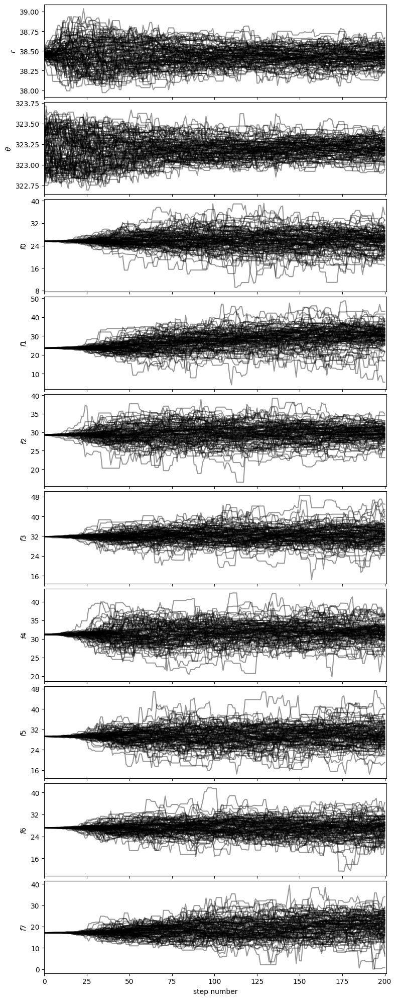

Auto-corr tau/N = [0.09347904 0.09561319 0.08426051 0.11232489 0.08264586 0.08455195
 0.08211815 0.08145387 0.08444775 0.09590046]
tau/N <= 0.02 = [False False False False False False False False False False] 

201		42.50314			12665.93602
202		41.76354			12403.77138
203		40.31459			11933.11775
204		41.04635			12108.67296
205		41.04584			12067.47814
206		41.76556			12237.30908
207		40.30522			11769.12453
208		40.25979			11715.59773
209		40.29461			11685.43719
210		41.04135			11860.94928
211		41.01181			11811.40157
212		41.75652			11984.12181
213		41.04776			11739.66079
214		41.73190			11893.59064
215		41.00021			11644.05992
216		41.02836			11611.02503
217		40.31079			11367.64250
218		41.01993			11526.60173
219		40.99261			11477.93024
220		40.29989			11243.66931
221		40.31663			11208.02342
222		41.76545			11569.02854
223		41.03153			11324.70173
224		41.79309			11493.10002
225		41.01081			11236.96304
226		41.79149			11409.07732
227		41.77918			11363.93614
228		41.01371			11114.71514
229		

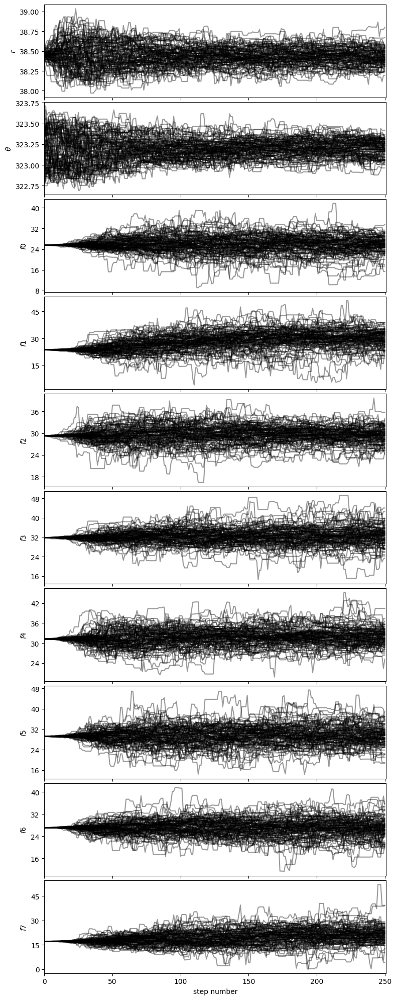

Auto-corr tau/N = [0.09125875 0.09018422 0.08027008 0.10685078 0.07998624 0.08696761
 0.07978198 0.08022027 0.0815346  0.0930632 ]
tau/N <= 0.02 = [False False False False False False False False False False] 

251		42.84930			10626.62640
252		41.82234			10330.11798
253		41.00155			10086.38204
254		41.00625			10046.53125
255		41.04656			10015.35966
256		40.99205			9961.06912
257		41.74751			10102.89742
258		41.74933			10061.58757
259		40.22853			9654.84744
260		41.73961			9975.76751
261		41.74927			9936.32555
262		40.27001			9543.99166
263		41.75949			9855.24058
264		41.75994			9813.58519
265		41.08004			9612.72913
266		41.07647			9570.81704
267		41.02265			9517.25573
268		40.29393			9307.89806
269		41.04519			9440.39439
270		41.04779			9399.94368
271		41.73884			9516.45506
272		41.77889			9483.80689
273		41.77151			9440.36126
274		41.00146			9225.32760
275		39.52196			8852.91994
276		40.29266			8985.26385
277		40.29086			8944.57092
278		41.01916			9065.23524
279		40.31380			8869.03666

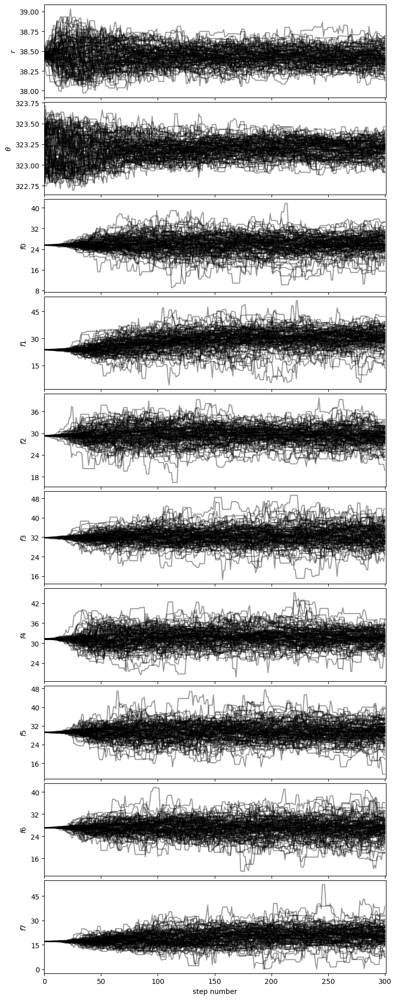

Auto-corr tau/N = [0.08662324 0.08653352 0.07620606 0.1004763  0.07890039 0.08663208
 0.07489417 0.08044629 0.08053869 0.09150712]
tau/N <= 0.02 = [False False False False False False False False False False] 

301		42.56516			8427.90168
302		41.77930			8230.52289
303		39.54391			7750.60656
304		40.33018			7864.38510
305		41.74123			8097.79784
306		40.28062			7774.15985
307		40.36843			7750.73894
308		41.01587			7834.03136
309		41.00078			7790.14744
310		40.27594			7612.15247
311		41.75629			7850.18327
312		41.72762			7803.06513
313		41.79502			7773.87446
314		41.77311			7728.02480
315		41.76816			7685.34181
316		41.73419			7637.35714
317		40.29115			7332.98966
318		40.29702			7293.76152
319		41.78749			7521.74892
320		41.75695			7474.49316
321		41.75042			7431.57458
322		41.79123			7397.04700
323		41.75472			7348.83037
324		41.01738			7178.04063
325		41.76386			7266.91164
326		41.74340			7221.60855
327		41.01203			7054.06847
328		41.11259			7030.25306
329		41.10687			6988.16773
330		4

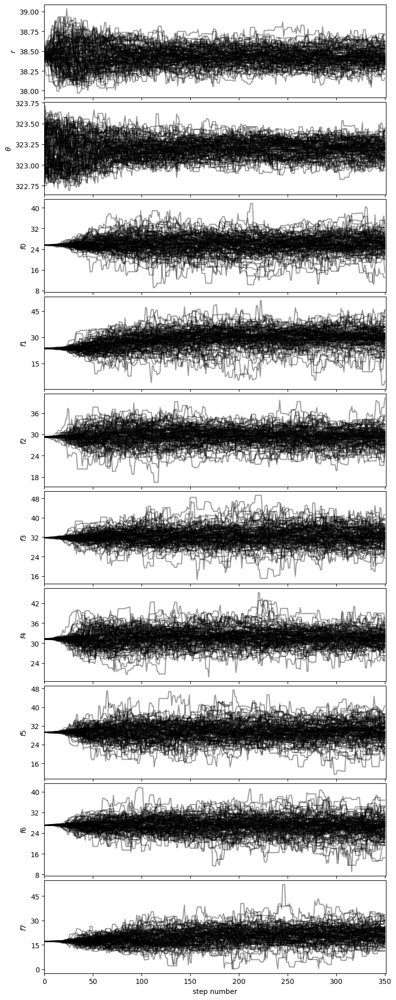

Auto-corr tau/N = [0.08310815 0.0818473  0.0735445  0.09533181 0.07724557 0.08313076
 0.07401993 0.07966698 0.07730491 0.08898034]
tau/N <= 0.02 = [False False False False False False False False False False] 

351		43.76259			6476.86332
352		41.79039			6143.18660
353		41.75764			6096.61559
354		41.76310			6055.64907
355		40.29709			5802.78082
356		41.02187			5866.12741
357		41.80463			5936.25675
358		41.04623			5787.51871
359		40.30676			5642.94598
360		41.77966			5807.37274
361		41.75690			5762.45248
362		41.75941			5721.03985
363		41.03655			5580.97026
364		41.77710			5639.90823
365		41.80192			5601.45755
366		41.01783			5455.37152
367		41.01054			5413.39141
368		41.00572			5371.74945
369		41.01424			5331.85159
370		40.98755			5287.39395
371		41.79680			5349.98976
372		41.09692			5219.30922
373		41.02201			5168.77313
374		41.06050			5132.56188
375		40.30556			4997.88907
376		41.04803			5048.90830
377		41.78575			5097.86138
378		41.79070			5056.67518
379		41.74445			5009.33352
380		4

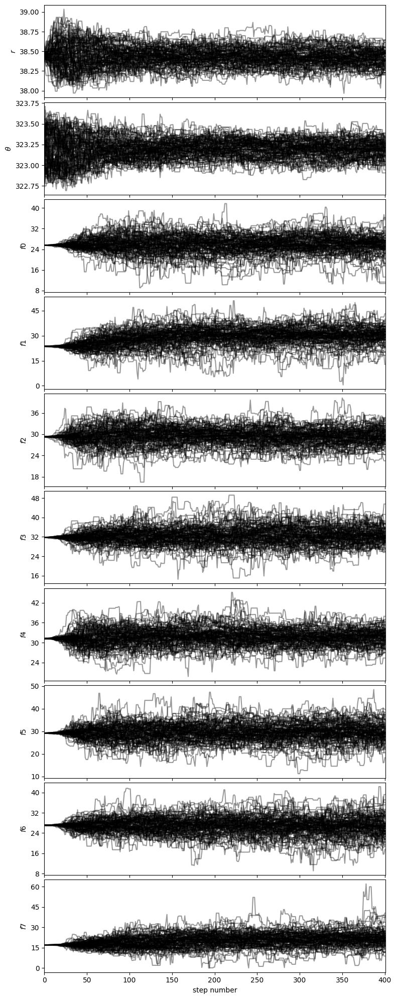

Auto-corr tau/N = [0.07959619 0.07928993 0.07127427 0.09059952 0.07482624 0.07625464
 0.07222198 0.07627437 0.07575282 0.08637388]
tau/N <= 0.02 = [False False False False False False False False False False] 

401		43.39419			4252.63042
402		41.73375			4048.17365
403		41.69502			4002.72192
404		41.00162			3895.15342
405		41.76054			3925.49038
406		40.99015			3812.08404
407		41.78619			3844.32930
408		41.74764			3799.03551
409		41.76091			3758.48172
410		40.29384			3586.15158
411		41.72119			3671.46490
412		41.76827			3633.83914
413		40.36175			3471.11033
414		41.73094			3547.12999
415		41.88693			3518.50212
416		40.36288			3350.11887
417		40.99467			3361.56294
418		41.81501			3387.01597
419		41.74734			3339.78696
420		41.03409			3241.69319
421		41.76791			3257.89706
422		41.75858			3215.41035
423		41.03348			3118.54486
424		40.30350			3022.76235
425		41.81571			3094.36232
426		40.30644			2942.36976
427		39.56865			2848.94266
428		41.01512			2912.07324
429		40.31564			2822.09466
430		4

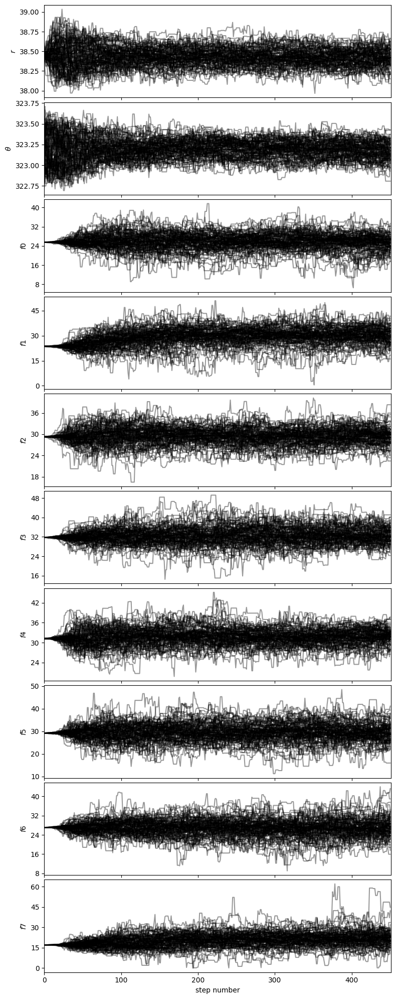

Auto-corr tau/N = [0.07834469 0.07708153 0.06958571 0.08640737 0.0743425  0.07285727
 0.07053894 0.07329253 0.07501715 0.082572  ]
tau/N <= 0.02 = [False False False False False False False False False False] 

451		43.66215			2095.78310
452		41.75264			1962.37403
453		41.74422			1920.23430
454		41.09738			1849.38197
455		41.75127			1837.05575
456		41.76035			1795.69526
457		41.72338			1752.38183
458		41.06809			1683.79181
459		40.33801			1613.52020
460		40.99177			1598.67883
461		41.78980			1588.01232
462		41.76855			1545.43650
463		41.79591			1504.65283
464		41.74202			1460.97060
465		41.02096			1394.71261
466		41.03726			1354.22942
467		41.14934			1316.77898
468		41.79466			1295.63434
469		41.73887			1252.16622
470		41.07431			1191.15508
471		41.79331			1170.21279
472		41.03104			1107.83803
473		41.09655			1068.51033
474		41.77533			1044.38335
475		41.74381			1001.85154
476		41.08530			944.96190
477		41.77701			919.09420
478		41.76702			877.10731
479		41.80577			836.11532
480		41.09

In [78]:
# MCMC
chain = mcmc_negfc_sampling(cube_fc[final_chs_c], derot_angles, **obs_params, **algo_params, **negfc_params, 
                            initial_state=initial_state, **mcmc_params, **conv_params, weights=weights,
                            display=True, verbosity=2, save=False, output_dir='./')

If you ran the previous box and wish to write your results, set `write=True` in the next box. This will pickle the MCMC chain.

In [79]:
write=False

if write:
    output = {'chain':chain}
    with open('../datasets/MCMC_results_pl{}_top{}ch'.format(lab, cutoff), 'wb') as fileSave:
        pickle.dump(output, fileSave)

In [80]:
with open('../datasets/MCMC_results_pl{}_top{}ch'.format(lab, cutoff), 'rb') as fi:
    myPickler = pickle.Unpickler(fi)
    mcmc_result = myPickler.load()

chain = mcmc_result['chain']

Let's visualize the chain after setting labels for each parameter:

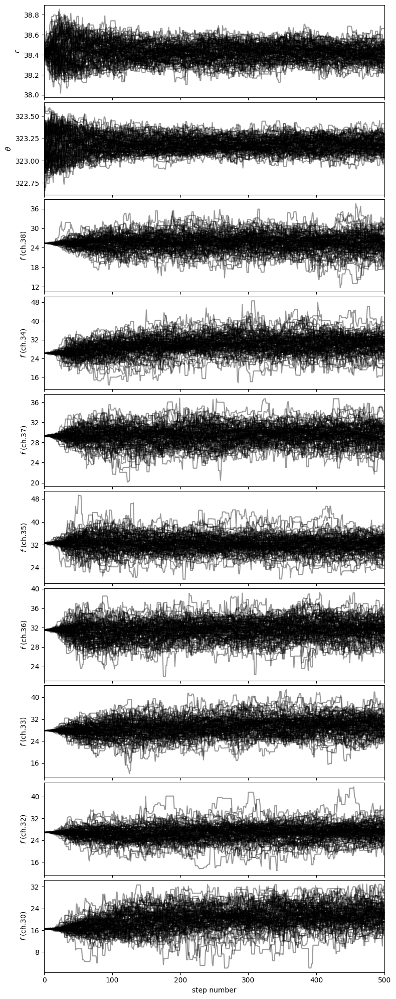

In [81]:
labels = [r"$r$", r"$\theta$"]
for i, ch in enumerate(final_chs_c):
    labels.append(r"$f$ (ch.{:.0f})".format(ch))
show_walk_plot(chain, labels=labels)

Let's visualize the corner plot after burning the first 30% of the chain:

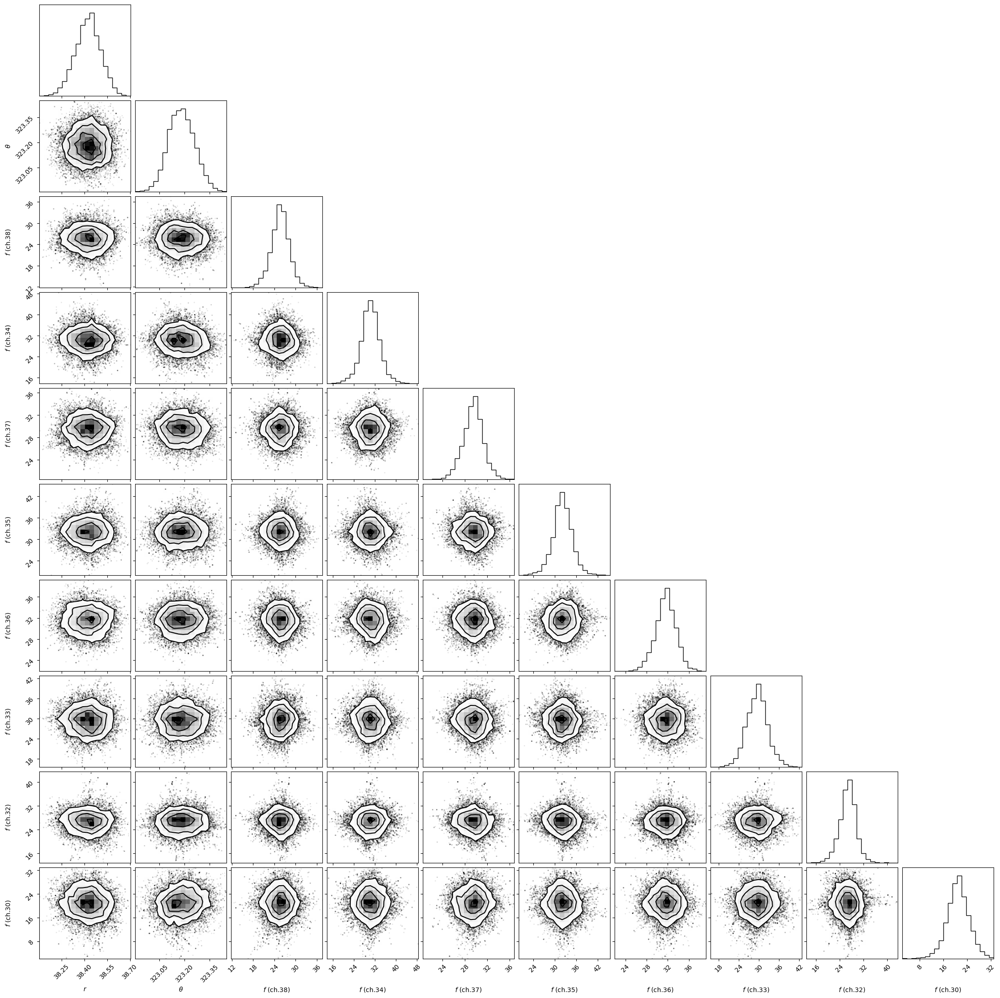

In [82]:
burnin = 0.3
show_corner_plot(chain, burnin=burnin, labels=labels)

To calculate 1-sigma (68%) confidence intervals on each parameter, let's first flatten the chain:

In [83]:
npar = len(initial_state)
isamples_flat = chain[:, int(chain.shape[1]//(1/burnin)):, :].reshape((-1,npar))

Then use the `confidence` function. 

Below, the first set of plots show the estimate, ground truth value and 68% confidence interval (in shaded area).

By setting 'gaussian_fit' to True, a second set of plots is also shown, where a Gaussian function is fit to each posterior distribution in order to infer mean and standard deviation for each parameter.

Note that the function can accept a ground truth value `gt`, which will be shown in the plots if provided.

/Users/valentin/GitHub/VIP/vip_hci/fm/negfc_mcmc.py:1538: UserWarning: The figure layout has changed to tight
  plt.tight_layout(w_pad=0.1)


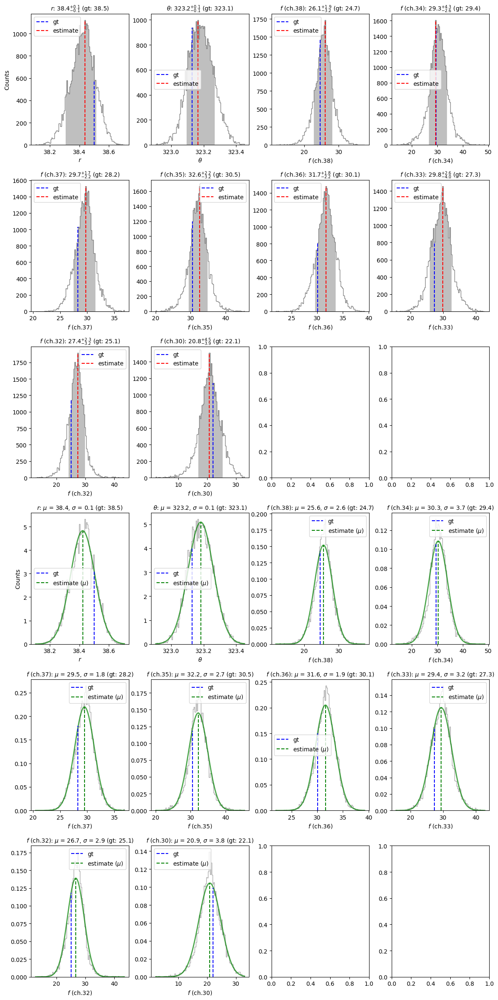

In [84]:
gt = [r_c, theta_c%360]
for i, ch in enumerate(final_chs_c):
    gt.append(flux_c_scal[ch])

mu, sigma = confidence(isamples_flat, cfd=68, gaussian_fit=True, verbose=False, 
                       gt=gt, save=False, title=True, labels=labels)

Overall we see that the estimated parameters are consistent with the ground truth values (shown with dashed blue lines).

In [85]:
r_est = mu[0]
theta_est = mu[1]

xc, yc = frame_center(cube_fc)
x_est = xc + r_est*np.cos(np.deg2rad(theta_est))
y_est = yc + r_est*np.sin(np.deg2rad(theta_est))

xy_est = (x_est, y_est)

## 7.7. Spectrum retrieval

### 7.7.1. NEGFC+PCA-ADI (simplex)

Let's use the negative fake companion technique (combined with PCA-ADI) to estimate the flux of the companion in each spectral channel. Here, we will just use the `firstguess` function in VIP which finds a first estimate on a grid of flux values followed by a simplex. Here we set `force_rPA=True` to pin the position during the NEGFC procedure (i.e. only allowing the fluxes at different wavelengths as free parameters).

In [86]:
est_fluxes_c = np.zeros(nch)
for i in range(nch):
    trans_i = np.array([trans[0],trans[i]])
    res = firstguess(cube_fc[i], derot_angles, psfn[i], ncomp=4, planets_xy_coord=[xy_est], 
                     fwhm=fwhm[i], annulus_width=int(4*fwhm[i]), aperture_radius=2, imlib='opencv',
                     f_range=None, transmission=trans_i, mu_sigma=True, force_rPA=True, weights=X_fac,
                     simplex=True, plot=False, verbose=False)
    _, _, est_fluxes_c[i] = res

Note that we arbitrarily assigned the number of principal components to 5 and 2 for the PCA-ADI algorithm used by NEGFC to measure the fluxes of the inner and outer fake planet. A more rigorous approach would consist in finding the optimal number of principal components for each spectral channel first, as done in Tutorial 5 (Sec. 5.2). 

Let's now compare the retrieved fluxes with and without weights to the ground truth values used for injection:

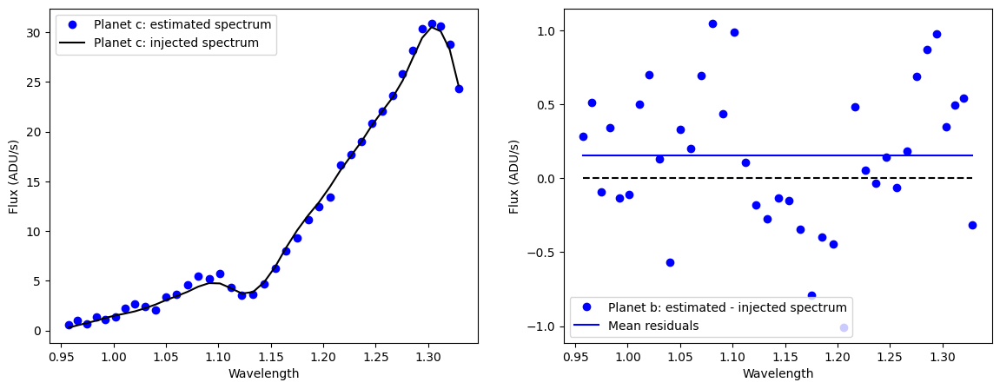

In [87]:
%matplotlib inline
fig, axes = plt.subplots(1,2, figsize = (14,5))
ax1, ax2 = axes
ax1.plot(lbda, est_fluxes_c, 'bo', label='Planet c: estimated spectrum')
ax1.plot(lbda, flux_c_scal, 'k', label='Planet c: injected spectrum')
ax1.set_xlabel("Wavelength")
ax1.set_ylabel("Flux (ADU/s)")
ax1.legend()

ax2.plot(lbda, est_fluxes_c-flux_c_scal, 'bo', label='Planet b: estimated - injected spectrum')
ax2.plot(lbda, [0]*len(lbda), 'k--')
ax2.plot(lbda, [np.mean(est_fluxes_c-flux_c_scal)]*len(lbda), 'b-', label='Mean residuals')
ax2.set_xlabel("Wavelength")
ax2.set_ylabel("Flux (ADU/s)")
ax2.legend()
plt.show()

This approach does not yield uncertainties. For the latter, it is recommended to run the `mcmc_negfc_sampling` function.

### 7.7.2. NEGFC+PCA-ADI (MCMC)

One can use the MCMC approach to have both estimates and uncertainties on the flux of directly imaged companions. Given that this approach is computationally expensive, we will only apply it to 3 spectral channels.

We refer to Tutorial 5 (Sec. 5.3.3.) for more details on setting the MCMC parameters.

In [88]:
ann_width = 4*np.mean(fwhm)
aperture_radius=2
imlib_rot='opencv'
interpolation = 'lanczos4'
nwalkers, itermin, itermax = (100, 200, 500)
conv_test, ac_c, ac_count_thr, check_maxgap = ('ac', 50, 1, 50)

algo_params = {'algo': pca_annulus,
               'annulus_width': ann_width,
               'svd_mode': 'lapack',
               'imlib': imlib_rot, 
               'interpolation': interpolation}
conv_params = {'conv_test': conv_test,
               'ac_c': ac_c,
               'ac_count_thr': ac_count_thr,
               'check_maxgap': check_maxgap}
mcmc_params = {'nwalkers': nwalkers,
               'niteration_min': itermin,
               'niteration_limit': itermax,
               'bounds': None,
               'sigma':'spe', 
               'nproc': 2}
negfc_params = {'mu_sigma': True,
                'aperture_radius': aperture_radius}
obs_params = {}

Important note: the pixel intensities in calibrated SPHERE cubes coming out from the DRH pipeline (as this one) are normalized by their integration time. In absence of knowledge of this original integration time, it is not possible to scale the cube bask to original ADU values, and it is therefore not possible to include photon noise uncertainty among the different sources of uncertainty (in this specific case, the estimated photon noise uncertainty will be so large that the MCMC will not work properly). To alleviate this issue, we set `sigma` to 'spe', instead of 'spe+pho' (default) - although this may slightly underestimate the final uncertainties.


In [89]:
import pickle

lab='c'
test_ch = [20,29,38]

**Warning**: the next box is computer-intensive. The results from that box have been saved in the 'datasets' folder, such that it can be skipped.

――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Starting time: 2023-09-05 04:26:04
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Done SVD/PCA with numpy SVD (LAPACK)
Running time:  0:00:00.058141
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Number of steps 11
Optimal number of PCs = 3, for S/N=7.015
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Coords of chosen px (X,Y) = 83.8, 30.0
Flux in a centered 1xFWHM circular aperture = 1.948
Central pixel S/N = 8.027
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Inside a centered 1xFWHM circular aperture:
Mean S/N (shifting the aperture center) = 6.612
Max S/N (shifting the aperture center) = 9.537
stddev S/N (shifting the aperture center) = 1.650



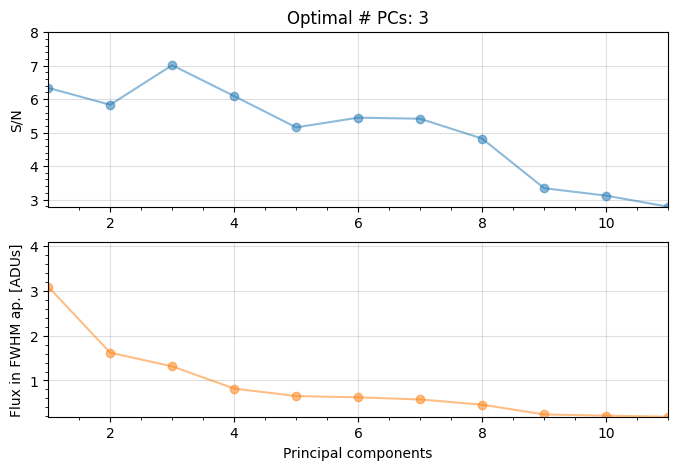

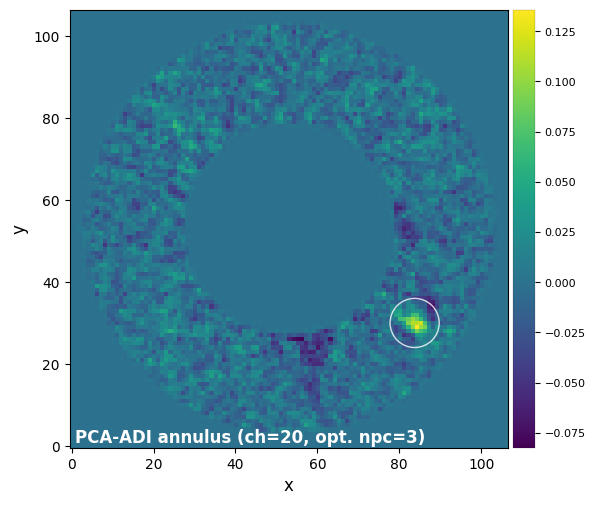

――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Starting time: 2023-09-05 04:26:05
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――

――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
             Planet 0           
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――

Planet 0: flux estimation at the position [83.75877533353938,29.974810067878558], running ...
Step | flux    | chi2r
1/30   0.100   0.076
2/30   0.149   0.076
3/30   0.221   0.074
4/30   0.329   0.073
5/30   0.489   0.070
6/30   0.728   0.067
7/30   1.083   0.062
8/30   1.610   0.056
9/30   2.395   0.047
10/30   3.562   0.038
11/30   5.298   0.030
12/30   7.880   0.033
13/30   11.721   0.068
14/30   17.433   0.200


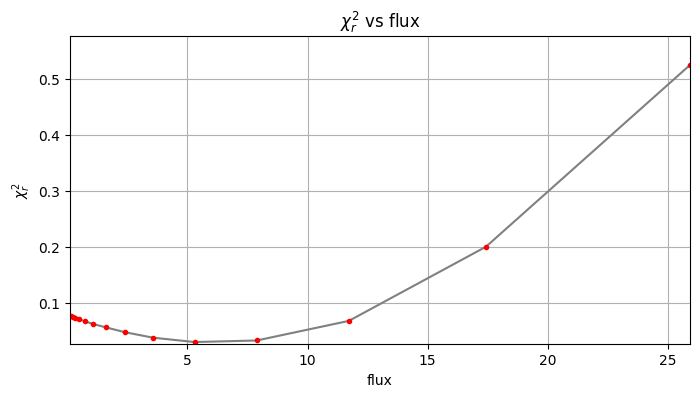

Planet 0: preliminary position guess: (r, theta)=(38.4, 323.2)
Planet 0: preliminary flux guess: 5.3
Planet 0: Simplex Nelder-Mead minimization, running ...
Planet 0: Success: True, nit: 23, nfev: 48, chi2r: 0.028579331290166817
message: Optimization terminated successfully.
Planet 0 simplex result: (r, theta, f)=(38.422, 323.182, 5.965) at 
          (X,Y)=(83.76, 29.97)

 ―――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――― 
DONE !
 ――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Running time:  0:00:07.825631
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Starting time: 2023-09-05 04:26:13
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
        MCMC sampler for the NEGFC technique       
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
The mean an

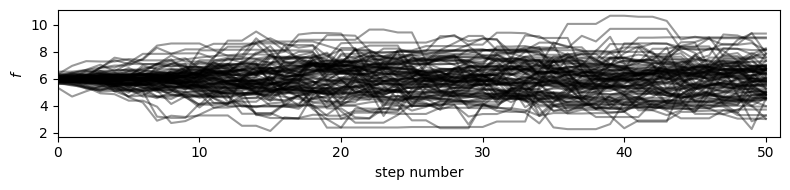

51		5.92291			2653.46278
52		5.78475			2585.78280
53		5.68336			2534.77678
54		5.78545			2574.52391
55		5.79088			2571.15205
56		5.77956			2560.34730
57		5.78624			2557.51720
58		5.78554			2551.42446
59		5.78833			2546.86432
60		5.78691			2540.45481
61		5.83563			2556.00813
62		5.79236			2531.25957
63		5.79076			2524.77136
64		5.78356			2515.84947
65		5.82386			2527.55567
66		5.73714			2484.18379
67		5.78953			2501.07739
68		5.78627			2493.88151
69		5.78452			2487.34360
70		5.78892			2483.44711
71		5.85125			2504.33372
72		5.78942			2472.08277
73		5.68260			2420.78803
74		5.78561			2458.88213
75		5.78647			2453.46158
76		5.78922			2448.84048
77		5.79086			2443.74165
78		5.78903			2437.18121
79		5.68771			2388.83988
80		5.78576			2424.23302
81		5.78567			2418.41006
82		5.73770			2392.62090
83		5.78288			2405.67642
84		5.78102			2399.12122
85		5.81944			2409.24982
86		5.79686			2394.10277
87		5.79095			2385.87181
88		5.78197			2376.38844
89		5.78912			2373.53838
90		5.78533			2366.20120


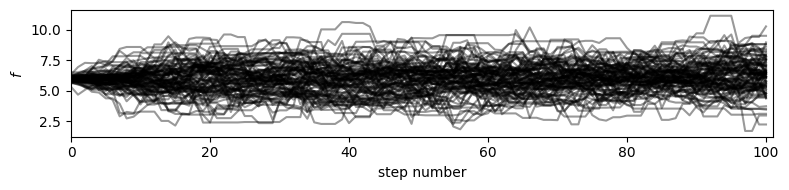

101		5.92042			2356.32835
102		5.83178			2315.21706
103		5.79724			2295.70585
104		5.79096			2287.42841
105		5.78602			2279.69188
106		5.81386			2284.84737
107		5.79125			2270.17196
108		5.78915			2263.55921
109		5.79312			2259.31719
110		5.78944			2252.09060
111		5.78384			2244.13031
112		5.78991			2240.69556
113		5.84593			2256.53052
114		5.78991			2229.11343
115		5.78651			2222.02138
116		5.78768			2216.67953
117		5.83678			2229.64843
118		5.69153			2168.47103
119		5.67950			2158.21190
120		5.78557			2192.73292
121		5.78649			2187.29398
122		5.78470			2180.83002
123		5.87200			2207.87388
124		5.78858			2170.71825
125		5.78669			2164.22019
126		5.78576			2158.08848
127		5.83447			2170.42358
128		5.78848			2147.52608
129		5.79112			2142.71329
130		5.80098			2140.56236
131		5.72596			2107.15475
132		5.72728			2101.91249
133		5.81056			2126.66423
134		5.82883			2127.52477
135		5.78889			2107.15523
136		5.78866			2101.28322
137		5.78887			2095.57239
138		5.68385			2051.86949
139		5.78673

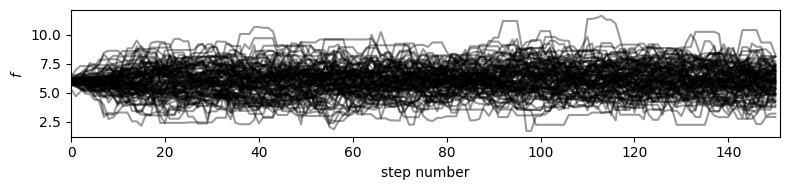

151		5.93598			2065.71930
152		5.73078			1988.58170
153		5.78481			2001.54530
154		5.75304			1984.79777
155		5.78034			1988.43662
156		5.78347			1983.72987
157		5.78661			1979.02096
158		5.78409			1972.37571
159		5.79393			1969.93484
160		5.78795			1962.11539
161		5.79546			1958.86616
162		5.78804			1950.56813
163		5.79069			1945.67083
164		5.79503			1941.33371
165		5.83628			1949.31685
166		5.79401			1929.40633
167		5.68512			1887.45984
168		5.81577			1925.02119
169		5.80091			1914.29964
170		5.81314			1912.52470
171		5.69688			1868.57566
172		5.69740			1863.05111
173		5.79748			1889.97913
174		5.79752			1884.19497
175		5.85812			1898.03023
176		5.78377			1868.15739
177		5.78275			1862.04711
178		5.78298			1856.33562
179		5.78753			1852.01024
180		5.69098			1815.42262
181		5.79279			1842.10881
182		5.78308			1833.23478
183		5.78013			1826.52013
184		5.79091			1824.13570
185		5.84228			1834.47623
186		5.79770			1814.68041
187		5.78089			1803.63862
188		5.78311			1798.54845
189		5.81995

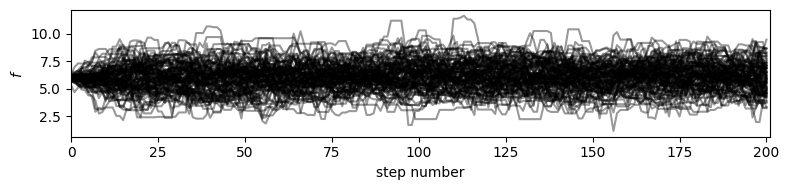

Auto-corr tau/N = [0.05777167]
tau/N <= 0.02 = [False] 

201		5.94631			1771.99949
202		5.78491			1718.11886
203		5.79139			1714.25292
204		5.78401			1706.28236
205		5.73463			1685.98181
206		5.83661			1710.12556
207		5.78338			1688.74842
208		5.78772			1684.22623
209		5.79282			1679.91635
210		5.81009			1679.11688
211		5.78987			1667.48256
212		5.78693			1660.84862
213		5.78693			1655.06227
214		5.78447			1648.57395
215		5.78636			1643.32709
216		5.81045			1644.35735
217		5.81501			1639.83141
218		5.78664			1626.04696
219		5.78272			1619.16244
220		5.78702			1614.57970
221		5.78612			1608.54080
222		5.68689			1575.26908
223		5.78385			1596.34370
224		5.78867			1591.88397
225		5.68067			1556.50248
226		5.78320			1578.81469
227		5.84810			1590.68429
228		5.78293			1567.17322
229		5.78829			1562.83722
230		5.80178			1560.67855
231		5.79384			1552.74885
232		5.79823			1548.12821
233		5.68997			1513.53335
234		5.78569			1533.20679
235		5.78772			1527.95887
236		5.78475			1521.38820
237		5.

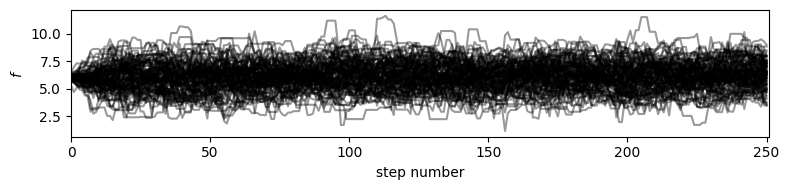

Auto-corr tau/N = [0.0534828]
tau/N <= 0.02 = [False] 

251		5.96401			1479.07522
252		5.79335			1430.95819
253		5.78149			1422.24679
254		5.72696			1403.10569
255		5.78300			1411.05200
256		5.78615			1406.03469
257		5.78055			1398.89310
258		5.83796			1406.94788
259		5.78680			1388.83248
260		5.78636			1382.94052
261		5.79240			1378.59025
262		5.78890			1371.96812
263		5.72617			1351.37588
264		5.78893			1360.39855
265		5.78490			1353.66613
266		5.79874			1351.10665
267		5.79246			1343.84979
268		5.84682			1350.61542
269		5.78395			1330.30942
270		5.73340			1312.94768
271		5.78804			1319.67380
272		5.81683			1320.42064
273		5.79233			1309.06590
274		5.78281			1301.13203
275		5.80982			1301.39901
276		5.80489			1294.49114
277		5.69346			1263.94745
278		5.71536			1263.09412
279		5.64625			1242.17500
280		5.79954			1270.10014
281		5.78263			1260.61421
282		5.79033			1256.50183
283		5.79432			1251.57290
284		5.78961			1244.76658
285		5.79228			1239.54749
286		5.78093			1231.33766
287		5.7

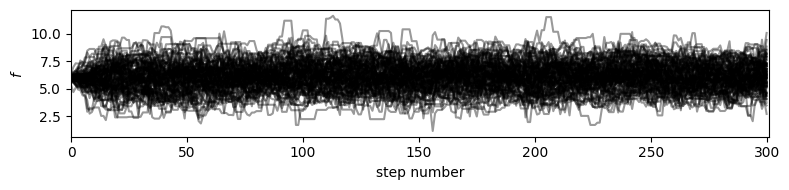

Auto-corr tau/N = [0.05170078]
tau/N <= 0.02 = [False] 

301		6.28871			1245.16399
302		5.78232			1139.11645
303		5.79218			1135.26708
304		5.79751			1130.51347
305		5.78035			1121.38790
306		5.78416			1116.34191
307		5.78923			1111.53178
308		5.78504			1104.94245
309		5.79104			1100.29703
310		5.86426			1108.34590
311		5.79100			1088.70856
312		5.78872			1082.49045
313		5.81552			1081.68598
314		5.78894			1070.95316
315		5.79270			1065.85606
316		5.79468			1060.42699
317		5.78738			1053.30371
318		5.79164			1048.28720
319		5.72628			1030.73004
320		5.86354			1049.57384
321		5.79283			1031.12410
322		5.78966			1024.76982
323		5.78765			1018.62552
324		5.78725			1012.76893
325		5.79095			1007.62530
326		5.78730			1001.20342
327		5.78690			995.34628
328		5.78545			989.31110
329		5.78867			984.07458
330		5.84859			988.41188
331		5.79350			973.30867
332		5.78946			966.83965
333		5.80244			963.20537
334		6.10535			1007.38341
335		6.16633			1011.27845
336		5.83273			950.73450
337		5.78368			

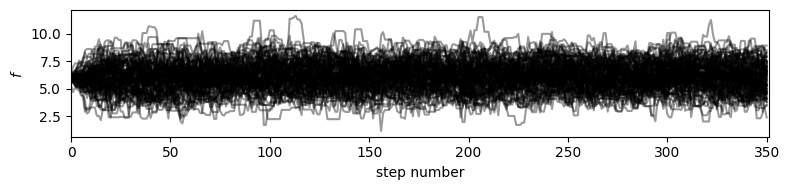

Auto-corr tau/N = [0.04723348]
tau/N <= 0.02 = [False] 

351		5.99917			887.87657
352		5.78769			850.79087
353		5.79100			845.48615
354		5.72492			830.11311
355		5.82885			839.35469
356		5.78613			827.41688
357		5.78306			821.19523
358		5.78807			816.11745
359		5.79009			810.61232
360		5.79129			804.98931
361		5.84521			806.63843
362		5.79357			793.71854
363		5.72361			778.41123
364		5.78249			780.63629
365		5.78560			775.27080
366		5.79017			770.09327
367		5.79621			765.09959
368		5.79341			758.93710
369		5.78175			751.62802
370		5.72098			738.00655
371		5.79038			741.16902
372		5.85322			743.35881
373		5.79728			730.45715
374		5.78558			723.19750
375		5.81300			720.81250
376		5.79169			712.37750
377		5.79622			707.13945
378		5.78837			700.39313
379		5.78953			694.74336
380		5.72777			681.60511
381		5.78278			682.36792
382		5.85269			684.76508
383		5.78095			670.59008
384		5.78877			665.70844
385		5.78531			659.52591
386		5.78419			653.61336
387		5.72638			641.35490
388		5.78939			642

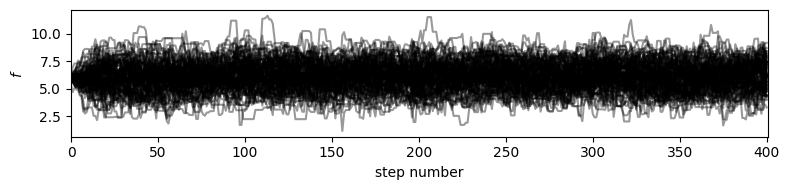

Auto-corr tau/N = [0.04213816]
tau/N <= 0.02 = [False] 

401		5.94912			583.01405
402		5.79194			561.81818
403		5.84562			561.17952
404		5.78266			549.35280
405		5.78300			543.60238
406		5.78880			538.35868
407		5.79045			532.72158
408		5.78927			526.82375
409		5.78813			520.93134
410		5.79030			515.33670
411		5.78944			509.47072
412		5.78947			503.68424
413		5.84111			502.33537
414		5.68842			483.51544
415		5.78665			486.07868
416		5.78414			480.08337
417		5.81701			476.99449
418		5.69478			461.27710
419		5.79163			463.33072
420		5.79290			457.63894
421		5.78676			451.36736
422		5.78499			445.44392
423		5.69766			433.02186
424		5.84177			438.13245
425		5.78661			428.20899
426		5.78596			422.37501
427		5.79558			417.28147
428		5.78920			411.03348
429		5.79263			405.48445
430		5.72490			395.01776
431		5.78664			393.49179
432		5.78573			387.64371
433		5.78809			382.01401
434		5.78364			375.93660
435		5.68116			363.59450
436		5.78518			364.46659
437		5.78138			358.44531
438		5.74988			350

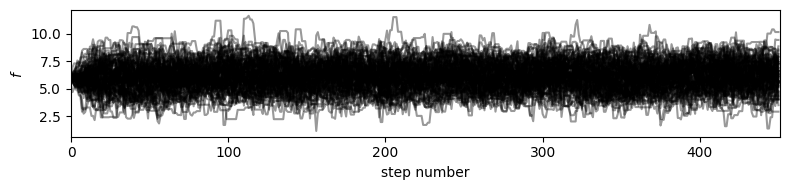

Auto-corr tau/N = [0.03772079]
tau/N <= 0.02 = [False] 

451		5.94748			285.47914
452		5.72938			269.28109
453		5.78114			265.93235
454		5.78666			260.39988
455		5.84425			257.14696
456		5.79037			248.98591
457		5.78706			243.05652
458		5.81613			238.46129
459		5.79339			231.73564
460		5.78314			225.54262
461		5.79365			220.15885
462		5.78618			214.08848
463		5.79152			208.49454
464		5.78839			202.59365
465		5.85937			199.21872
466		5.78282			190.83303
467		5.78397			185.08717
468		5.78661			179.38503
469		5.78552			173.56572
470		5.79060			167.92743
471		5.78263			161.91356
472		5.78922			156.30894
473		5.79116			150.57011
474		5.79437			144.85933
475		5.83990			140.15765
476		5.79201			133.21625
477		5.78818			127.33987
478		5.79325			121.65825
479		5.81464			116.29274
480		5.78639			109.94149
481		5.78717			104.16904
482		5.68494			96.64398
483		5.68546			90.96741
484		5.78794			86.81909
485		5.78974			81.05635
486		5.84911			76.03843
487		5.78298			69.39574
488		5.61917			61.81086


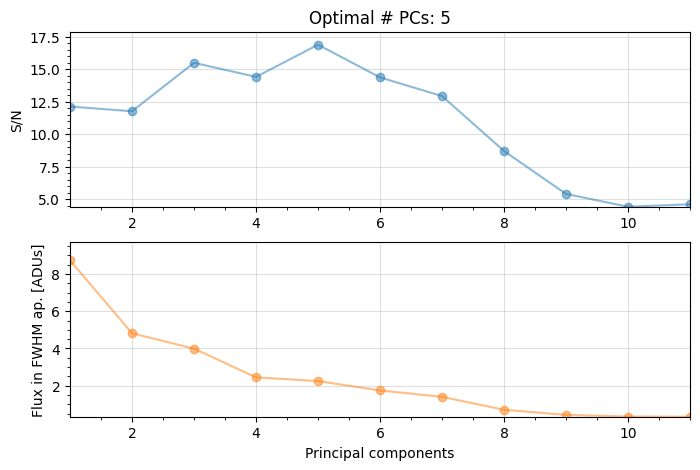

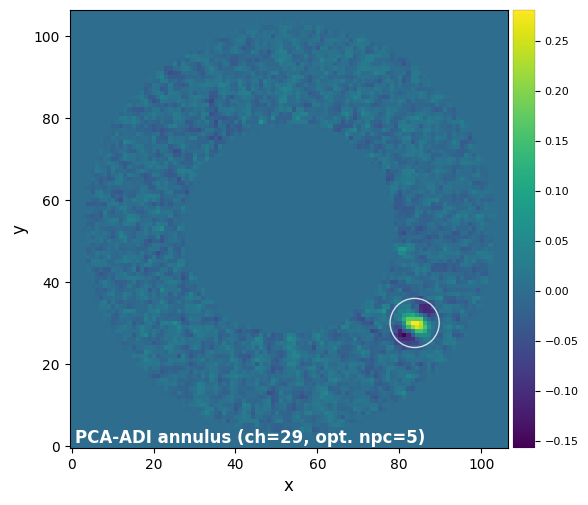

――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Starting time: 2023-09-05 05:14:38
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――

――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
             Planet 0           
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――

Planet 0: flux estimation at the position [83.75877533353938,29.974810067878558], running ...
Step | flux    | chi2r
1/30   0.100   0.248
2/30   0.149   0.247
3/30   0.221   0.246
4/30   0.329   0.244
5/30   0.489   0.242
6/30   0.728   0.237
7/30   1.083   0.230
8/30   1.610   0.220
9/30   2.395   0.205
10/30   3.562   0.185
11/30   5.298   0.158
12/30   7.880   0.121
13/30   11.721   0.078
14/30   17.433   0.038
15/30   25.929   0.050
16/30   38.566   0.213
17/30   57.362   0.487


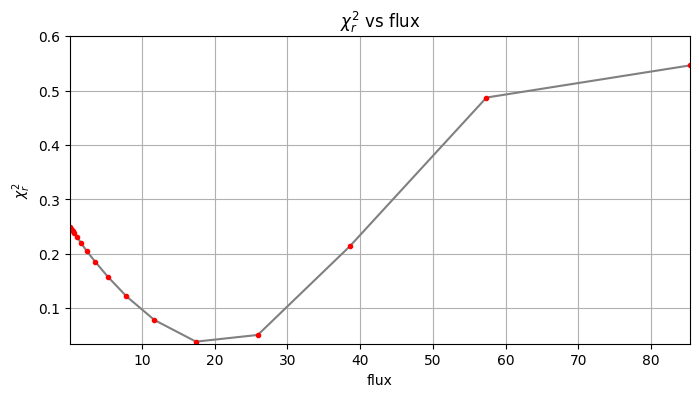

Planet 0: preliminary position guess: (r, theta)=(38.4, 323.2)
Planet 0: preliminary flux guess: 17.4
Planet 0: Simplex Nelder-Mead minimization, running ...
Planet 0: Success: True, nit: 26, nfev: 60, chi2r: 0.032676364712401304
message: Optimization terminated successfully.
Planet 0 simplex result: (r, theta, f)=(38.422, 323.182, 20.300) at 
          (X,Y)=(83.76, 29.97)

 ―――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――― 
DONE !
 ――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Running time:  0:00:09.716682
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Starting time: 2023-09-05 05:14:48
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
        MCMC sampler for the NEGFC technique       
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
The mean 

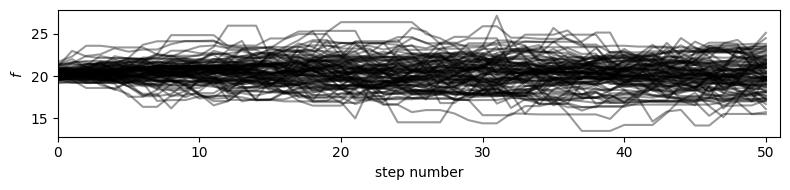

51		5.95542			2668.02995
52		5.82686			2604.60776
53		5.82178			2596.51433
54		5.84219			2599.77322
55		5.87866			2610.12726
56		5.82733			2581.50497
57		5.81826			2571.66959
58		5.85206			2580.75758
59		5.83321			2566.61328
60		5.83057			2559.61891
61		5.82859			2552.92067
62		5.82773			2546.71888
63		5.82012			2537.57014
64		5.82466			2533.72623
65		5.87812			2551.10408
66		5.82362			2521.62963
67		5.82112			2514.72557
68		5.82264			2509.55612
69		5.82479			2504.65927
70		5.83296			2502.34070
71		5.82683			2493.88281
72		5.83000			2489.41085
73		5.82748			2482.50605
74		5.82599			2476.04617
75		5.87583			2491.35065
76		5.81881			2461.35705
77		5.83177			2461.00567
78		5.81735			2449.10309
79		5.86098			2461.61118
80		5.83599			2445.27939
81		5.82657			2435.50459
82		5.83929			2434.98518
83		5.83174			2426.00384
84		5.82625			2417.89251
85		5.85097			2422.30324
86		5.85246			2417.06598
87		5.82099			2398.24664
88		5.81805			2391.21691
89		5.82385			2387.77973
90		5.81954			2380.19104


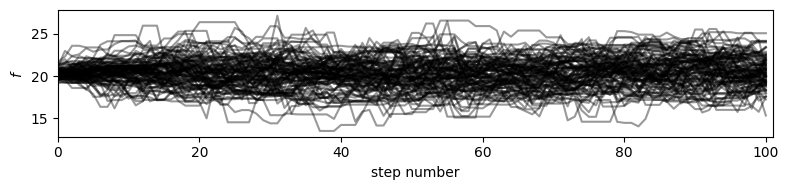

101		5.96577			2374.37726
102		5.82641			2313.08358
103		5.82489			2306.65763
104		5.81650			2297.51631
105		5.82364			2294.51455
106		5.89118			2315.23335
107		5.85937			2296.87422
108		5.81896			2275.21180
109		5.82482			2271.68058
110		5.81628			2262.53331
111		5.82591			2260.45153
112		5.82480			2254.19915
113		5.83142			2250.92773
114		5.82065			2240.95141
115		5.82557			2237.01811
116		5.88276			2253.09861
117		5.82771			2226.18637
118		5.82521			2219.40349
119		5.81765			2210.70700
120		5.86480			2222.75844
121		5.82093			2200.31230
122		5.82911			2197.57485
123		5.83323			2193.29335
124		5.82344			2183.79000
125		5.82328			2177.90747
126		5.82551			2172.91598
127		5.89119			2191.52454
128		5.82997			2162.91961
129		5.81365			2151.05013
130		5.82755			2150.36447
131		5.81065			2138.31920
132		5.82283			2136.97971
133		5.80952			2126.28542
134		5.80834			2120.04556
135		5.82250			2119.39146
136		5.81376			2110.39415
137		5.88283			2129.58555
138		5.82183			2101.68171
139		5.81210

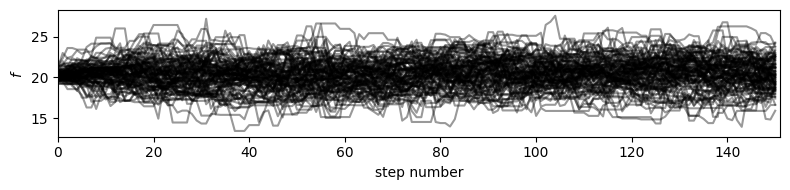

151		5.96131			2074.53588
152		5.82175			2020.14898
153		5.80677			2009.14173
154		5.81711			2006.90364
155		5.81715			2001.10029
156		5.81248			1993.68201
157		5.84521			1999.06285
158		5.83223			1988.79145
159		5.81966			1978.68372
160		5.80961			1969.45813
161		5.81163			1964.33060
162		5.80724			1957.04022
163		5.80874			1951.73731
164		5.83585			1955.01109
165		5.81634			1942.65756
166		5.81738			1937.18721
167		5.81652			1931.08431
168		5.87967			1946.17044
169		5.82381			1921.85697
170		5.81689			1913.75714
171		5.82203			1909.62420
172		5.81833			1902.59456
173		5.81552			1895.85985
174		5.81726			1890.60820
175		5.82307			1886.67403
176		5.81613			1878.60838
177		5.81534			1872.54077
178		5.87008			1884.29536
179		5.82764			1864.84608
180		5.82054			1856.75226
181		5.81734			1849.91380
182		5.81844			1844.44675
183		5.82972			1842.19247
184		5.81296			1831.08366
185		5.82492			1829.02425
186		5.82046			1821.80304
187		5.80846			1812.24046
188		5.85037			1819.46569
189		5.84401

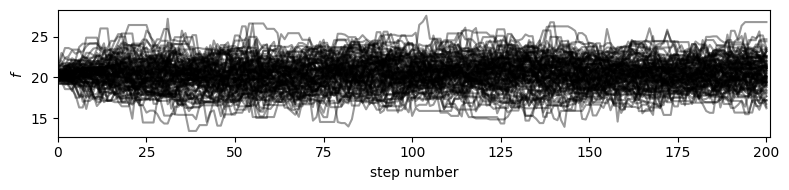

Auto-corr tau/N = [0.05979676]
tau/N <= 0.02 = [False] 

201		5.95929			1775.86812
202		5.82897			1731.20379
203		5.82909			1725.41153
204		5.82138			1717.30798
205		5.82428			1712.33714
206		5.81365			1703.39828
207		5.81391			1697.66172
208		5.81432			1691.96683
209		5.86817			1701.76843
210		5.81518			1680.58702
211		5.82168			1676.64355
212		5.81994			1670.32249
213		5.81448			1662.94128
214		5.81075			1656.06347
215		5.81278			1650.82924
216		5.81663			1646.10686
217		5.81526			1639.90276
218		5.81746			1634.70682
219		5.87513			1645.03584
220		5.81905			1623.51411
221		5.81933			1617.77402
222		5.81166			1609.82899
223		5.83084			1609.31129
224		5.82493			1601.85492
225		5.81795			1594.11720
226		5.81243			1586.79230
227		5.82075			1583.24454
228		5.81677			1576.34494
229		5.82458			1572.63795
230		5.88901			1584.14450
231		5.81757			1559.10769
232		5.81769			1553.32456
233		5.82241			1548.76106
234		5.81065			1539.82357
235		5.82128			1536.81845
236		5.80723			1527.30123
237		5.

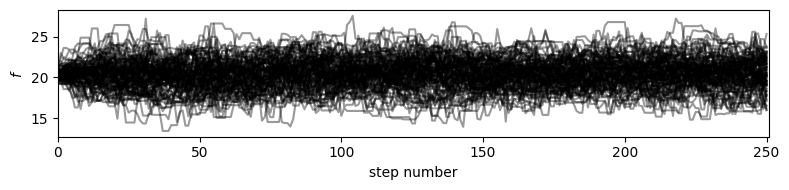

Auto-corr tau/N = [0.05550118]
tau/N <= 0.02 = [False] 

251		5.95305			1476.35739
252		5.81720			1436.84914
253		5.81459			1430.38963
254		5.81176			1423.88218
255		5.82317			1420.85226
256		5.82289			1414.96251
257		5.81607			1407.48846
258		5.81700			1401.89652
259		5.82046			1396.90992
260		5.82331			1391.77085
261		5.83018			1387.58379
262		5.96363			1413.38102
263		5.82018			1373.56295
264		5.84153			1372.75932
265		5.81740			1361.27137
266		5.81122			1354.01473
267		5.83153			1352.91566
268		5.81948			1344.29942
269		5.81812			1338.16852
270		5.81925			1332.60802
271		5.86162			1336.44982
272		5.82437			1322.13154
273		5.81348			1313.84535
274		5.82009			1309.52115
275		5.81655			1302.90698
276		5.82227			1298.36576
277		5.81949			1291.92589
278		5.82806			1288.00126
279		5.86366			1290.00454
280		5.82105			1274.81061
281		5.89103			1284.24541
282		5.82795			1264.66602
283		5.81934			1256.97679
284		5.82504			1252.38446
285		5.84173			1250.13108
286		5.81704			1239.02888
287		5.

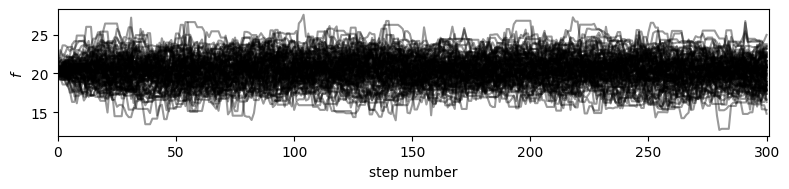

Auto-corr tau/N = [0.04987851]
tau/N <= 0.02 = [False] 

301		5.96876			1181.81448
302		5.86116			1154.64931
303		5.81725			1140.18100
304		5.80287			1131.56043
305		5.81867			1128.82256
306		5.82855			1124.90996
307		5.81362			1116.21581
308		5.82295			1112.18421
309		5.81123			1104.13370
310		5.81661			1099.33986
311		5.81179			1092.61652
312		5.86676			1097.08431
313		5.82227			1082.94166
314		5.81574			1075.91227
315		5.81550			1070.05163
316		5.81669			1064.45482
317		5.82918			1060.91131
318		5.81335			1052.21653
319		5.82059			1047.70674
320		5.80568			1039.21672
321		5.80595			1033.45928
322		5.87321			1039.55817
323		5.81597			1023.61107
324		5.81403			1017.45490
325		5.82659			1013.82631
326		5.81383			1005.79259
327		5.82632			1002.12738
328		5.81845			994.95529
329		5.83178			991.40243
330		5.81869			983.35878
331		5.82469			978.54758
332		5.81800			971.60567
333		5.85581			972.06496
334		5.81550			959.55750
335		5.81352			953.41712
336		5.80170			945.67726
337		5.82622			9

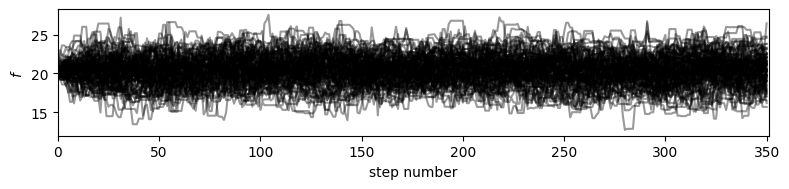

Auto-corr tau/N = [0.04555137]
tau/N <= 0.02 = [False] 

351		5.96639			883.02572
352		5.82074			855.64951
353		5.88146			858.69345
354		5.81553			843.25171
355		5.82010			838.09382
356		5.82043			832.32206
357		5.81831			826.20030
358		5.80059			817.88333
359		5.82236			815.12984
360		5.81490			808.27152
361		5.81583			802.58385
362		5.81479			796.62596
363		5.85810			796.70160
364		5.82683			786.62272
365		5.81612			779.35954
366		5.81490			773.38170
367		5.81850			768.04226
368		5.82335			762.85937
369		5.80327			754.42484
370		5.80678			749.07501
371		5.81591			744.43674
372		5.81180			738.09797
373		5.80621			731.58284
374		5.90001			737.50138
375		5.81542			721.11258
376		5.81601			715.36874
377		5.81330			709.22272
378		5.82084			704.32152
379		5.79720			695.66424
380		5.81519			692.00773
381		5.81098			685.69588
382		5.82617			681.66189
383		5.82580			675.79257
384		5.87798			675.96713
385		5.82279			663.79772
386		5.82289			657.98657
387		5.82205			652.06926
388		5.83124			647

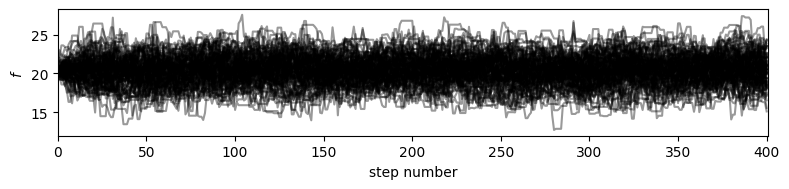

Auto-corr tau/N = [0.0418612]
tau/N <= 0.02 = [False] 

401		5.97038			585.09695
402		5.81814			564.35919
403		5.82229			558.93984
404		5.82154			553.04592
405		5.86471			551.28283
406		5.80937			540.27113
407		5.81568			535.04247
408		5.80854			528.57732
409		5.80625			522.56223
410		5.82652			518.56028
411		5.80570			510.90125
412		5.81757			506.12859
413		5.82151			500.64960
414		5.82580			495.19308
415		5.86055			492.28586
416		5.82008			483.06697
417		5.81883			477.14381
418		5.82002			471.42154
419		5.81873			465.49864
420		5.81918			459.71530
421		5.81611			453.65689
422		5.82001			448.14108
423		5.81915			442.25563
424		5.81464			436.09800
425		5.88040			435.14975
426		5.81851			424.75094
427		5.81817			418.90846
428		5.81801			413.07857
429		5.81989			407.39237
430		5.82369			401.83475
431		5.82077			395.81216
432		5.82211			390.08150
433		5.81870			384.03453
434		5.81415			377.91981
435		5.84286			373.94310
436		5.84888			368.47931
437		5.81900			360.77806
438		5.81156			354.

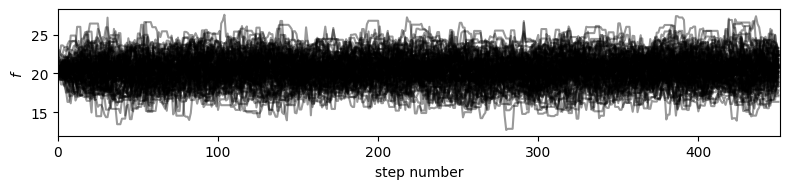

Auto-corr tau/N = [0.03901099]
tau/N <= 0.02 = [False] 

451		5.98592			287.32411
452		5.82443			273.74821
453		5.80610			267.08046
454		5.82318			262.04305
455		5.83862			256.89937
456		6.11773			263.06235
457		6.16058			258.74423
458		5.85654			240.11814
459		5.82199			232.87948
460		5.80288			226.31251
461		5.81864			221.10828
462		5.82347			215.46828
463		5.82076			209.54743
464		5.82400			203.84011
465		5.82377			198.00804
466		5.88122			194.08013
467		5.82230			186.31363
468		5.80020			179.80620
469		5.80702			174.21048
470		5.81942			168.76312
471		5.81282			162.75893
472		5.82098			157.16635
473		5.81493			151.18826
474		5.80291			145.07287
475		5.82020			139.68482
476		5.83139			134.12195
477		5.87363			129.21988
478		5.81749			122.16733
479		5.81642			116.32830
480		5.82342			110.64490
481		5.82112			104.78014
482		5.82086			98.95464
483		5.80988			92.95803
484		5.81513			87.22689
485		5.80813			81.31379
486		5.81942			75.65252
487		5.85559			70.26710
488		5.82505			64.07551


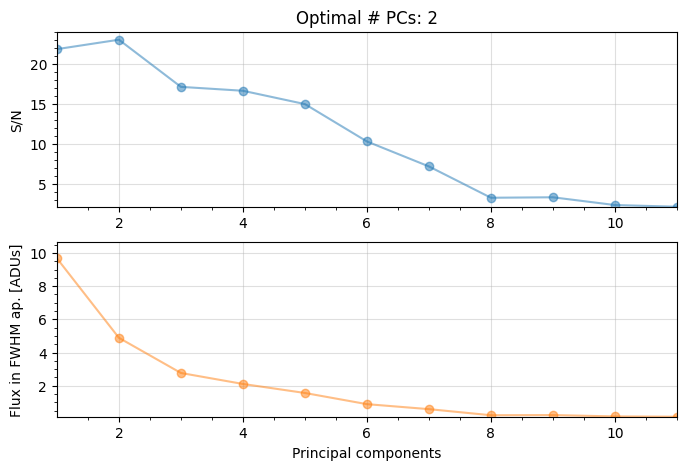

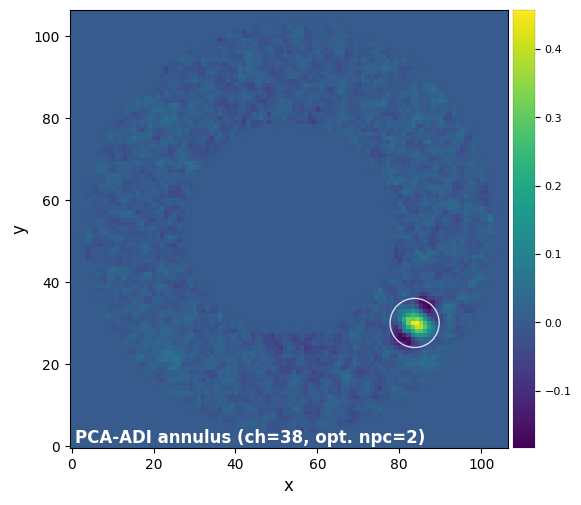

――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Starting time: 2023-09-05 06:03:32
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――

――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
             Planet 0           
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――

Planet 0: flux estimation at the position [83.75877533353938,29.974810067878558], running ...
Step | flux    | chi2r
1/30   0.100   0.628
2/30   0.149   0.626
3/30   0.221   0.624
4/30   0.329   0.619
5/30   0.489   0.613
6/30   0.728   0.603
7/30   1.083   0.589
8/30   1.610   0.568
9/30   2.395   0.538
10/30   3.562   0.494
11/30   5.298   0.432
12/30   7.880   0.350
13/30   11.721   0.230
14/30   17.433   0.107
15/30   25.929   0.031
16/30   38.566   0.201
17/30   57.362   0.906
18/30   85.317   2.627


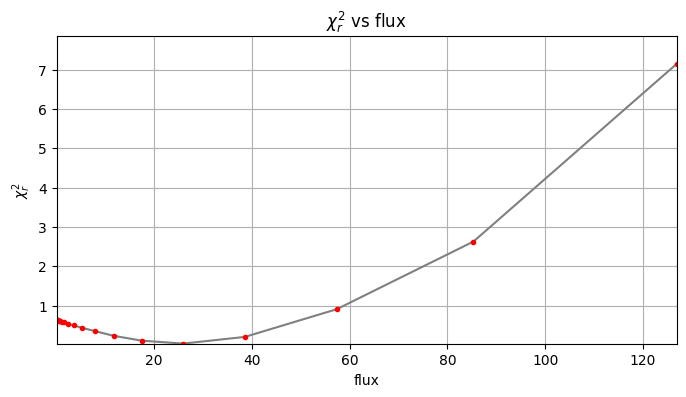

Planet 0: preliminary position guess: (r, theta)=(38.4, 323.2)
Planet 0: preliminary flux guess: 25.9
Planet 0: Simplex Nelder-Mead minimization, running ...
Planet 0: Success: True, nit: 23, nfev: 51, chi2r: 0.030991103251775107
message: Optimization terminated successfully.
Planet 0 simplex result: (r, theta, f)=(38.422, 323.182, 26.067) at 
          (X,Y)=(83.76, 29.97)

 ―――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――― 
DONE !
 ――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Running time:  0:00:08.646273
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
Starting time: 2023-09-05 06:03:41
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
        MCMC sampler for the NEGFC technique       
――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――――
The mean 

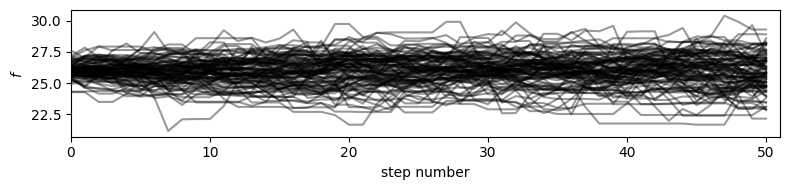

51		6.34804			2843.92282
52		5.85378			2616.63787
53		5.85568			2611.63373
54		5.85101			2603.69767
55		5.87481			2608.41564
56		5.90802			2617.25463
57		5.84018			2581.35735
58		5.85248			2580.94544
59		5.84435			2571.51532
60		5.85304			2569.48500
61		5.85342			2563.79577
62		5.86524			2563.11206
63		5.85555			2553.01980
64		5.86097			2549.52021
65		5.85273			2540.08439
66		5.91919			2563.00970
67		5.85371			2528.80229
68		5.84385			2518.69935
69		5.87853			2527.76790
70		5.86382			2515.57749
71		5.85988			2508.03035
72		5.84431			2495.52080
73		5.85584			2494.58741
74		5.85298			2487.51523
75		5.85371			2481.97474
76		5.91105			2500.37246
77		5.84569			2466.88118
78		5.84785			2461.94653
79		5.85654			2459.74638
80		5.84874			2450.62374
81		5.85667			2448.08639
82		5.85086			2439.80987
83		5.86045			2437.94637
84		5.86373			2433.44670
85		5.85193			2422.69861
86		5.91988			2444.91168
87		5.85180			2410.94160
88		5.85871			2407.92940
89		5.86321			2403.91774
90		5.88821			2408.27994


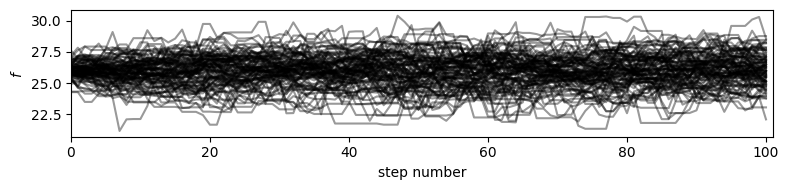

101		5.98150			2380.63740
102		5.85130			2322.96451
103		5.84851			2316.01115
104		5.83919			2306.48084
105		5.85454			2306.68758
106		5.86227			2303.87172
107		5.90126			2313.29549
108		5.85789			2290.43538
109		5.85141			2282.05107
110		5.88793			2290.40555
111		5.85793			2272.87723
112		5.85824			2267.13811
113		5.84762			2257.17978
114		5.84832			2251.60243
115		5.84317			2243.77843
116		5.84266			2237.73955
117		5.91358			2258.98680
118		5.85237			2229.75297
119		5.85297			2224.12708
120		5.85797			2220.17101
121		5.84287			2208.60448
122		5.85517			2207.39796
123		5.84567			2197.97342
124		5.86089			2197.83488
125		5.84742			2186.93583
126		5.84586			2180.50765
127		5.90751			2197.59372
128		5.85176			2171.00370
129		5.84997			2164.48779
130		5.85300			2159.75884
131		5.88664			2166.28168
132		5.85086			2147.26452
133		5.84871			2140.62640
134		5.84938			2135.02187
135		5.85581			2131.51593
136		5.85731			2126.20498
137		5.90434			2137.37108
138		5.85881			2115.02969
139		5.85793

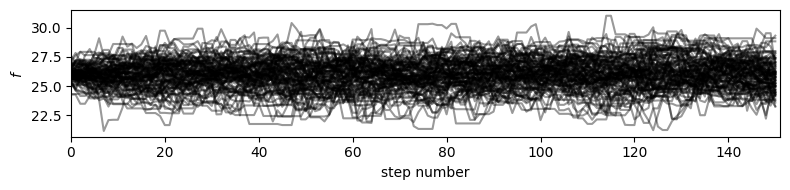

151		6.01915			2094.66420
152		5.86423			2034.88712
153		5.86045			2027.71743
154		5.85554			2020.16026
155		5.85674			2014.71822
156		5.84689			2005.48190
157		5.86207			2004.82828
158		5.91082			2015.59030
159		5.84612			1987.67910
160		5.85313			1984.20971
161		5.84817			1976.68180
162		5.86154			1975.33797
163		5.85569			1967.51218
164		5.85459			1961.28698
165		5.85314			1954.94843
166		5.86477			1952.96774
167		5.84808			1941.56289
168		5.90305			1953.90955
169		5.84752			1929.68193
170		5.84045			1921.50904
171		5.86146			1922.55724
172		5.88638			1924.84757
173		5.85487			1908.68925
174		5.85596			1903.18635
175		5.85309			1896.40213
176		5.85175			1890.11622
177		5.84842			1883.19092
178		5.92329			1901.37577
179		5.84827			1871.44576
180		5.85290			1867.07382
181		5.85417			1861.62638
182		5.84506			1852.88307
183		5.86296			1852.69694
184		5.84776			1842.04440
185		5.85160			1837.40240
186		5.85745			1833.38029
187		5.85537			1826.87669
188		5.88540			1830.36033
189		5.87857

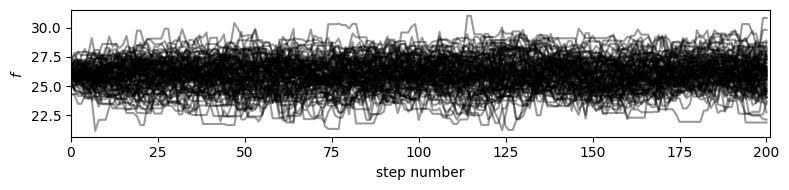

Auto-corr tau/N = [0.05343329]
tau/N <= 0.02 = [False] 

201		6.00521			1789.55109
202		5.85647			1739.37248
203		5.85098			1731.88860
204		5.86027			1728.78083
205		5.84286			1717.80202
206		5.85477			1715.44878
207		5.85265			1708.97468
208		5.85655			1704.25634
209		5.89805			1710.43334
210		5.85618			1692.43746
211		5.85054			1684.95552
212		5.85308			1679.83453
213		5.87759			1680.99074
214		5.85330			1668.19050
215		5.84830			1660.91805
216		5.84521			1654.19443
217		5.84028			1646.96037
218		5.85322			1644.75482
219		5.91806			1657.05764
220		5.85234			1632.80174
221		5.89119			1637.74943
222		5.84943			1620.29073
223		5.85415			1615.74512
224		5.84392			1607.07910
225		5.84350			1601.11845
226		5.86041			1599.89220
227		5.84361			1589.46110
228		5.85041			1585.46247
229		5.89772			1592.38359
230		5.85727			1575.60455
231		5.85044			1567.91685
232		5.83709			1558.50356
233		5.86181			1559.24252
234		5.86491			1554.20009
235		5.84846			1543.99238
236		5.84505			1537.24710
237		5.

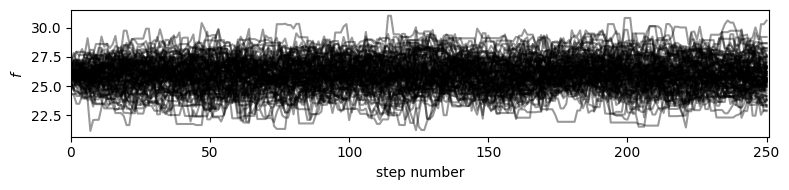

Auto-corr tau/N = [0.05275323]
tau/N <= 0.02 = [False] 

251		6.01917			1492.75416
252		5.84733			1444.29051
253		5.86396			1442.53342
254		5.87269			1438.80905
255		5.86228			1430.39608
256		5.84786			1421.02998
257		5.85777			1417.58082
258		5.84035			1407.52411
259		5.85593			1405.42224
260		5.92064			1415.03344
261		5.84199			1390.39291
262		5.84213			1384.58599
263		5.84077			1378.42054
264		5.84793			1374.26284
265		5.84640			1368.05877
266		5.84792			1362.56489
267		5.85376			1358.07209
268		5.84401			1349.96539
269		5.85246			1346.06557
270		5.89158			1349.17228
271		5.84682			1333.07519
272		5.85143			1328.27393
273		5.84065			1319.98600
274		5.88550			1324.23727
275		5.85916			1312.45296
276		5.84992			1304.53127
277		5.85346			1299.46901
278		5.85471			1293.89179
279		5.84600			1286.12022
280		5.85342			1281.89832
281		5.91331			1289.10267
282		5.83985			1267.24680
283		5.84637			1262.81506
284		5.85094			1257.95189
285		5.84986			1251.87068
286		5.84876			1245.78609
287		5.

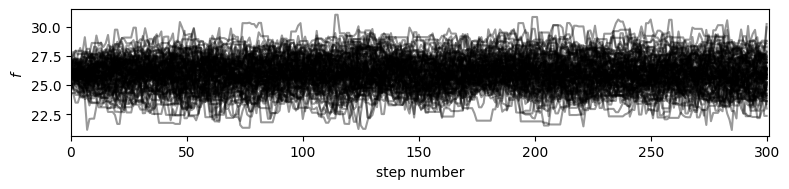

Auto-corr tau/N = [0.04955244]
tau/N <= 0.02 = [False] 

301		6.08929			1205.68021
302		5.84612			1151.68564
303		5.85243			1147.07648
304		5.84801			1140.36117
305		5.84183			1133.31502
306		5.84605			1128.28746
307		5.84703			1122.62976
308		5.84655			1116.69143
309		5.84671			1110.87528
310		5.84956			1105.56703
311		5.89658			1108.55760
312		5.86728			1097.18136
313		5.84307			1086.81083
314		5.84853			1081.97787
315		5.88568			1082.96494
316		5.85192			1070.90191
317		5.85183			1065.03288
318		5.84526			1057.99224
319		5.85181			1053.32508
320		5.85592			1048.20950
321		5.84982			1041.26760
322		5.90118			1044.50904
323		5.84393			1028.53186
324		5.85053			1023.84188
325		5.83702			1015.64200
326		5.84291			1010.82291
327		5.85155			1006.46694
328		5.84758			999.93669
329		5.85037			994.56290
330		5.84660			988.07489
331		5.85329			983.35289
332		5.89973			985.25474
333		5.85201			971.43283
334		5.83670			963.05534
335		5.87442			963.40422
336		5.84563			952.83704
337		5.84507			9

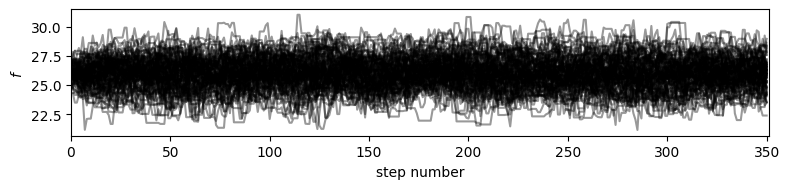

Auto-corr tau/N = [0.046882]
tau/N <= 0.02 = [False] 

351		6.02033			891.00928
352		5.90879			868.59154
353		5.85003			854.10438
354		5.85023			848.28350
355		5.84361			841.47970
356		5.88409			841.42501
357		5.86529			832.87061
358		5.85431			825.45729
359		5.85682			819.95494
360		5.84448			812.38272
361		5.84981			807.27406
362		5.87471			804.83500
363		5.90222			802.70206
364		5.85241			790.07589
365		5.85259			784.24679
366		5.85201			778.31733
367		5.85126			772.36619
368		5.85222			766.64082
369		5.85456			761.09280
370		5.85736			755.59918
371		5.84854			748.61286
372		5.85107			743.08589
373		5.90404			743.90954
374		5.85450			731.81187
375		5.85643			726.19769
376		5.87767			722.95316
377		5.86274			715.25428
378		5.86219			709.32560
379		6.03026			723.63108
380		5.85985			697.32167
381		5.85678			691.10016
382		5.84237			683.55752
383		5.92112			686.84969
384		5.83760			671.32354
385		5.84169			665.95300
386		5.85214			661.29182
387		5.84940			655.13302
388		5.84871			649.2

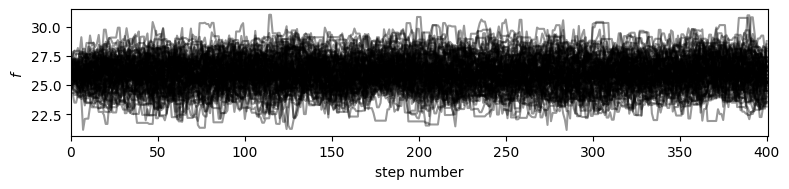

Auto-corr tau/N = [0.04438609]
tau/N <= 0.02 = [False] 

401		6.01662			589.62856
402		5.85813			568.23871
403		5.86507			563.04643
404		5.86374			557.05568
405		5.84641			549.56282
406		5.84601			543.67874
407		5.84067			537.34118
408		5.84762			532.13369
409		5.84778			526.30047
410		5.85483			521.08023
411		5.84667			514.50714
412		5.85286			509.19882
413		5.84983			503.08495
414		5.92123			503.30480
415		5.84870			491.29105
416		5.85097			485.63084
417		5.87658			481.87956
418		5.84952			473.81120
419		5.85909			468.72736
420		5.86012			462.94980
421		5.85269			456.50974
422		5.84397			449.98584
423		5.84598			444.29418
424		5.91019			443.26440
425		5.85072			432.95328
426		5.84516			426.69639
427		5.84186			420.61385
428		5.84623			415.08226
429		5.84420			409.09393
430		5.84020			402.97359
431		5.84661			397.56921
432		5.84104			391.34981
433		5.85720			386.57513
434		5.90861			384.05971
435		5.84601			374.14464
436		5.84954			368.52115
437		5.84460			362.36508
438		5.88270			358

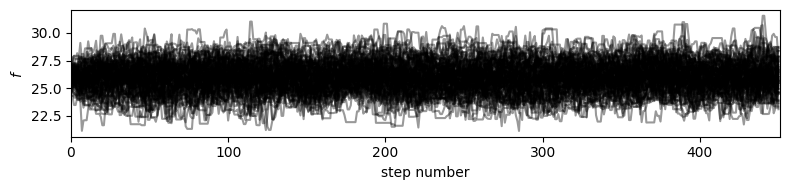

Auto-corr tau/N = [0.03975447]
tau/N <= 0.02 = [False] 

451		6.02265			289.08734
452		5.86034			275.43617
453		5.84626			268.92787
454		5.86246			263.81061
455		5.91589			260.29916
456		5.84858			251.48890
457		5.84514			245.49575
458		5.89057			241.51333
459		5.86147			234.45868
460		5.85051			228.16977
461		5.84522			222.11825
462		5.84375			216.21857
463		5.84622			210.46381
464		5.84833			204.69145
465		5.90195			200.66644
466		5.83639			192.60100
467		5.85637			187.40381
468		5.85630			181.54524
469		5.85018			175.50537
470		5.84756			169.57915
471		5.84758			163.73235
472		5.85760			158.15517
473		5.85192			152.14982
474		5.85639			146.40982
475		5.90406			141.69742
476		5.85200			134.59591
477		5.85750			128.86498
478		5.84758			122.79922
479		5.88599			117.71974
480		5.85991			111.33820
481		5.84688			105.24384
482		5.84235			99.31988
483		5.85381			93.66096
484		5.85578			87.83665
485		5.90511			82.67160
486		5.85547			76.12111
487		5.84637			70.15649
488		5.85079			64.35867


In [90]:
for i, ch in enumerate(test_ch):
    # find optimal npc
    res_ann_opt = pca_grid(cube_fc[ch], derot_angles, fwhm=fwhm[ch], range_pcs=(1,11,1), 
                           source_xy=xy_est, mode='annular',
                           annulus_width=ann_width, imlib=imlib_rot, 
                           interpolation=interpolation, 
                           full_output=True, plot=True, exclude_negative_lobes=True)
    _, final_ann_opt, _, opt_npc_ann = res_ann_opt
    plot_frames(final_ann_opt, label='PCA-ADI annulus (ch={}, opt. npc={:.0f})'.format(ch, opt_npc_ann),
                dpi=100, colorbar=True, circle=xy_est)
    # first guess
    trans_i = np.array([trans[0],trans[ch]])
    r_0, theta_0, f_0 = firstguess(cube_fc[ch], derot_angles, psfn[ch], ncomp=opt_npc_ann,
                                   planets_xy_coord=[xy_est], fwhm=fwhm[ch], weights=X_fac,
                                   f_range=None, annulus_width=ann_width, aperture_radius=aperture_radius,
                                   imlib=imlib_rot, interpolation=interpolation, simplex=True, force_rPA=True,
                                   transmission=trans_i, plot=True, verbose=True)
    initial_state = np.array([r_0[0], theta_0[0], f_0[0]])
    # MCMC
    obs_params['psfn']= psfn[ch]
    obs_params['fwhm']= fwhm[ch]
    obs_params['transmission']= trans_i
    algo_params['ncomp'] = opt_npc_ann
    chain = mcmc_negfc_sampling(cube_fc[ch], derot_angles, **obs_params, **algo_params, **negfc_params, 
                                initial_state=initial_state, **mcmc_params, **conv_params, weights=X_fac,
                                force_rPA=True, display=True, verbosity=2, save=False, output_dir='./')
    output = {'chain':chain}
    with open('../datasets/MCMC_results_pl{}_ch{}'.format(lab, ch), 'wb') as fileSave:
        pickle.dump(output, fileSave)           

In [91]:
chain = []
for i, ch in enumerate(test_ch):

    with open('../datasets/MCMC_results_pl{}_ch{}'.format(lab, ch), 'rb') as fi:
        myPickler = pickle.Unpickler(fi)
        mcmc_result = myPickler.load()

    chain.append(mcmc_result['chain'])

Let's visualize the chain after setting labels for each parameter:

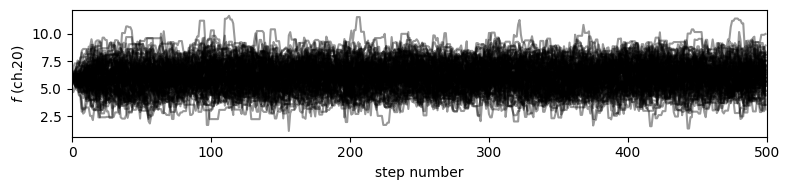

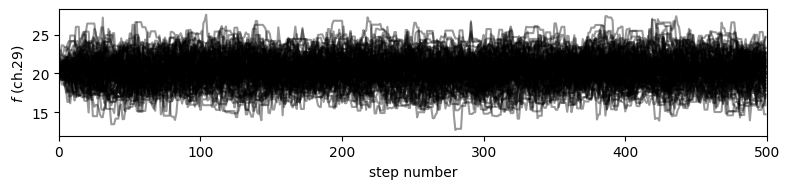

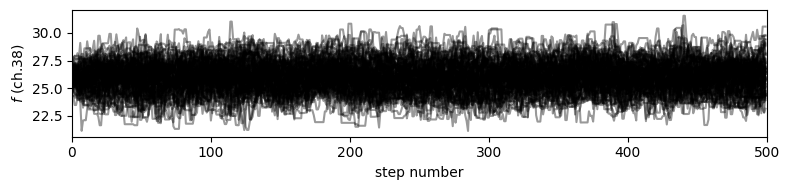

In [92]:
for i, ch in enumerate(test_ch):
    labels = [r"$f$ (ch.{:.0f})".format(ch)]
    show_walk_plot(chain[i], labels=labels)

Let's visualize the corner plot after burning the first 30% of the chain:

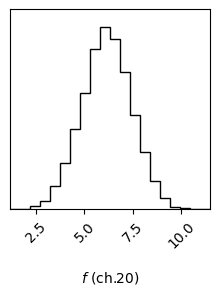

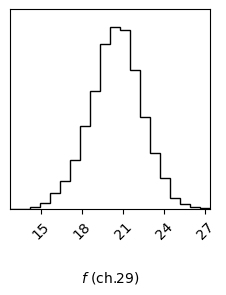

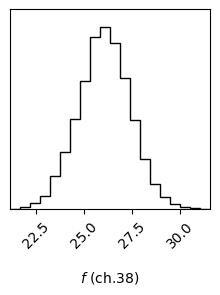

In [93]:
burnin = 0.3
for i, ch in enumerate(test_ch):
    labels = [r"$f$ (ch.{:.0f})".format(ch)]
    show_corner_plot(chain[i], burnin=burnin, labels=labels)

To calculate 1-sigma (68%) confidence intervals on each parameter, let's first flatten the chain:

In [94]:
npar = 1

In [95]:
isamples_flat = chain[0][:, int(chain[0].shape[1]//(1/burnin)):, :].reshape((-1,npar))
for i in range(1,len(test_ch)):
    isamples_flat = np.hstack((isamples_flat, 
                               chain[i][:, int(chain[i].shape[1]//(1/burnin)):, :].reshape((-1,npar))))

Then use the `confidence` function. 

Below, the first set of plots show the estimate, ground truth value and 68% confidence interval (in shaded area).

By setting 'gaussian_fit' to True, a second set of plots is also shown, where a Gaussian function is fit to each posterior distribution in order to infer mean and standard deviation for each parameter.

Note that the function can accept a ground truth value `gt`, which will be shown in the plots if provided.

/Users/valentin/GitHub/VIP/vip_hci/fm/negfc_mcmc.py:1538: UserWarning: The figure layout has changed to tight
  plt.tight_layout(w_pad=0.1)


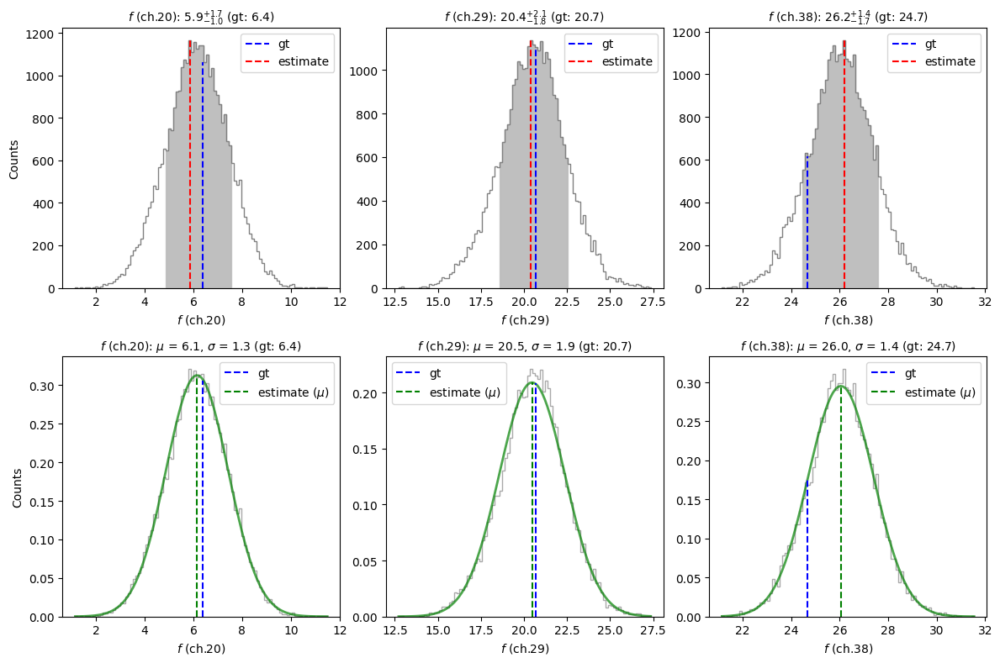

In [96]:
gt = []
labels = []
for i, ch in enumerate(test_ch):
    gt.append(flux_c_scal[ch])
    labels.append(r"$f$ (ch.{:.0f})".format(ch))

mu, sigma = confidence(isamples_flat, cfd=68, gaussian_fit=True, verbose=False, 
                       gt=gt, save=False, title=True, labels=labels)

Overall we see that the estimated fluxes are consistent with the ground truth values (shown with dashed blue lines).